In [1]:
# Import libraries
import pandas as pd
import numpy as np
import duckdb
import os
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import matplotlib.colors as mcolors
from matplotlib.gridspec import GridSpec

# tueplots for publication-quality figures
from tueplots import bundles
from tueplots.constants.color import rgb  # Uni Tübingen color palette

# Define Tübingen colors for easy access
TUE_COLORS = {
    'blue': rgb.tue_blue,
    'red': rgb.tue_red,
    'gold': rgb.tue_gold,
    'dark': rgb.tue_dark,
    'gray': rgb.tue_gray,
}

# Field colors using Tübingen palette
FIELD_COLORS = {
    'AI': rgb.tue_red,
    'Physics': rgb.tue_blue,
    'Psychology': rgb.tue_gold,
    'Other': rgb.tue_gray
}

# Set global tueplots style for ICML 2024
plt.rcParams.update(bundles.icml2024(column="full", nrows=1, ncols=2))

In [ ]:
# Configuration
DB_DIR = 'data' # Directory where DuckDB databases are stored
NOVELTY_COL = 'novelty_mean'
CITATION_COL = 'citation_count'
INFLUENTIAL_COL = 'influential_citation_count'
PERCENTILE_CITATION_COL = 'percentile_rank_citation'
PERCENTILE_INFLUENTIAL_COL = 'percentile_rank_influential'

In [ ]:
def load_databases():
    """Load data from DuckDB databases and merge into a single dataframe."""
    # Connect to databases
    metrics = duckdb.connect(f'{DB_DIR}/metrics_with_neighbours_distance_final.db')
    citations = duckdb.connect(f'{DB_DIR}/s2_papers_normalized.db')
    papers_1 = duckdb.connect(f'{DB_DIR}/S2_papers_cleaned_hf.db')
    papers_2 = duckdb.connect(f'{DB_DIR}/S2_papers_cleaned_additional_papers_hf.db')
    
    # Load dataframes
    citations_df = citations.execute("SELECT * FROM papers_normalized").df()
    metrics_df = metrics.execute("SELECT * FROM paper_neighbors_metrics").df()
    papers_1_df = papers_1.execute(
        "SELECT corpusid, title, is_physics, is_ai, is_psych, primary_topic FROM papers_with_abstracts"
    ).df()
    papers_2_df = papers_2.execute(
        "SELECT corpusid, title, is_physics, is_ai, is_psych, primary_topic FROM papers_with_abstracts"
    ).df()
    
    # Combine papers
    papers_df = pd.concat([papers_1_df, papers_2_df], ignore_index=True)
    
    # Type conversions
    citations_df['corpusid'] = citations_df['corpusid'].astype(int)
    metrics_df['corpus_id'] = metrics_df['corpus_id'].astype(int)
    papers_df['corpusid'] = papers_df['corpusid'].astype(int)
    
    # Merge all datasets
    merged_df = citations_df.merge(
        metrics_df, 
        left_on='corpusid', 
        right_on='corpus_id', 
        how='inner'
    ).merge(
        papers_df,
        on='corpusid',
        how='left'
    )
    
    return merged_df

merged_df = load_databases()
print(f"Total papers: {len(merged_df):,}")
print(f"Physics: {merged_df['is_physics'].sum():,}")
print(f"AI: {merged_df['is_ai'].sum():,}")
print(f"Psychology: {merged_df['is_psych'].sum():,}")

Total papers: 2,516,624
Physics: 955,982
AI: 725,942
Psychology: 877,871


In [4]:
NOVELTY_COL

'novelty_mean'

In [5]:
merged_df[NOVELTY_COL].describe()

count    2.516624e+06
mean     7.526175e-02
std      1.516978e-02
min      3.681779e-04
25%      6.546372e-02
50%      7.469714e-02
75%      8.439070e-02
max      2.126396e-01
Name: novelty_mean, dtype: float64

In [6]:
merged_df
# keep only papers between 2005 and 2023
merged_df = merged_df[
    (merged_df['publication_year'] >= 2005) & 
    (merged_df['publication_year'] <= 2023)
].copy()
print(f"Total papers: {len(merged_df):,}")
print(f"Physics: {merged_df['is_physics'].sum():,}")
print(f"AI: {merged_df['is_ai'].sum():,}")
print(f"Psychology: {merged_df['is_psych'].sum():,}")

Total papers: 2,124,049
Physics: 804,726
AI: 586,840
Psychology: 768,226


In [7]:
merged_df.columns

Index(['corpusid', 'citation_count', 'influential_citation_count',
       'citation_count_per_year', 'influential_count_per_year',
       'publication_year', 'percentile_rank_per_year_citation',
       'percentile_rank_per_year_influential', 'percentile_rank_citation',
       'percentile_rank_influential', 'corpus_id', 'novelty_mean',
       'novelty_weighted_citation1', 'novelty_weighted_citation2',
       'novelty_weighted_citation3', 'novelty_weighted_citation4',
       'novelty_weighted_citation5', 'novelty_max', 'novelty_min',
       'novelty_median', 'novelty_harmonic', 'title', 'is_physics', 'is_ai',
       'is_psych', 'primary_topic'],
      dtype='object')

In [8]:
# drop rows with 0 citation
merged_df = merged_df[merged_df['citation_count'] > 0].copy()
print(f"Total papers: {len(merged_df):,}")
print(f"Physics: {merged_df['is_physics'].sum():,}")
print(f"AI: {merged_df['is_ai'].sum():,}")
print(f"Psychology: {merged_df['is_psych'].sum():,}")

# normalise novelty between 0 and 1
merged_df[NOVELTY_COL] = (merged_df[NOVELTY_COL] - merged_df[NOVELTY_COL].min()) / (merged_df[NOVELTY_COL].max() - merged_df[NOVELTY_COL].min())

Total papers: 1,871,096
Physics: 717,957
AI: 505,069
Psychology: 674,204


In [9]:
# Add field column
def get_field(row):
    if row['is_ai']:
        return 'AI'
    elif row['is_physics']:
        return 'Physics'
    elif row['is_psych']:
        return 'Psychology'
    else:
        return 'Other'

merged_df['field'] = merged_df.apply(get_field, axis=1)

# Create field-specific dataframes
physics_df = merged_df[merged_df['is_physics'] == True]
ai_df = merged_df[merged_df['is_ai'] == True]
psych_df = merged_df[merged_df['is_psych'] == True]

## 2. Temporal Analysis: Has the Novelty-Impact Relationship Changed Over Time?

We first examine whether the relationship between novelty and citations has evolved over the years. Each subplot shows papers from a single year, with:
- **X-axis**: Novelty score
- **Y-axis**: Citation count (log scale)
- **r**: Pearson correlation coefficient

*Note: A weak/negative correlation suggests that highly novel papers don't necessarily receive more citations.*

In [10]:
def plot_novelty_by_year(df, metric_col, metric_name, start_year=2000, end_year=2025):
    """Plot novelty vs metric by publication year in a grid."""
    # Filter data
    year_filtered = df[
        (df['publication_year'] >= start_year) & 
        (df['publication_year'] <= end_year)
    ].copy()
    
    years = sorted(year_filtered['publication_year'].unique())
    n_years = len(years)
    n_cols = 6
    n_rows = int(np.ceil(n_years / n_cols))
    
    fig = plt.figure(figsize=(24, 20))
    gs = GridSpec(n_rows, n_cols, figure=fig, hspace=0.4, wspace=0.3)
    
    for idx, year in enumerate(years):
        row = idx // n_cols
        col = idx % n_cols
        
        year_data = year_filtered[year_filtered['publication_year'] == year]
        # sample_size = min(5000, len(year_data))
        plot_data = year_data  # year_data.sample(n=sample_size, random_state=42) if len(year_data) > sample_size else year_data
        
        # Calculate correlation
        corr = year_data[NOVELTY_COL].corr(year_data[metric_col]) if len(year_data) > 10 else np.nan
        
        ax = fig.add_subplot(gs[row, col])
        ax.scatter(plot_data[NOVELTY_COL], plot_data[metric_col],
                  c='#2E86AB', alpha=0.4, s=4, edgecolors='none', rasterized=True)
        
        ax.set_xlabel('Novelty', fontsize=9)
        # ax.set_xlim(0, 0.22)
        ax.set_ylabel(metric_name, fontsize=9)
        ax.set_title(f'{int(year)} (n={len(year_data):,}, r={corr:.2f})', 
                     fontsize=10, fontweight='bold', pad=8)
        
        if 'count' in metric_col.lower():
            ax.set_yscale('log')
        
        ax.tick_params(labelsize=8)
        ax.grid(True, alpha=0.2, linestyle=':', linewidth=0.5)
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
    
    fig.suptitle(f'Novelty vs {metric_name} by Year ({start_year}-{end_year})', 
                 fontsize=20, fontweight='bold', y=0.995)
    return fig

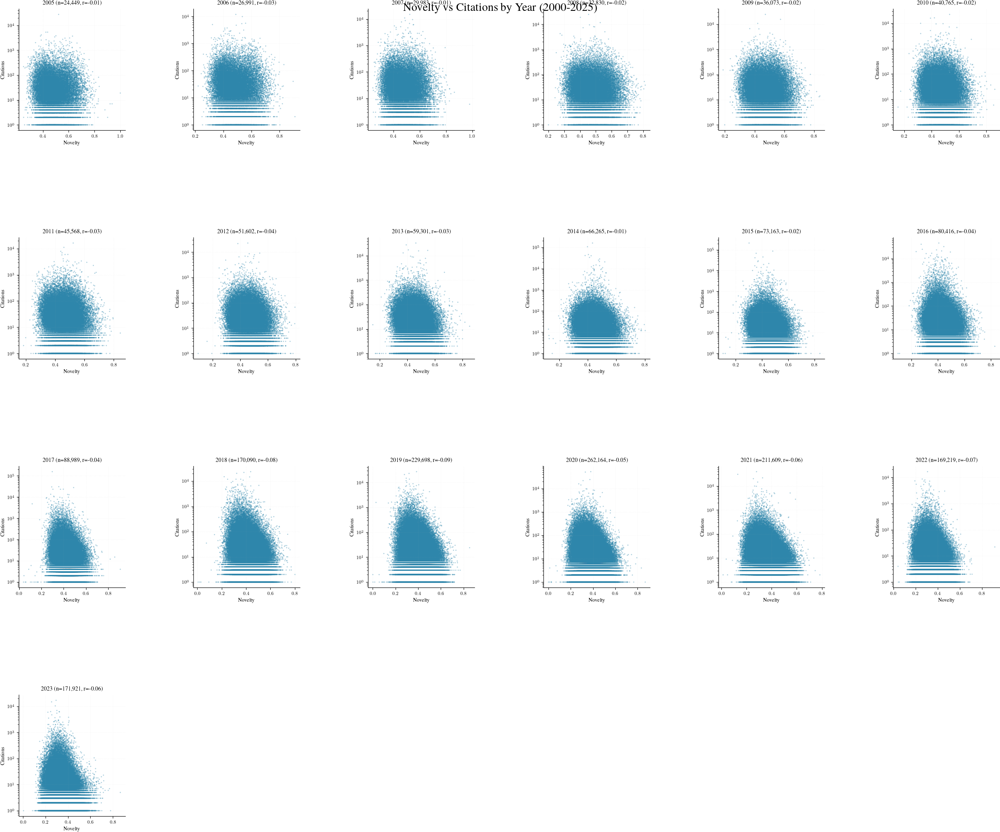

In [11]:
# Plot novelty vs citations by year
fig = plot_novelty_by_year(merged_df, CITATION_COL, 'Citations')
plt.show()

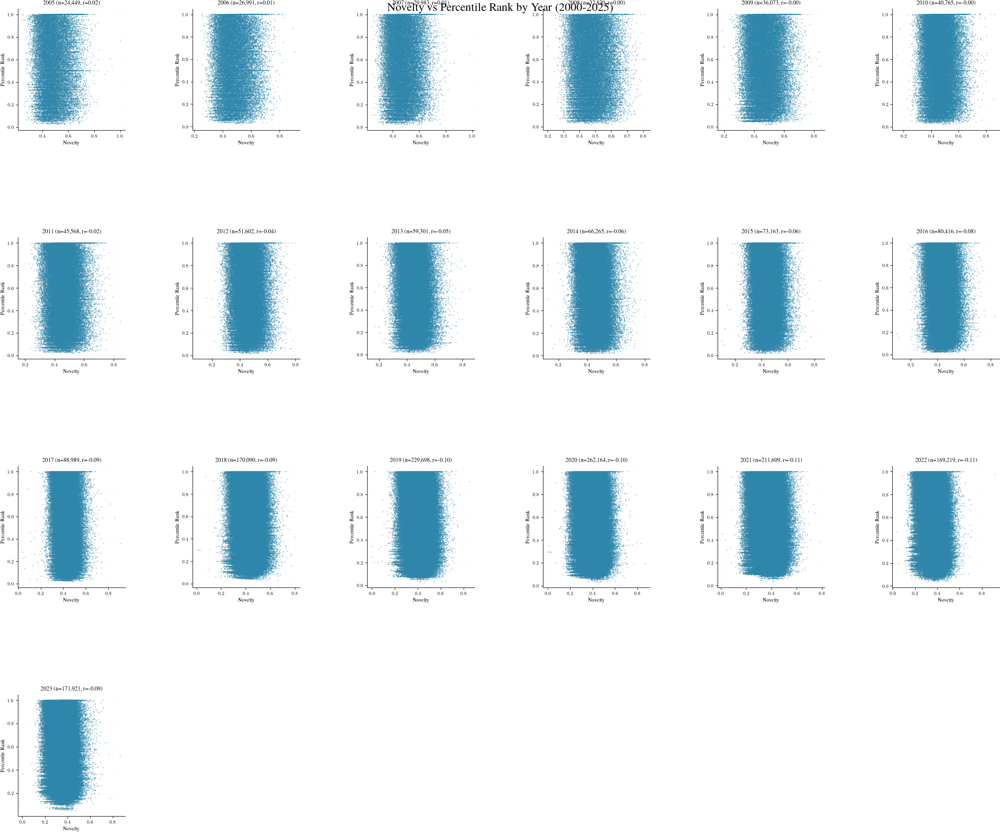

In [24]:
# Plot novelty vs percentile rank by year
fig = plot_novelty_by_year(merged_df, PERCENTILE_CITATION_COL, 'Percentile Rank')
plt.show()

## 3. Field-Level Analysis: Do Different Disciplines Reward Novelty Differently?

Different research communities may have varying attitudes toward novel work. Some fields might embrace groundbreaking ideas quickly, while others may be more conservative and cite incremental work more heavily.

We compare the novelty-citation relationship across **AI**, **Physics**, and **Psychology**.

In [25]:
def plot_novelty_by_field(df, metric_col, metric_name, start_year=2000, end_year=2025):
    """Plot novelty vs metric for each field."""
    year_filtered = df[
        (df['publication_year'] >= start_year) & 
        (df['publication_year'] <= end_year)
    ].copy()
    
    fields = ['Physics', 'AI', 'Psychology']
    colors = {'Physics': '#2E86AB', 'AI': '#A23B72', 'Psychology': '#F18F01'}
    
    fig, axes = plt.subplots(1, 3, figsize=(20, 6))
    
    for idx, field in enumerate(fields):
        field_data = year_filtered[year_filtered['field'] == field]
        # sample_size = min(5000, len(field_data))
        plot_data = field_data
        
        corr = field_data[NOVELTY_COL].corr(field_data[metric_col]) if len(field_data) > 10 else np.nan
        
        ax = axes[idx]
        ax.scatter(plot_data[NOVELTY_COL], plot_data[metric_col],
                  c=colors[field], alpha=0.7, s=2, edgecolors='none', rasterized=True)
        
        ax.set_xlabel('Novelty', fontsize=12)
        ax.set_ylabel(metric_name, fontsize=12)
        ax.set_title(f'{field} (n={len(field_data):,}, r={corr:.2f})', 
                     fontsize=14, fontweight='bold', pad=10)
        
        if 'count' in metric_col.lower():
            ax.set_yscale('log')
        
        ax.tick_params(labelsize=10)
        ax.grid(True, alpha=0.4, linestyle=':', linewidth=0.5)
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
    
    fig.suptitle(f'Novelty vs {metric_name} by Field ({start_year}-{end_year})', 
                 fontsize=18, fontweight='bold', y=1.02)
    plt.tight_layout()
    return fig

/var/folders/qn/xqf2q5g92lgd4j6z0bq50vyh0000gp/T/ipykernel_95372/971080696.py:39: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


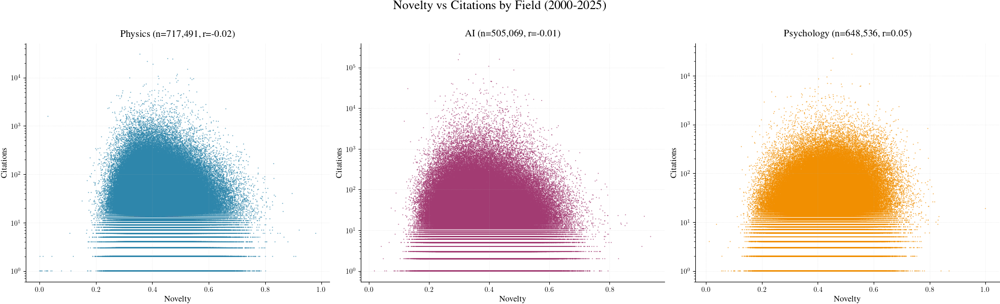

In [26]:
# Plot by field
fig = plot_novelty_by_field(merged_df, CITATION_COL, 'Citations')
plt.show()

## 4. Top Papers Analysis: Are the Most Cited Papers Also the Most Novel?

A key question: Do the **most cited papers** tend to be highly novel, or are they actually more conventional?

We compare two groups:
- **Top 1000 by Citations**: The most impactful papers by citation count
- **Top 1000 by Novelty**: The most semantically unique papers

If novelty drives impact, these groups should overlap significantly.

In [27]:
def get_top_papers_by_metric(df, metric_col, n=1000):
    """Get top N papers by a given metric for each field."""
    results = {}
    for field in ['AI', 'Physics', 'Psychology']:
        field_data = df[df['field'] == field]
        top_papers = field_data.nlargest(n, metric_col)
        results[field] = top_papers
    return results

# Get top 1000 papers by citations
top_cited = get_top_papers_by_metric(merged_df, CITATION_COL, 1000)

# Get top 1000 papers by novelty
top_novel = get_top_papers_by_metric(merged_df, NOVELTY_COL, 1000)

In [28]:
def plot_top_papers_comparison(top_cited_dict, top_novel_dict, metric_col=None):
    """Plot novelty vs citations for top papers by different criteria."""
    if metric_col is None:
        metric_col = CITATION_COL
    
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    fields = ['AI', 'Physics', 'Psychology']
    
    # Calculate global limits
    all_novelty = np.concatenate([top_cited_dict[f][NOVELTY_COL].dropna().values for f in fields])
    x_min, x_max = all_novelty.min(), all_novelty.max()
    x_padding = (x_max - x_min) * 0.05
    
    # Top cited papers
    for idx, field in enumerate(fields):
        data = top_cited_dict[field]
        ax = axes[0, idx]
        sns.scatterplot(x=NOVELTY_COL, y=metric_col, data=data, ax=ax, alpha=0.6, s=40, edgecolor='none')
        ax.set_title(f'{field} - Top Cited', fontweight='bold', pad=10)
        ax.set_ylabel('Citation Count', fontweight='bold')
        ax.set_xlabel('Novelty', fontweight='bold')
        ax.set_xlim(x_min - x_padding, x_max + x_padding)
        ax.set_yscale('log')
        ax.grid(True, alpha=0.3, linestyle='--', linewidth=0.5)
    
    # Top novel papers
    for idx, field in enumerate(fields):
        data = top_novel_dict[field]
        ax = axes[1, idx]
        sns.scatterplot(x=NOVELTY_COL, y=metric_col, data=data, ax=ax, alpha=0.6, s=40, edgecolor='none')
        ax.set_title(f'{field} - Top Novel', fontweight='bold', pad=10)
        ax.set_ylabel('Citation Count', fontweight='bold')
        ax.set_xlabel('Novelty', fontweight='bold')
        ax.set_xlim(x_min - x_padding, x_max + x_padding)
        ax.set_yscale('log')
        ax.grid(True, alpha=0.3, linestyle='--', linewidth=0.5)
    
    plt.tight_layout()
    fig.suptitle('Top 1000 Papers: Citation vs Novelty Comparison', fontsize=16, fontweight='bold', y=1.02)
    return fig

/var/folders/qn/xqf2q5g92lgd4j6z0bq50vyh0000gp/T/ipykernel_95372/1540253405.py:38: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


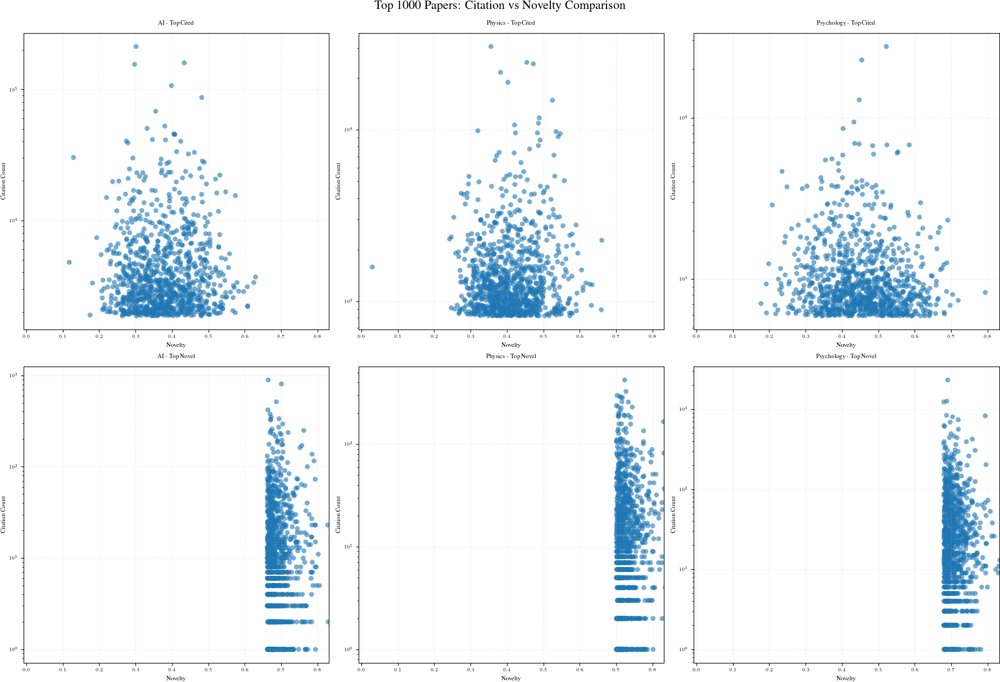

In [29]:
fig = plot_top_papers_comparison(top_cited, top_novel)
plt.show()

## 5. Binned Analysis: How Does Citation Count Vary Across Novelty Levels?

Instead of looking at raw correlations, we bin papers by novelty score and examine the **average citation count** within each bin. This reveals non-linear patterns that correlations miss.

- **Gray bars**: Number of papers in each bin (right y-axis)
- **Line**: Mean/Median citations for papers in that novelty range

In [30]:
def create_novelty_bins(df, n_bins=100):
    """Create novelty bins and calculate statistics."""
    df_clean = df[[NOVELTY_COL, CITATION_COL, 'field']].dropna().copy()
    
    # Overall bins
    df_clean['novelty_bin'] = pd.qcut(df_clean[NOVELTY_COL], q=n_bins, labels=False, duplicates='drop')
    
    # Overall statistics
    overall_stats = df_clean.groupby('novelty_bin').agg({
        CITATION_COL: ['mean', 'median', 'count'],
        NOVELTY_COL: 'mean'
    }).reset_index()
    overall_stats.columns = ['bin', 'citation_mean', 'citation_median', 'count', 'novelty_mean']
    
    # Per-field statistics
    field_stats = df_clean.groupby(['field', 'novelty_bin']).agg({
        CITATION_COL: ['mean', 'median', 'count'],
        NOVELTY_COL: 'mean'
    }).reset_index()
    field_stats.columns = ['field', 'bin', 'citation_mean', 'citation_median', 'count', 'novelty_mean']
    
    return overall_stats, field_stats

In [31]:
def plot_novelty_bins(overall_stats, field_stats):
    """Plot binned novelty analysis."""
    # Overall plot
    fig, axes = plt.subplots(2, 1, figsize=(14, 10))
    
    # Mean citations
    ax0 = axes[0]
    ax0_twin = ax0.twinx()
    ax0.plot(overall_stats['novelty_mean'], overall_stats['citation_mean'], 
             linewidth=2, color='blue', label='Mean Citations')
    ax0_twin.bar(overall_stats['novelty_mean'], overall_stats['count'], 
                alpha=0.2, color='gray', width=0.002, label='Paper Count')
    ax0.set_xlabel('Novelty (Binned)', fontsize=12)
    ax0.set_ylabel('Mean Citations', fontsize=12, color='blue')
    ax0_twin.set_ylabel('Paper Count', fontsize=12, color='gray')
    ax0.set_title('Mean Citations vs Novelty Bins', fontsize=14, fontweight='bold')
    ax0.grid(True, alpha=0.3)
    
    # Median citations
    ax1 = axes[1]
    ax1_twin = ax1.twinx()
    ax1.plot(overall_stats['novelty_mean'], overall_stats['citation_median'], 
             linewidth=2, color='green', label='Median Citations')
    ax1_twin.bar(overall_stats['novelty_mean'], overall_stats['count'], 
                alpha=0.2, color='gray', width=0.002, label='Paper Count')
    ax1.set_xlabel('Novelty (Binned)', fontsize=12)
    ax1.set_ylabel('Median Citations', fontsize=12, color='green')
    ax1_twin.set_ylabel('Paper Count', fontsize=12, color='gray')
    ax1.set_title('Median Citations vs Novelty Bins', fontsize=14, fontweight='bold')
    ax1.grid(True, alpha=0.3)
    
    plt.tight_layout()
    
    # Per-field comparison
    fig2, axes2 = plt.subplots(1, 2, figsize=(16, 6))
    fields = field_stats['field'].unique()
    colors = plt.cm.Set2(np.linspace(0, 1, len(fields)))
    
    for idx, field in enumerate(fields):
        field_data = field_stats[field_stats['field'] == field]
        axes2[0].plot(field_data['novelty_mean'], field_data['citation_mean'], 
                     linewidth=2, label=field, color=colors[idx], alpha=0.7)
        axes2[1].plot(field_data['novelty_mean'], field_data['citation_median'], 
                     linewidth=2, label=field, color=colors[idx], alpha=0.7)
    
    axes2[0].set_xlabel('Novelty (Binned)', fontsize=12)
    axes2[0].set_ylabel('Mean Citations', fontsize=12)
    axes2[0].set_title('Mean Citations by Field', fontsize=14, fontweight='bold')
    axes2[0].legend()
    axes2[0].grid(True, alpha=0.3)
    
    axes2[1].set_xlabel('Novelty (Binned)', fontsize=12)
    axes2[1].set_ylabel('Median Citations', fontsize=12)
    axes2[1].set_title('Median Citations by Field', fontsize=14, fontweight='bold')
    axes2[1].legend()
    axes2[1].grid(True, alpha=0.3)
    
    plt.tight_layout()
    return fig, fig2

/var/folders/qn/xqf2q5g92lgd4j6z0bq50vyh0000gp/T/ipykernel_95372/2288173882.py:32: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/var/folders/qn/xqf2q5g92lgd4j6z0bq50vyh0000gp/T/ipykernel_95372/2288173882.py:58: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


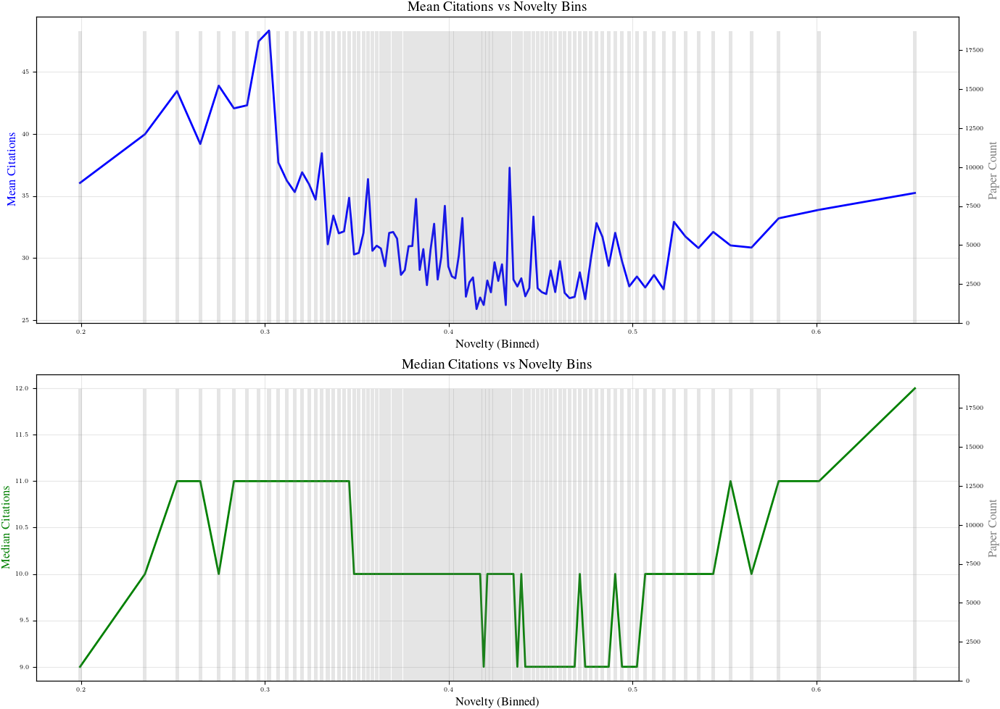

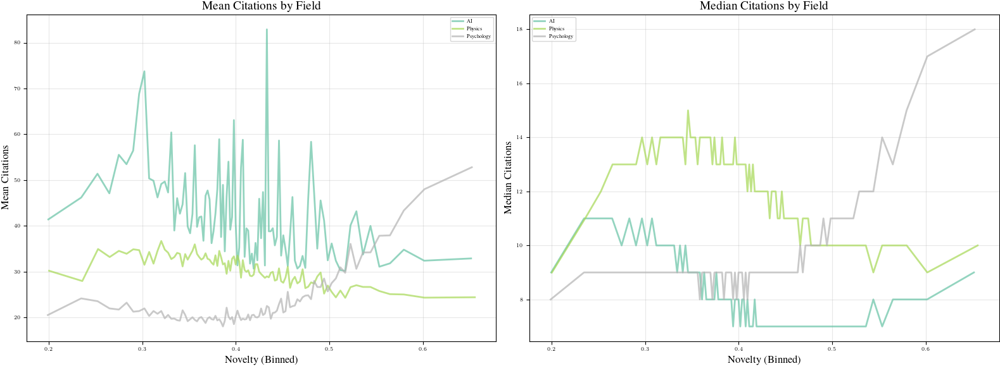

In [32]:
overall_stats, field_stats = create_novelty_bins(merged_df, n_bins=100)
fig1, fig2 = plot_novelty_bins(overall_stats, field_stats)
plt.show()

## 6. Reverse Analysis: How Does Novelty Vary Across Impact Levels?

Now we flip the question: Instead of asking "do novel papers get more citations?", we ask **"are highly-cited papers more or less novel?"**

We bin papers by various impact metrics and examine the average novelty within each bin:
- **Citation Count**: Raw citation numbers
- **Influential Citations**: Citations from other highly-cited papers
- **Percentile Ranks**: Relative standing within publication year cohort

*Shaded bands show ±1 Standard Error of the Mean (SEM), indicating confidence in the estimate.*

In [33]:
def create_metric_bins_per_field(df, metric_col, n_bins=100):
    """Create bins per field for any metric and calculate novelty statistics.
    
    Args:
        df: DataFrame with data
        metric_col: Column name to bin by (e.g., CITATION_COL, INFLUENTIAL_COL, PERCENTILE_CITATION_COL)
        n_bins: Number of bins to create
    
    Returns:
        DataFrame with binned statistics per field
    """
    df_clean = df[[NOVELTY_COL, metric_col, 'field']].dropna()
    fields = df_clean['field'].unique()
    field_stats = []
    
    for field in fields:
        field_data = df_clean[df_clean['field'] == field].copy()
        
        # Use rank-based binning to handle duplicates
        ranks = field_data[metric_col].rank(method='first')
        field_data['metric_bin'] = pd.qcut(ranks, q=n_bins, labels=False)
        
        # Calculate statistics
        field_bins = field_data.groupby('metric_bin').agg({
            NOVELTY_COL: ['mean', 'median', 'count', 'sem'],
            metric_col: 'mean'
        }).reset_index()
        field_bins.columns = ['bin', 'novelty_mean', 'novelty_median', 'count', 'novelty_sem', 'metric_avg']
        field_bins['field'] = field
        field_stats.append(field_bins)
    
    return pd.concat(field_stats, ignore_index=True)

In [34]:
def plot_metric_bins(field_stats, metric_name):
    """Plot metric bins analysis with error bars.
    
    Args:
        field_stats: DataFrame with binned statistics
        metric_name: Display name for the metric (e.g., 'Citation Count', 'Influential Citations')
    
    Returns:
        matplotlib Figure
    """
    fields = field_stats['field'].unique()
    n_fields = len(fields)
    
    fig, axes = plt.subplots(n_fields, 2, figsize=(16, 5*n_fields))
    if n_fields == 1:
        axes = axes.reshape(1, -1)
    
    for idx, field in enumerate(fields):
        field_data = field_stats[field_stats['field'] == field]
        
        # Mean novelty with error bars
        ax_left = axes[idx, 0]
        ax_left_twin = ax_left.twinx()
        ax_left.errorbar(field_data['metric_avg'], field_data['novelty_mean'], 
                        yerr=field_data['novelty_sem'], linewidth=2, color='purple', 
                        marker='o', markersize=3, capsize=2, alpha=0.8)
        width = field_data['metric_avg'].max()/200 if field_data['metric_avg'].max() > 0 else 0.1
        ax_left_twin.bar(field_data['metric_avg'], field_data['count'], 
                        alpha=0.2, color='gray', width=width)
        ax_left.set_xlabel(f'{metric_name} (Binned)', fontsize=11)
        ax_left.set_ylabel('Mean Novelty', fontsize=11, color='purple')
        ax_left_twin.set_ylabel('Paper Count', fontsize=10, color='gray')
        ax_left.set_title(f'{field} - Mean Novelty vs {metric_name}', fontsize=12, fontweight='bold')
        ax_left.grid(True, alpha=0.3)
        
        # Median novelty
        ax_right = axes[idx, 1]
        ax_right_twin = ax_right.twinx()
        ax_right.plot(field_data['metric_avg'], field_data['novelty_median'], 
                     linewidth=2, color='orange', marker='o', markersize=3)
        ax_right_twin.bar(field_data['metric_avg'], field_data['count'], 
                         alpha=0.2, color='gray', width=width)
        ax_right.set_xlabel(f'{metric_name} (Binned)', fontsize=11)
        ax_right.set_ylabel('Median Novelty', fontsize=11, color='orange')
        ax_right_twin.set_ylabel('Paper Count', fontsize=10, color='gray')
        ax_right.set_title(f'{field} - Median Novelty vs {metric_name}', fontsize=12, fontweight='bold')
        ax_right.grid(True, alpha=0.3)
    
    plt.tight_layout()
    fig.suptitle(f'Novelty vs {metric_name} by Field', fontsize=16, fontweight='bold', y=1.01)
    return fig

=== Citation Count Bins ===


/var/folders/qn/xqf2q5g92lgd4j6z0bq50vyh0000gp/T/ipykernel_95372/3825015994.py:49: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


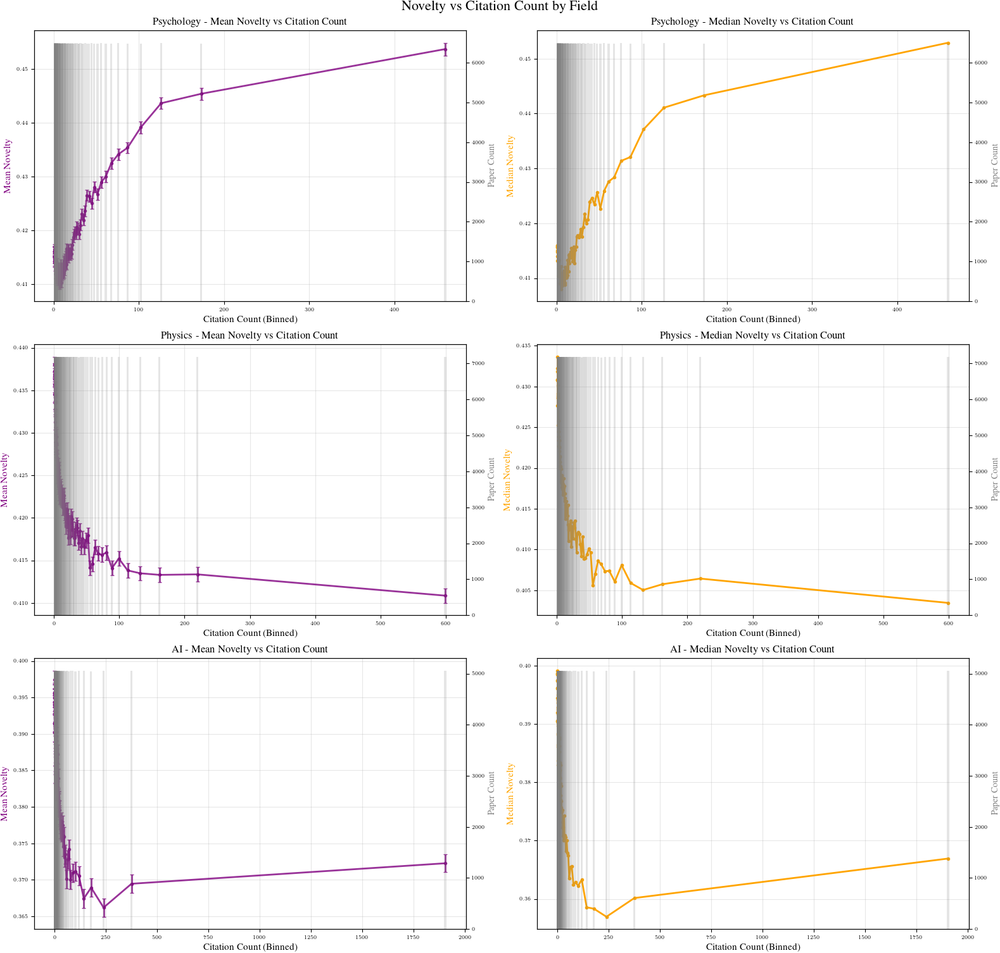

In [35]:
# Citation Count Bins
print("=== Citation Count Bins ===")
citation_stats = create_metric_bins_per_field(merged_df, CITATION_COL, n_bins=100)
fig = plot_metric_bins(citation_stats, 'Citation Count')
plt.show()

=== Influential Citation Count Bins ===


/var/folders/qn/xqf2q5g92lgd4j6z0bq50vyh0000gp/T/ipykernel_95372/3825015994.py:49: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


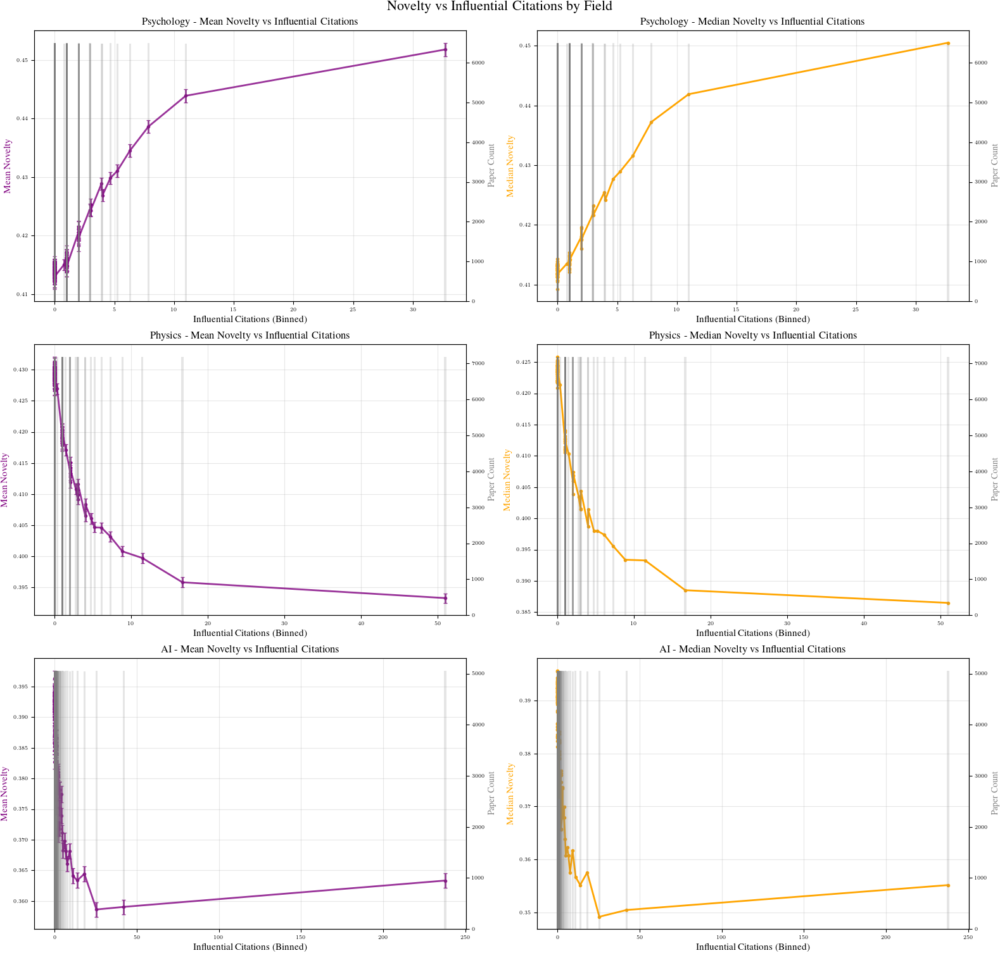

In [36]:
# Influential Citation Count Bins
print("=== Influential Citation Count Bins ===")
influential_stats = create_metric_bins_per_field(merged_df, INFLUENTIAL_COL, n_bins=100)
fig = plot_metric_bins(influential_stats, 'Influential Citations')
plt.show()

=== Citation Percentile Rank Bins ===


/var/folders/qn/xqf2q5g92lgd4j6z0bq50vyh0000gp/T/ipykernel_95372/3825015994.py:49: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


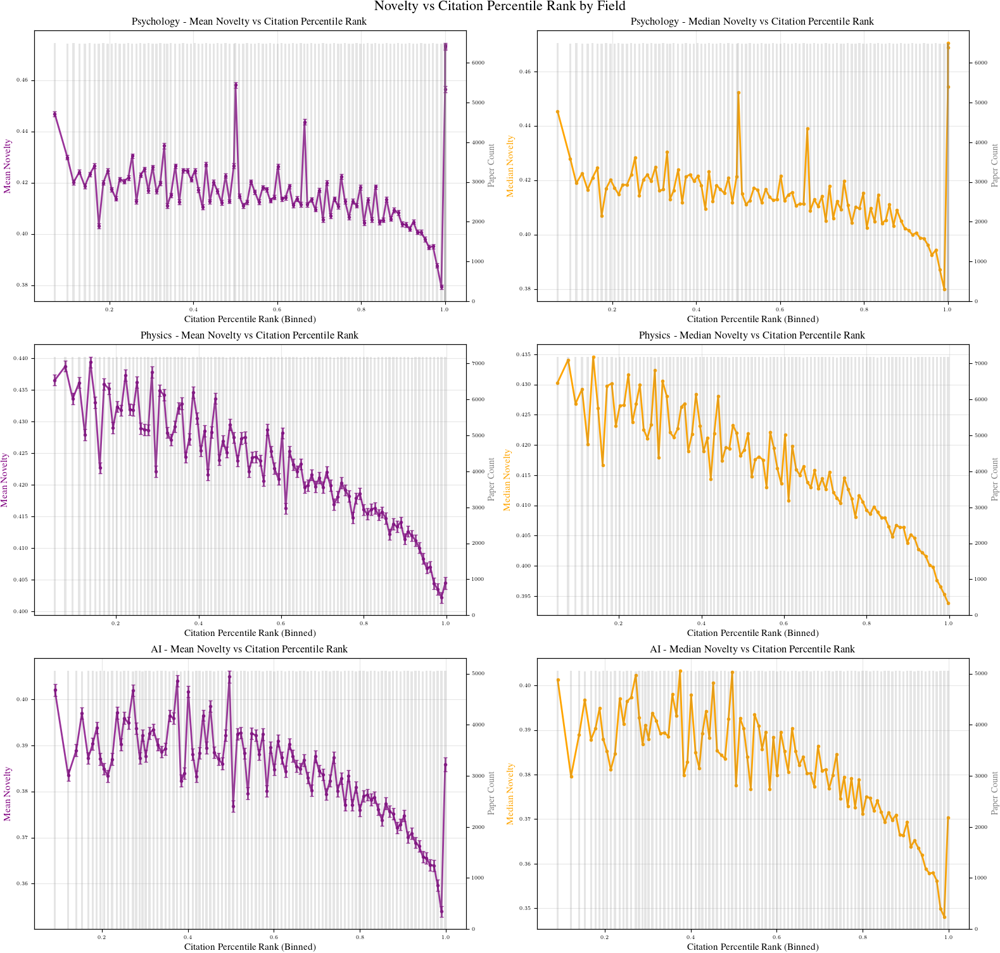

In [37]:
# Citation Percentile Rank Bins
print("=== Citation Percentile Rank Bins ===")
percentile_citation_stats = create_metric_bins_per_field(merged_df, PERCENTILE_CITATION_COL, n_bins=100)
fig = plot_metric_bins(percentile_citation_stats, 'Citation Percentile Rank')
plt.show()

=== Influential Percentile Rank Bins ===


/var/folders/qn/xqf2q5g92lgd4j6z0bq50vyh0000gp/T/ipykernel_95372/3825015994.py:49: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


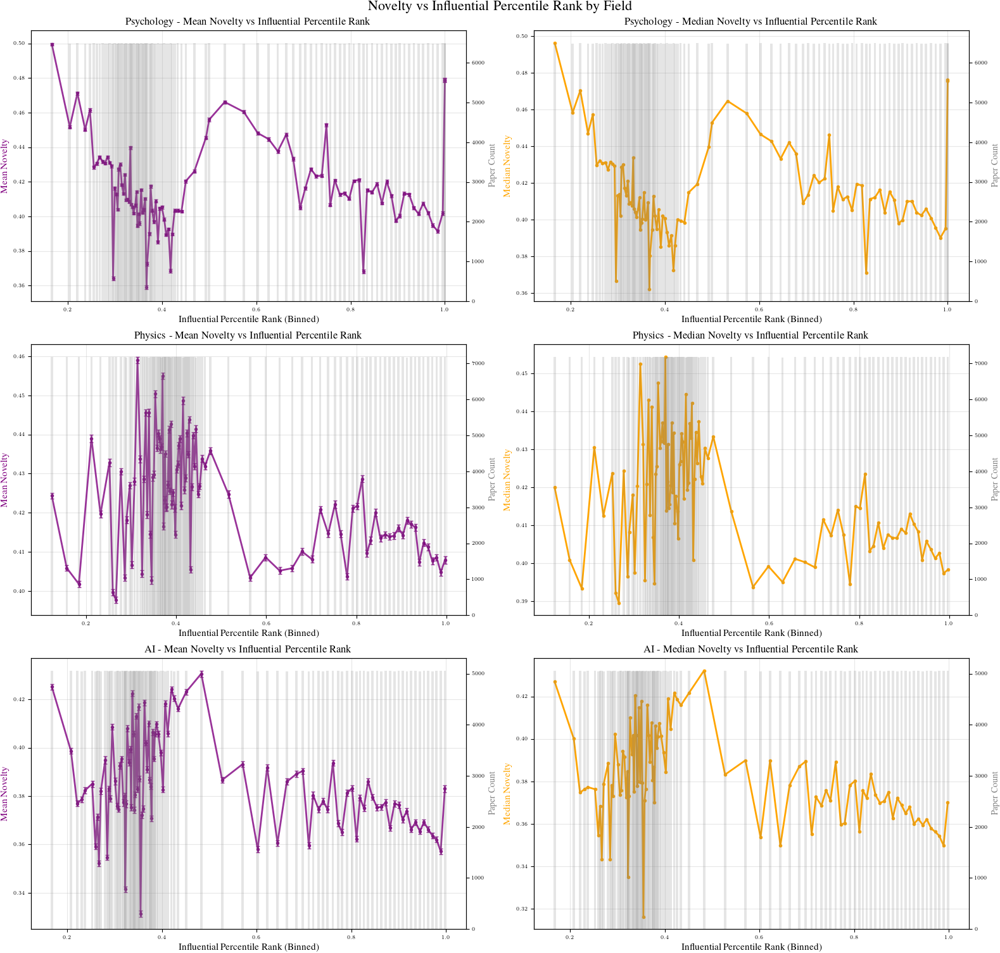

In [38]:
# Influential Percentile Rank Bins
print("=== Influential Percentile Rank Bins ===")
percentile_influential_stats = create_metric_bins_per_field(merged_df, PERCENTILE_INFLUENTIAL_COL, n_bins=100)
fig = plot_metric_bins(percentile_influential_stats, 'Influential Percentile Rank')
plt.show()

## 6b. Citation vs Novelty: Global vs Per-Field Binning

Binning strategy matters! We compare two approaches:

### Global Binning
All papers across all fields are binned together by novelty. This means bin boundaries are the same for everyone.
- **Advantage**: Direct comparison across fields at the same novelty levels
- **Reveals**: Which fields have more papers at extreme novelty levels

### Per-Field Binning
Each field is binned independently, so each field has equal representation across all bins.
- **Advantage**: Fair comparison within each field's novelty distribution
- **Reveals**: Field-specific novelty-citation patterns without sample size effects

In [39]:
def create_novelty_bins_for_citations(df, n_bins=100, binning='global'):
    """Bin by novelty and calculate citation statistics.
    
    Args:
        df: DataFrame with data
        n_bins: Number of bins to create
        binning: 'global' (bin all data together) or 'per_field' (bin each field separately)
    
    Returns:
        DataFrame with binned statistics per field
    """
    df_clean = df[[NOVELTY_COL, CITATION_COL, 'field']].dropna().copy()
    fields = df_clean['field'].unique()
    field_stats = []
    
    if binning == 'global':
        # Create global bins based on all data
        ranks = df_clean[NOVELTY_COL].rank(method='first')
        df_clean['novelty_bin'] = pd.qcut(ranks, q=n_bins, labels=False)
        
        # Then calculate stats per field within global bins
        for field in fields:
            field_data = df_clean[df_clean['field'] == field]
            field_bins = field_data.groupby('novelty_bin').agg({
                CITATION_COL: ['mean', 'median', 'count', 'sem'],
                NOVELTY_COL: 'mean'
            }).reset_index()
            field_bins.columns = ['bin', 'citation_mean', 'citation_median', 'count', 'citation_sem', 'novelty_avg']
            field_bins['field'] = field
            field_stats.append(field_bins)
    else:  # per_field
        for field in fields:
            field_data = df_clean[df_clean['field'] == field].copy()
            ranks = field_data[NOVELTY_COL].rank(method='first')
            field_data['novelty_bin'] = pd.qcut(ranks, q=n_bins, labels=False)
            
            field_bins = field_data.groupby('novelty_bin').agg({
                CITATION_COL: ['mean', 'median', 'count', 'sem'],
                NOVELTY_COL: 'mean'
            }).reset_index()
            field_bins.columns = ['bin', 'citation_mean', 'citation_median', 'count', 'citation_sem', 'novelty_avg']
            field_bins['field'] = field
            field_stats.append(field_bins)
    
    return pd.concat(field_stats, ignore_index=True)


def plot_citation_vs_novelty_bins(field_stats, title_suffix=''):
    """Plot citation vs novelty bins with paper count on secondary y-axis.
    
    Args:
        field_stats: DataFrame with binned statistics
        title_suffix: Additional text for the title (e.g., 'Global Binning')
    
    Returns:
        matplotlib Figure
    """
    fields = ['AI', 'Physics', 'Psychology']
    colors = {'AI': '#A23B72', 'Physics': '#2E86AB', 'Psychology': '#F18F01', 'Other': '#666666'}
    
    fig, axes = plt.subplots(3, 2, figsize=(14, 12))
    
    for idx, field in enumerate(fields):
        field_data = field_stats[field_stats['field'] == field].sort_values('novelty_avg')
        if len(field_data) == 0:
            continue
        color = colors.get(field, '#333333')
        
        # Mean citations (left column)
        ax_left = axes[idx, 0]
        ax_left_twin = ax_left.twinx()
        ax_left.fill_between(field_data['novelty_avg'], 
                            field_data['citation_mean'] - field_data['citation_sem'],
                            field_data['citation_mean'] + field_data['citation_sem'],
                            alpha=0.3, color=color)
        ax_left.plot(field_data['novelty_avg'], field_data['citation_mean'], 
                    linewidth=2, color=color)
        ax_left_twin.bar(field_data['novelty_avg'], field_data['count'], 
                        alpha=0.15, color='gray', width=0.003)
        
        ax_left.set_xlabel('Novelty (Binned)', fontsize=11)
        ax_left.set_ylabel('Mean Citation Count', fontsize=11, color=color)
        ax_left_twin.set_ylabel('Paper Count', fontsize=10, color='gray')
        ax_left_twin.tick_params(axis='y', labelcolor='gray')
        ax_left.set_title(f'{field} - Mean Citations {title_suffix}', fontsize=12, fontweight='bold')
        ax_left.grid(True, alpha=0.3, linestyle='--')
        # ax_left.set_yscale('log')
        
        # Median citations (right column)
        ax_right = axes[idx, 1]
        ax_right_twin = ax_right.twinx()
        ax_right.plot(field_data['novelty_avg'], field_data['citation_median'], 
                     linewidth=2, color=color)
        ax_right_twin.bar(field_data['novelty_avg'], field_data['count'], 
                         alpha=0.15, color='gray', width=0.003)
        
        ax_right.set_xlabel('Novelty (Binned)', fontsize=11)
        ax_right.set_ylabel('Median Citation Count', fontsize=11, color=color)
        ax_right_twin.set_ylabel('Paper Count', fontsize=10, color='gray')
        ax_right_twin.tick_params(axis='y', labelcolor='gray')
        ax_right.set_title(f'{field} - Median Citations {title_suffix}', fontsize=12, fontweight='bold')
        ax_right.grid(True, alpha=0.3, linestyle='--')
    
    plt.tight_layout()
    fig.suptitle(f'Citations vs Novelty {title_suffix}', fontsize=14, fontweight='bold', y=1.01)
    return fig

=== Citation vs Novelty (Global Binning) ===


/var/folders/qn/xqf2q5g92lgd4j6z0bq50vyh0000gp/T/ipykernel_95372/277725089.py:104: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


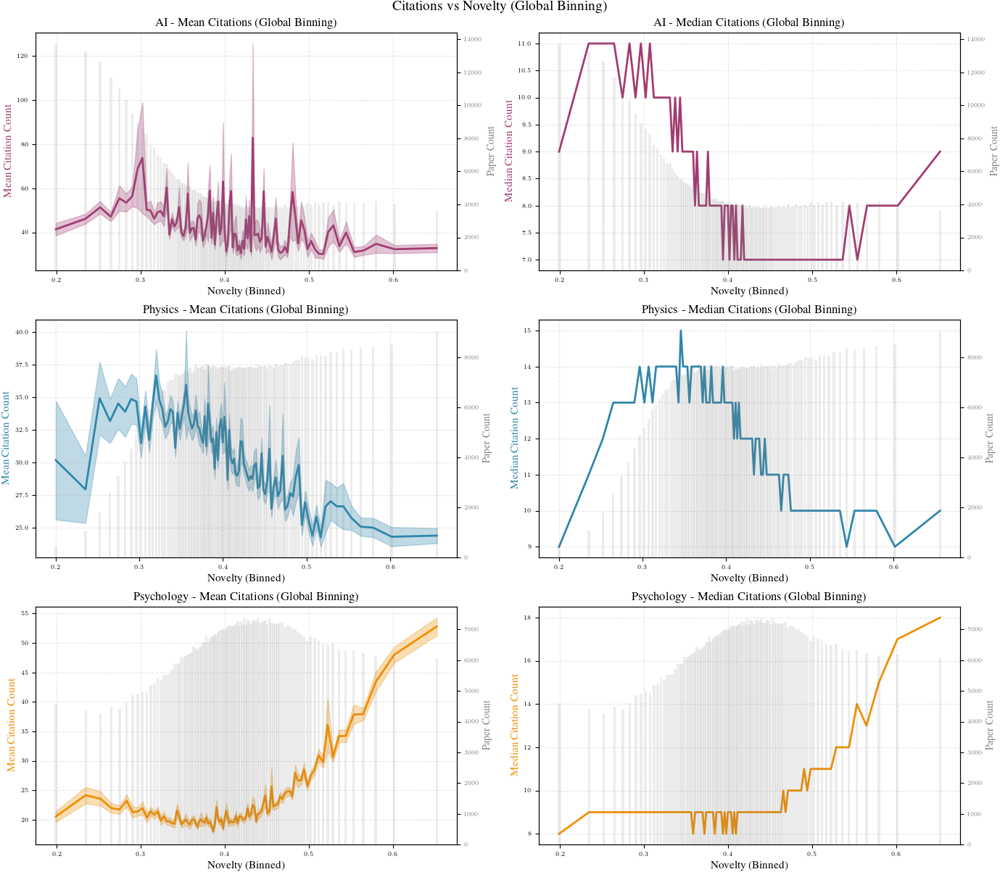

In [40]:
# Citation vs Novelty - Global Binning
print("=== Citation vs Novelty (Global Binning) ===")
citation_novelty_global = create_novelty_bins_for_citations(merged_df, n_bins=100, binning='global')
fig = plot_citation_vs_novelty_bins(citation_novelty_global, '(Global Binning)')
plt.show()

=== Citation vs Novelty (Per-Field Binning) ===


/var/folders/qn/xqf2q5g92lgd4j6z0bq50vyh0000gp/T/ipykernel_95372/277725089.py:104: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


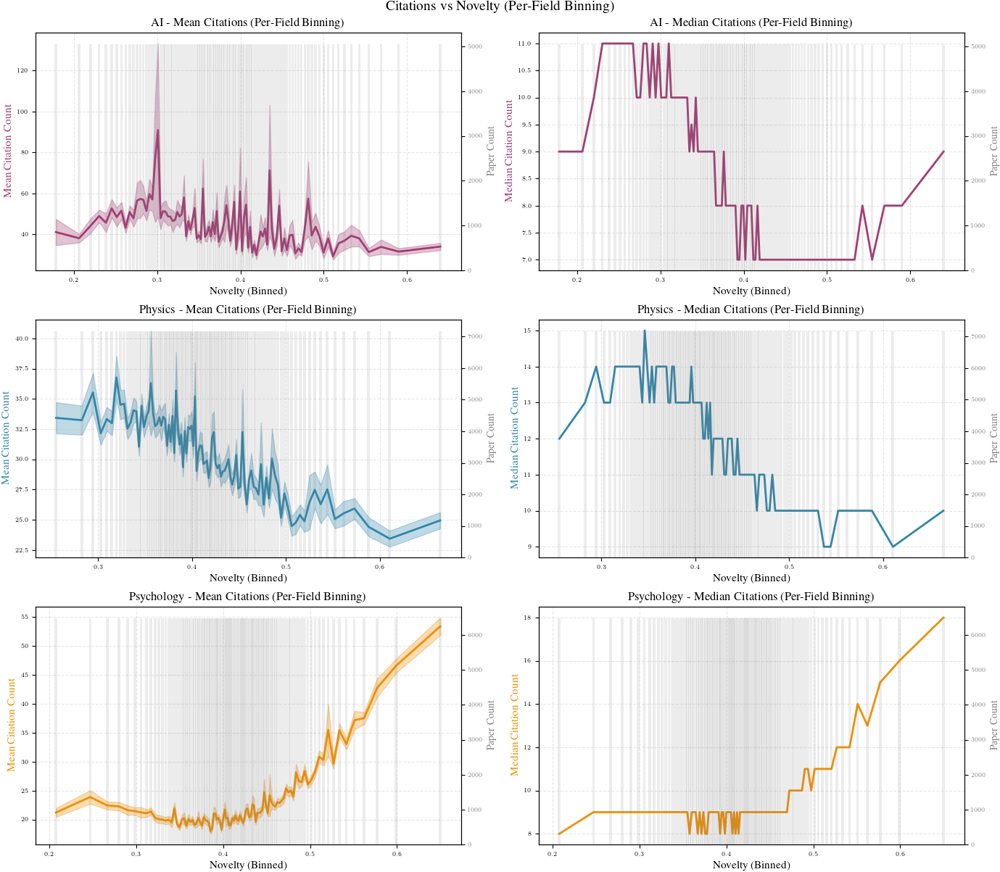

In [41]:
# Citation vs Novelty - Per-Field Binning
print("=== Citation vs Novelty (Per-Field Binning) ===")
citation_novelty_perfield = create_novelty_bins_for_citations(merged_df, n_bins=100, binning='per_field')
fig = plot_citation_vs_novelty_bins(citation_novelty_perfield, '(Per-Field Binning)')
plt.show()

=== Citation vs Novelty: Scatter with Bins & Mean (Per-Field Binning) ===


RuntimeError: Colorbar layout of new layout engine not compatible with old engine, and a colorbar has been created.  Engine not changed.

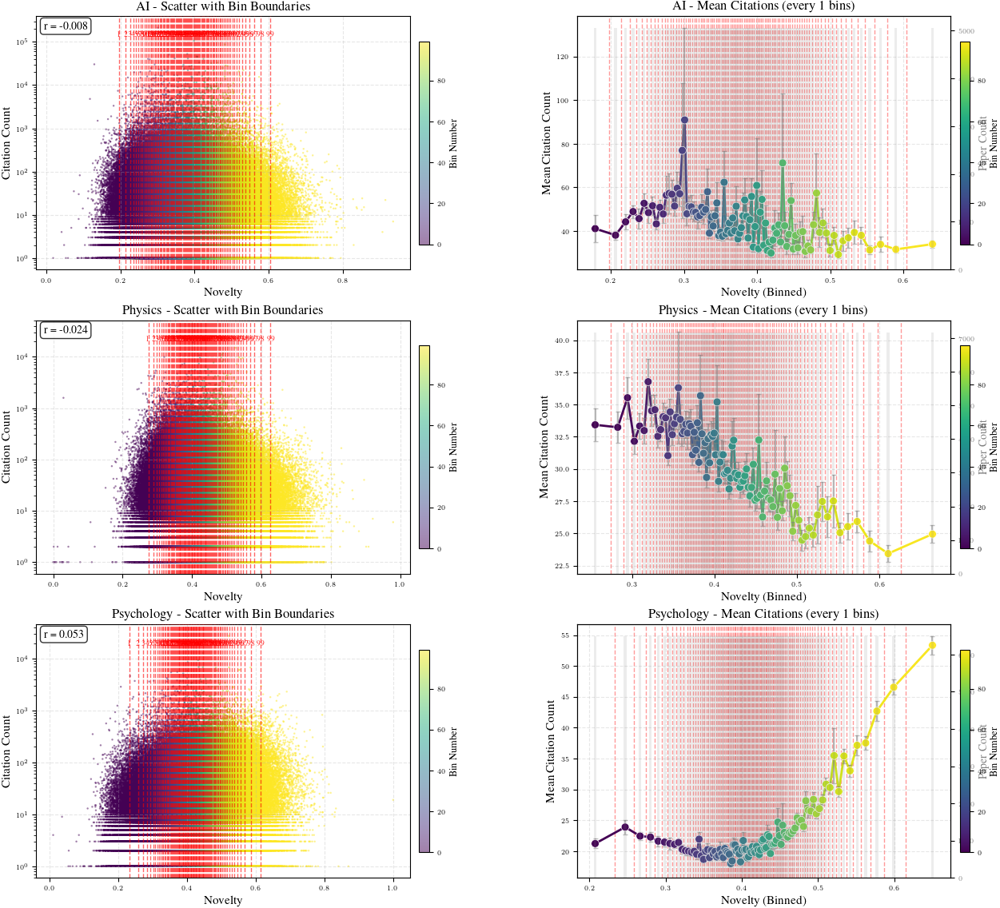

In [42]:
def plot_citation_vs_novelty_scatter_and_mean(df, field_stats, n_bins=100, binning='per_field', title_suffix='', show_every_n_bins=10):
    """Plot scatter with bin indicators (left) and mean citations (right).
    
    Left: Scatter plot with vertical lines showing bin boundaries and color-coded bins
    Right: Mean citation line plot with matching bin colors
    
    Args:
        df: Original DataFrame with individual papers
        field_stats: DataFrame with binned statistics
        n_bins: Number of bins used
        binning: 'global' or 'per_field'
        title_suffix: Additional text for the title
        show_every_n_bins: Show bin markers every N bins (for visual clarity)
    
    Returns:
        matplotlib Figure
    """
    fields = ['AI', 'Physics', 'Psychology']
    colors = {'AI': '#A23B72', 'Physics': '#2E86AB', 'Psychology': '#F18F01'}
    
    fig, axes = plt.subplots(3, 2, figsize=(16, 14))
    
    # Prepare data with bin assignments
    df_clean = df[[NOVELTY_COL, CITATION_COL, 'field']].dropna().copy()
    
    if binning == 'global':
        ranks = df_clean[NOVELTY_COL].rank(method='first')
        df_clean['novelty_bin'] = pd.qcut(ranks, q=n_bins, labels=False)
    else:
        # Assign bins per field
        df_clean['novelty_bin'] = -1
        for field in fields:
            mask = df_clean['field'] == field
            field_data_temp = df_clean[mask]
            if len(field_data_temp) > 0:
                ranks = field_data_temp[NOVELTY_COL].rank(method='first')
                df_clean.loc[mask, 'novelty_bin'] = pd.qcut(ranks, q=n_bins, labels=False)
    
    # Use viridis colormap for both plots
    cmap = plt.cm.viridis
    
    for idx, field in enumerate(fields):
        field_data_stats = field_stats[field_stats['field'] == field].sort_values('novelty_avg')
        field_data_scatter = df_clean[df_clean['field'] == field].copy()
        
        if len(field_data_stats) == 0 or len(field_data_scatter) == 0:
            continue
            
        color = colors.get(field, '#333333')
        max_bin = field_data_scatter['novelty_bin'].max()
        norm = plt.Normalize(0, max_bin)
        
        # Get bin boundaries
        bin_edges = []
        for bin_num in sorted(field_data_scatter['novelty_bin'].unique()):
            if bin_num >= 0:
                bin_data = field_data_scatter[field_data_scatter['novelty_bin'] == bin_num]
                if len(bin_data) > 0:
                    bin_edges.append({
                        'bin': bin_num,
                        'min_novelty': bin_data[NOVELTY_COL].min(),
                        'max_novelty': bin_data[NOVELTY_COL].max(),
                    })
        
        # LEFT: Scatter plot with bin coloring and boundary lines
        ax_left = axes[idx, 0]
        
        # Scatter plot with bin-based coloring
        scatter = ax_left.scatter(
            field_data_scatter[NOVELTY_COL], 
            field_data_scatter[CITATION_COL],
            c=field_data_scatter['novelty_bin'],
            cmap='viridis',
            alpha=0.5,
            s=3,
            edgecolors='none',
            rasterized=True
        )
        
        # Draw vertical lines at bin boundaries
        for i, edge in enumerate(bin_edges):
            if i % show_every_n_bins == 0 and i > 0:
                ax_left.axvline(x=edge['min_novelty'], color='red', alpha=0.6, 
                               linewidth=1, linestyle='--', zorder=5)
                y_top = ax_left.get_ylim()[1]
                ax_left.text(edge['min_novelty'], y_top * 0.8, 
                            f'{int(edge["bin"])}', fontsize=7, color='red', 
                            ha='center', va='top', alpha=0.8)
        
        # Add colorbar
        cbar = plt.colorbar(scatter, ax=ax_left, shrink=0.8, pad=0.02)
        cbar.set_label('Bin Number', fontsize=9)
        
        ax_left.set_xlabel('Novelty', fontsize=11)
        ax_left.set_ylabel('Citation Count', fontsize=11)
        ax_left.set_title(f'{field} - Scatter with Bin Boundaries', fontsize=12, fontweight='bold')
        ax_left.set_yscale('log')
        ax_left.grid(True, alpha=0.3, linestyle='--')
        
        # Correlation
        corr = field_data_scatter[NOVELTY_COL].corr(field_data_scatter[CITATION_COL])
        ax_left.text(0.02, 0.98, f'r = {corr:.3f}', transform=ax_left.transAxes, 
                    fontsize=10, va='top', ha='left', 
                    bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        # RIGHT: Mean citations - show only every Nth bin to match left
        ax_right = axes[idx, 1]
        ax_right_twin = ax_right.twinx()
        
        # Filter to show only every Nth bin
        bins_to_show = [b for b in field_data_stats['bin'].unique() if b % show_every_n_bins == 0]
        field_data_stats_filtered = field_data_stats[field_data_stats['bin'].isin(bins_to_show)].copy()
        
        novelty_vals = field_data_stats_filtered['novelty_avg'].values
        mean_vals = field_data_stats_filtered['citation_mean'].values
        sem_vals = field_data_stats_filtered['citation_sem'].values
        bin_nums = field_data_stats_filtered['bin'].values
        count_vals = field_data_stats_filtered['count'].values
        
        # Draw colored line segments connecting the shown bins
        for i in range(len(novelty_vals) - 1):
            ax_right.plot(novelty_vals[i:i+2], mean_vals[i:i+2], 
                         color=cmap(norm(bin_nums[i])), linewidth=2)
        
        # Add scatter points colored by bin
        scatter_right = ax_right.scatter(novelty_vals, mean_vals, 
                                         c=bin_nums, cmap='viridis', 
                                         s=50, zorder=5, edgecolors='white', linewidth=0.5,
                                         norm=norm)
        
        # Error bars at shown bins
        ax_right.errorbar(novelty_vals, mean_vals, yerr=sem_vals, 
                         fmt='none', ecolor='gray', alpha=0.5, capsize=2)
        
        # Paper count bars (aggregated for shown bins)
        bar_width = (novelty_vals.max() - novelty_vals.min()) / len(novelty_vals) * 0.8 if len(novelty_vals) > 1 else 0.01
        ax_right_twin.bar(novelty_vals, count_vals, alpha=0.15, color='gray', width=bar_width)
        
        # Add vertical lines matching left plot
        for i, edge in enumerate(bin_edges):
            if i % show_every_n_bins == 0 and i > 0:
                ax_right.axvline(x=edge['min_novelty'], color='red', alpha=0.4, 
                                linewidth=1, linestyle='--', zorder=1)
        
        # Add colorbar for right plot
        cbar_right = plt.colorbar(scatter_right, ax=ax_right, shrink=0.8, pad=0.02)
        cbar_right.set_label('Bin Number', fontsize=9)
        
        ax_right.set_xlabel('Novelty (Binned)', fontsize=11)
        ax_right.set_ylabel('Mean Citation Count', fontsize=11)
        ax_right_twin.set_ylabel('Paper Count', fontsize=10, color='gray')
        ax_right_twin.tick_params(axis='y', labelcolor='gray')
        ax_right.set_title(f'{field} - Mean Citations (every {show_every_n_bins} bins)', fontsize=12, fontweight='bold')
        ax_right.grid(True, alpha=0.3, linestyle='--')
    
    plt.tight_layout()
    fig.suptitle(f'Citations vs Novelty: Scatter & Binned Mean {title_suffix}', 
                fontsize=14, fontweight='bold', y=1.01)
    return fig


# Create the plot with per-field binning
print("=== Citation vs Novelty: Scatter with Bins & Mean (Per-Field Binning) ===")
fig = plot_citation_vs_novelty_scatter_and_mean(
    merged_df, 
    citation_novelty_perfield, 
    n_bins=100, 
    binning='per_field',
    title_suffix='(Per-Field Binning)',
    show_every_n_bins=1  # Show every 10th bin on both plots
)
plt.show()

=== Citation vs Novelty: Fixed-Width Bins with Dynamic Edge Cutoffs ===
Dynamic cutoffs based on 1th and 99th percentiles:
  Low cutoff: 0.222846
  High cutoff: 0.617120
  Data range: [0.000000, 1.000000]
  Bin width: 0.003943

AI: Papers in <P1: 13,710, in [P1-P99]: 487,748, in >P99: 3,611

Physics: Papers in <P1: 425, in [P1-P99]: 708,023, in >P99: 9,043

Psychology: Papers in <P1: 4,576, in [P1-P99]: 637,903, in >P99: 6,057


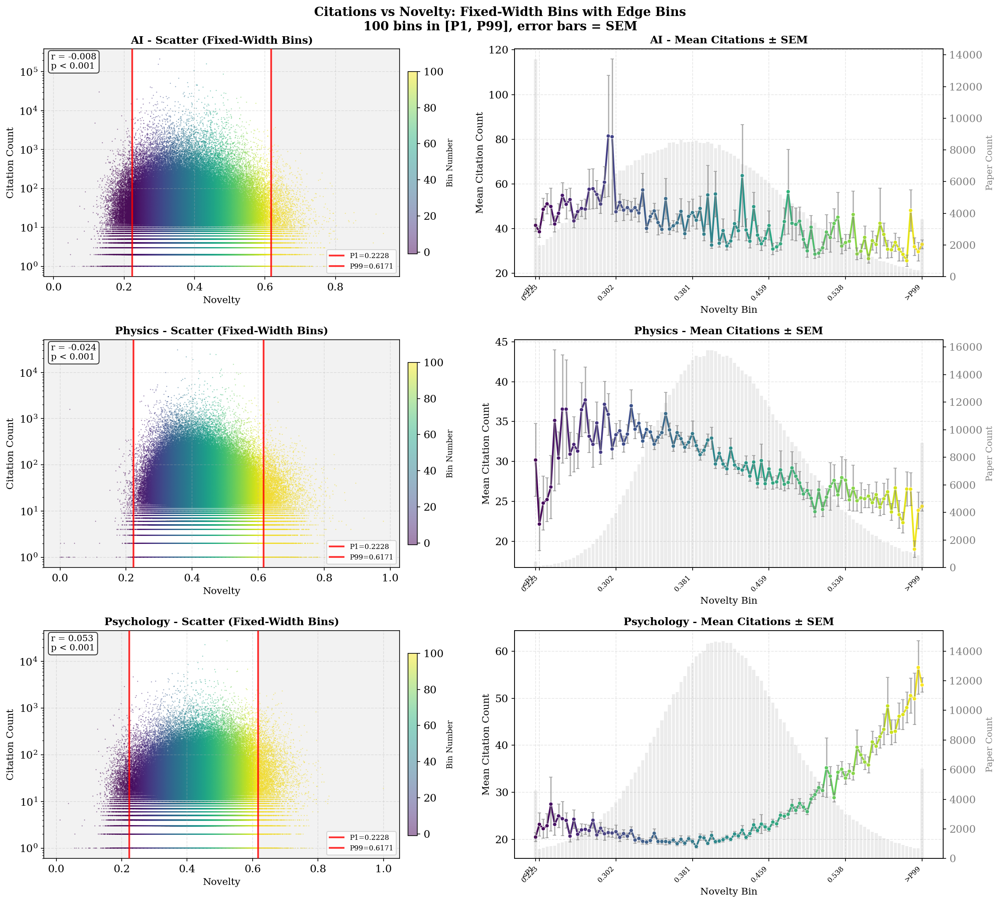

In [ ]:
# Fixed-width binning analysis with edge bins - Dynamic cutoffs
def compute_fixed_width_bins_with_edges(df, n_bins=100, low_percentile=1, high_percentile=99, per_field=True):
    """Compute citation statistics using fixed-width novelty bins with edge bins.
    
    Args:
        df: DataFrame with novelty and citation data
        n_bins: Number of equal-width bins between cutoffs
        low_percentile: Percentile for low cutoff
        high_percentile: Percentile for high cutoff
        per_field: If True, compute bins separately for each field
        
    Returns:
        DataFrame with bin statistics including mean, SEM, count
    """
    fields = ['AI', 'Physics', 'Psychology']
    df_clean = df[[NOVELTY_COL, CITATION_COL, 'field']].dropna().copy()
    
    # Calculate cutoffs dynamically from data
    low_cutoff = df_clean[NOVELTY_COL].quantile(low_percentile / 100)
    high_cutoff = df_clean[NOVELTY_COL].quantile(high_percentile / 100)
    
    print(f"Dynamic cutoffs based on {low_percentile}th and {high_percentile}th percentiles:")
    print(f"  Low cutoff: {low_cutoff:.6f}")
    print(f"  High cutoff: {high_cutoff:.6f}")
    print(f"  Data range: [{df_clean[NOVELTY_COL].min():.6f}, {df_clean[NOVELTY_COL].max():.6f}]")
    
    all_stats = []
    
    # Create bin edges: one for <low_cutoff, n_bins between low and high, one for >high_cutoff
    main_bin_edges = np.linspace(low_cutoff, high_cutoff, n_bins + 1)
    bin_width = (high_cutoff - low_cutoff) / n_bins
    print(f"  Bin width: {bin_width:.6f}")
    
    for field in fields:
        field_data = df_clean[df_clean['field'] == field].copy()
        if len(field_data) == 0:
            continue
        
        # Assign bins: -1 for low edge, 0 to n_bins-1 for main bins, n_bins for high edge
        def assign_bin(x):
            if x < low_cutoff:
                return -1  # Low edge bin
            elif x > high_cutoff:
                return n_bins  # High edge bin
            else:
                # Find which main bin
                bin_idx = np.searchsorted(main_bin_edges, x, side='right') - 1
                return max(0, min(n_bins - 1, bin_idx))
        
        field_data['novelty_bin'] = field_data[NOVELTY_COL].apply(assign_bin)
        
        # Compute stats for low edge bin
        low_edge_data = field_data[field_data['novelty_bin'] == -1]
        if len(low_edge_data) > 0:
            citations = low_edge_data[CITATION_COL]
            novelty_vals = low_edge_data[NOVELTY_COL]
            all_stats.append({
                'field': field,
                'bin': -1,
                'bin_label': f'<{low_cutoff:.3f}',
                'bin_center': df_clean[NOVELTY_COL].min() + (low_cutoff - df_clean[NOVELTY_COL].min()) / 2,
                'novelty_avg': novelty_vals.mean(),
                'citation_mean': citations.mean(),
                'citation_median': citations.median(),
                'citation_std': citations.std(),
                'citation_sem': citations.std() / np.sqrt(len(citations)) if len(citations) > 1 else 0,
                'count': len(low_edge_data)
            })
        
        # Compute stats for main bins
        for bin_num in range(n_bins):
            bin_data = field_data[field_data['novelty_bin'] == bin_num]
            if len(bin_data) > 0:
                citations = bin_data[CITATION_COL]
                novelty_vals = bin_data[NOVELTY_COL]
                bin_center = (main_bin_edges[bin_num] + main_bin_edges[bin_num + 1]) / 2
                
                all_stats.append({
                    'field': field,
                    'bin': bin_num,
                    'bin_label': f'{main_bin_edges[bin_num]:.4f}',
                    'bin_center': bin_center,
                    'novelty_avg': novelty_vals.mean(),
                    'citation_mean': citations.mean(),
                    'citation_median': citations.median(),
                    'citation_std': citations.std(),
                    'citation_sem': citations.std() / np.sqrt(len(citations)) if len(citations) > 1 else 0,
                    'count': len(bin_data)
                })
        
        # Compute stats for high edge bin
        high_edge_data = field_data[field_data['novelty_bin'] == n_bins]
        if len(high_edge_data) > 0:
            citations = high_edge_data[CITATION_COL]
            novelty_vals = high_edge_data[NOVELTY_COL]
            all_stats.append({
                'field': field,
                'bin': n_bins,
                'bin_label': f'>{high_cutoff:.3f}',
                'bin_center': high_cutoff + (df_clean[NOVELTY_COL].max() - high_cutoff) / 2,
                'novelty_avg': novelty_vals.mean(),
                'citation_mean': citations.mean(),
                'citation_median': citations.median(),
                'citation_std': citations.std(),
                'citation_sem': citations.std() / np.sqrt(len(citations)) if len(citations) > 1 else 0,
                'count': len(high_edge_data)
            })
    
    return pd.DataFrame(all_stats), main_bin_edges, low_cutoff, high_cutoff


def plot_fixed_width_bins_with_edges(df, n_bins=100, low_percentile=1, high_percentile=99, title_suffix=''):
    """Plot mean citations vs novelty with fixed-width bins and edge bins."""
    fields = ['AI', 'Physics', 'Psychology']
    colors = {'AI': '#A23B72', 'Physics': '#2E86AB', 'Psychology': '#F18F01'}
    
    # Compute fixed-width bin statistics with dynamic cutoffs
    stats_df, main_bin_edges, low_cutoff, high_cutoff = compute_fixed_width_bins_with_edges(
        df, n_bins=n_bins, low_percentile=low_percentile, high_percentile=high_percentile
    )
    
    fig, axes = plt.subplots(3, 2, figsize=(16, 14))
    
    # Prepare scatter data
    df_clean = df[[NOVELTY_COL, CITATION_COL, 'field']].dropna().copy()
    
    for idx, field in enumerate(fields):
        field_stats = stats_df[stats_df['field'] == field].sort_values('bin')
        field_scatter = df_clean[df_clean['field'] == field].copy()
        
        if len(field_stats) == 0 or len(field_scatter) == 0:
            continue
        
        # Assign bins to scatter data
        def assign_bin(x):
            if x < low_cutoff:
                return -1
            elif x > high_cutoff:
                return n_bins
            else:
                bin_idx = np.searchsorted(main_bin_edges, x, side='right') - 1
                return max(0, min(n_bins - 1, bin_idx))
        
        field_scatter['novelty_bin'] = field_scatter[NOVELTY_COL].apply(assign_bin)
        
        # Normalize colors: -1 to n_bins
        norm = plt.Normalize(-1, n_bins)
        cmap = plt.cm.viridis
        
        # LEFT: Scatter plot
        ax_left = axes[idx, 0]
        
        scatter = ax_left.scatter(
            field_scatter[NOVELTY_COL], 
            field_scatter[CITATION_COL],
            c=field_scatter['novelty_bin'],
            cmap='viridis',
            alpha=0.5,
            s=1.5,
            edgecolors='none',
            rasterized=True,
            norm=norm
        )
        
        # Draw vertical lines at cutoffs
        ax_left.axvline(x=low_cutoff, color='red', alpha=0.8, linewidth=2, linestyle='-', zorder=5, 
                       label=f'P{low_percentile}={low_cutoff:.4f}')
        ax_left.axvline(x=high_cutoff, color='red', alpha=0.8, linewidth=2, linestyle='-', zorder=5,
                       label=f'P{high_percentile}={high_cutoff:.4f}')
        
        # Add shading for edge regions
        xlim = ax_left.get_xlim()
        ax_left.axvspan(xlim[0], low_cutoff, alpha=0.1, color='gray')
        ax_left.axvspan(high_cutoff, xlim[1], alpha=0.1, color='gray')
        ax_left.set_xlim(xlim)
        
        cbar = plt.colorbar(scatter, ax=ax_left, shrink=0.8, pad=0.02)
        cbar.set_label('Bin Number', fontsize=9)
        
        ax_left.set_xlabel('Novelty', fontsize=11)
        ax_left.set_ylabel('Citation Count', fontsize=11)
        ax_left.set_title(f'{field} - Scatter (Fixed-Width Bins)', fontsize=12, fontweight='bold')
        ax_left.set_yscale('log')
        ax_left.grid(True, alpha=0.3, linestyle='--')
        ax_left.legend(loc='lower right', fontsize=8)
        
        # Correlation
        from scipy import stats

# Correlation with p-value
        corr, p_value = stats.pearsonr(field_scatter[NOVELTY_COL], field_scatter[CITATION_COL])

        # Format p-value
        if p_value < 0.001:
            p_str = 'p < 0.001'
        else:
            p_str = f'p = {p_value:.3f}'

        ax_left.text(0.02, 0.98, f'r = {corr:.3f}\n{p_str}', transform=ax_left.transAxes, 
                    fontsize=10, va='top', ha='left', 
                    bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        # RIGHT: Mean citations with SEM error bars
        ax_right = axes[idx, 1]
        ax_right_twin = ax_right.twinx()
        
        # Use sequential x positions for cleaner plotting
        x_positions = np.arange(len(field_stats))
        mean_vals = field_stats['citation_mean'].values
        sem_vals = field_stats['citation_sem'].values
        bin_nums = field_stats['bin'].values
        count_vals = field_stats['count'].values
        
        # Draw colored line segments
        for i in range(len(x_positions) - 1):
            ax_right.plot(x_positions[i:i+2], mean_vals[i:i+2], 
                         color=cmap(norm(bin_nums[i])), linewidth=2)
        
        # Scatter points colored by bin
        scatter_right = ax_right.scatter(x_positions, mean_vals, 
                                         c=bin_nums, cmap='viridis', 
                                         s=20, zorder=5, edgecolors='white', linewidth=0.5,
                                         norm=norm)
        
        # SEM error bars
        ax_right.errorbar(x_positions, mean_vals, yerr=sem_vals, 
                         fmt='none', ecolor='gray', alpha=0.6, capsize=2)
        
        # Paper count bars
        bar_width = 0.8
        ax_right_twin.bar(x_positions, count_vals, alpha=0.15, color='gray', width=bar_width)
        
        # Mark edge bins with vertical lines
        low_edge_pos = np.where(bin_nums == -1)[0]
        high_edge_pos = np.where(bin_nums == n_bins)[0]
        
        # if len(low_edge_pos) > 0:
        #     ax_right.axvline(x=low_edge_pos[0] + 0.5, color='red', alpha=0.6, linewidth=2, linestyle='-')
        # if len(high_edge_pos) > 0:
        #     ax_right.axvline(x=high_edge_pos[0] - 0.5, color='red', alpha=0.6, linewidth=2, linestyle='-')
        
        # Set x-tick labels - show key positions
        tick_positions = []
        tick_labels = []
        
        # Add low edge label if exists
        if len(low_edge_pos) > 0:
            tick_positions.append(low_edge_pos[0])
            tick_labels.append(f'<P{low_percentile}')
        
        # Add labels at regular intervals for main bins (every 20 bins)
        main_bin_positions = np.where((bin_nums >= 0) & (bin_nums < n_bins))[0]
        if len(main_bin_positions) > 0:
            for i, pos in enumerate(main_bin_positions):
                if bin_nums[pos] % 20 == 0:
                    tick_positions.append(pos)
                    tick_labels.append(f'{main_bin_edges[bin_nums[pos]]:.3f}')
        
        # Add high edge label if exists
        if len(high_edge_pos) > 0:
            tick_positions.append(high_edge_pos[0])
            tick_labels.append(f'>P{high_percentile}')
        
        ax_right.set_xticks(tick_positions)
        ax_right.set_xticklabels(tick_labels, rotation=45, ha='right', fontsize=8)
        
        # cbar_right = plt.colorbar(scatter_right, ax=ax_right, shrink=0.8, pad=0.02)
        # cbar_right.set_label('Bin Number', fontsize=9)
        
        ax_right.set_xlabel('Novelty Bin', fontsize=11)
        ax_right.set_ylabel('Mean Citation Count', fontsize=11)
        ax_right_twin.set_ylabel('Paper Count', fontsize=10, color='gray')
        ax_right_twin.tick_params(axis='y', labelcolor='gray')
        ax_right.set_title(f'{field} - Mean Citations ± SEM', fontsize=12, fontweight='bold')
        ax_right.grid(True, alpha=0.3, linestyle='--')
        
        # Print summary stats
        low_count = field_stats[field_stats['bin'] == -1]['count'].sum() if -1 in bin_nums else 0
        high_count = field_stats[field_stats['bin'] == n_bins]['count'].sum() if n_bins in bin_nums else 0
        main_count = field_stats[(field_stats['bin'] >= 0) & (field_stats['bin'] < n_bins)]['count'].sum()
        print(f"\n{field}: Papers in <P{low_percentile}: {low_count:,}, "
              f"in [P{low_percentile}-P{high_percentile}]: {main_count:,}, "
              f"in >P{high_percentile}: {high_count:,}")
    
    plt.tight_layout()
    fig.suptitle(f'Citations vs Novelty: Fixed-Width Bins with Edge Bins\n'
                 f'{n_bins} bins in [P{low_percentile}, P{high_percentile}], error bars = SEM', 
                fontsize=14, fontweight='bold', y=1.02)
    return fig, stats_df


# Run the fixed-width binning analysis with tighter cutoffs (1st and 99th percentiles)
print("=== Citation vs Novelty: Fixed-Width Bins with Dynamic Edge Cutoffs ===")
fig_fixed, stats_fixed = plot_fixed_width_bins_with_edges(
    merged_df, 
    n_bins=100, 
    low_percentile=1,   # 1st percentile as low cutoff (~1% in edge bin)
    high_percentile=99, # 99th percentile as high cutoff (~1% in edge bin)
    title_suffix=''
)
plt.show()

=== Citation vs Novelty: Fixed-Width Bins with Dynamic Edge Cutoffs ===
Dynamic cutoffs based on 1th and 99th percentiles:
  Low cutoff: 0.222846
  High cutoff: 0.617120
  Data range: [0.000000, 1.000000]
  Bin width: 0.003943

AI: Papers in <P1: 13,710, in [P1-P99]: 487,748, in >P99: 3,611

Physics: Papers in <P1: 425, in [P1-P99]: 708,023, in >P99: 9,043

Psychology: Papers in <P1: 4,576, in [P1-P99]: 637,903, in >P99: 6,057


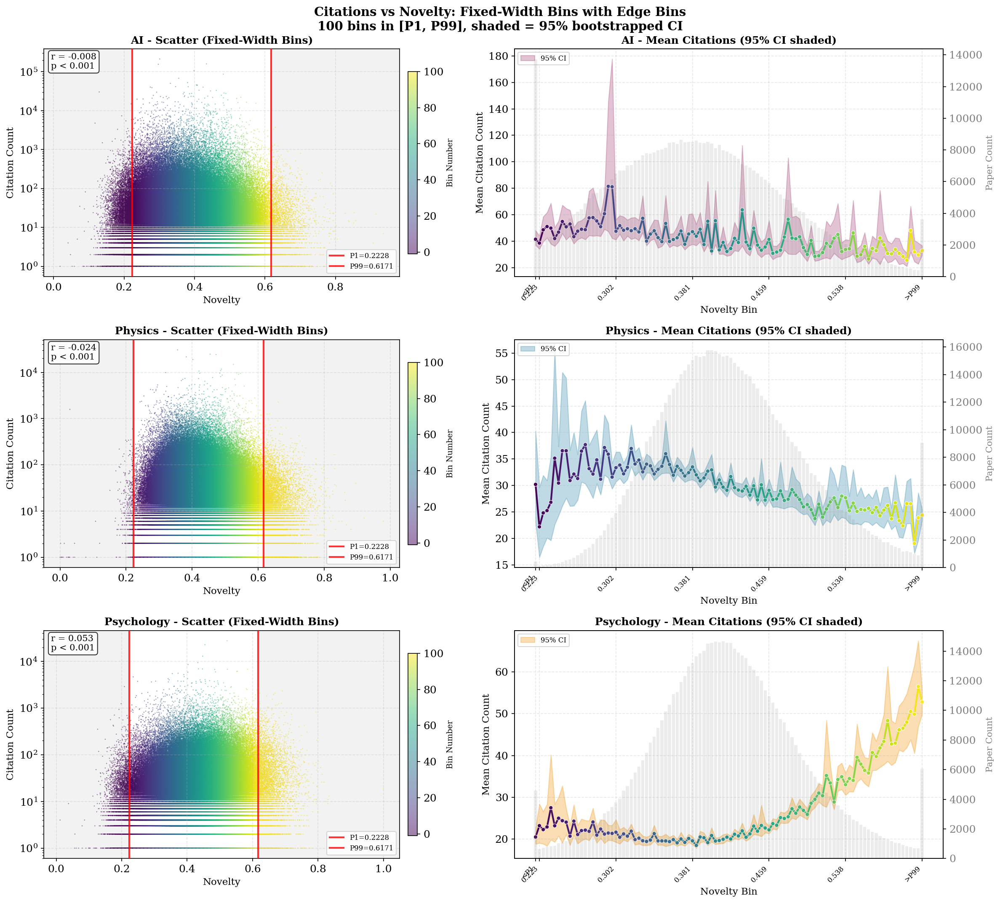

In [ ]:
# Fixed-width binning analysis with edge bins - Dynamic cutoffs
def bootstrap_ci(data, n_bootstrap=1000, ci=95, statistic=np.mean):
    """Calculate bootstrapped confidence interval.
    
    Args:
        data: Array-like data to bootstrap
        n_bootstrap: Number of bootstrap samples
        ci: Confidence interval percentage (e.g., 95 for 95% CI)
        statistic: Function to compute statistic (default: np.mean)
    
    Returns:
        tuple: (lower_bound, upper_bound, point_estimate)
    """
    data = np.array(data)
    data = data[~np.isnan(data)]
    
    if len(data) == 0:
        return np.nan, np.nan, np.nan
    
    if len(data) == 1:
        return data[0], data[0], data[0]
    
    boot_stats = []
    for _ in range(n_bootstrap):
        sample = np.random.choice(data, size=len(data), replace=True)
        boot_stats.append(statistic(sample))
    
    boot_stats = np.array(boot_stats)
    alpha = (100 - ci) / 2
    lower = np.percentile(boot_stats, alpha)
    upper = np.percentile(boot_stats, 100 - alpha)
    point_est = statistic(data)
    
    return lower, upper, point_est


def compute_fixed_width_bins_with_edges(df, n_bins=100, low_percentile=1, high_percentile=99, per_field=True, n_bootstrap=1000, ci=95):
    """Compute citation statistics using fixed-width novelty bins with edge bins.
    
    Args:
        df: DataFrame with novelty and citation data
        n_bins: Number of equal-width bins between cutoffs
        low_percentile: Percentile for low cutoff
        high_percentile: Percentile for high cutoff
        per_field: If True, compute bins separately for each field
        n_bootstrap: Number of bootstrap iterations for CI
        ci: Confidence interval percentage
        
    Returns:
        DataFrame with bin statistics including mean, CI bounds, count
    """
    fields = ['AI', 'Physics', 'Psychology']
    df_clean = df[[NOVELTY_COL, CITATION_COL, 'field']].dropna().copy()
    
    # Calculate cutoffs dynamically from data
    low_cutoff = df_clean[NOVELTY_COL].quantile(low_percentile / 100)
    high_cutoff = df_clean[NOVELTY_COL].quantile(high_percentile / 100)
    
    print(f"Dynamic cutoffs based on {low_percentile}th and {high_percentile}th percentiles:")
    print(f"  Low cutoff: {low_cutoff:.6f}")
    print(f"  High cutoff: {high_cutoff:.6f}")
    print(f"  Data range: [{df_clean[NOVELTY_COL].min():.6f}, {df_clean[NOVELTY_COL].max():.6f}]")
    
    all_stats = []
    
    # Create bin edges: one for <low_cutoff, n_bins between low and high, one for >high_cutoff
    main_bin_edges = np.linspace(low_cutoff, high_cutoff, n_bins + 1)
    bin_width = (high_cutoff - low_cutoff) / n_bins
    print(f"  Bin width: {bin_width:.6f}")
    
    for field in fields:
        field_data = df_clean[df_clean['field'] == field].copy()
        if len(field_data) == 0:
            continue
        
        # Assign bins: -1 for low edge, 0 to n_bins-1 for main bins, n_bins for high edge
        def assign_bin(x):
            if x < low_cutoff:
                return -1  # Low edge bin
            elif x > high_cutoff:
                return n_bins  # High edge bin
            else:
                # Find which main bin
                bin_idx = np.searchsorted(main_bin_edges, x, side='right') - 1
                return max(0, min(n_bins - 1, bin_idx))
        
        field_data['novelty_bin'] = field_data[NOVELTY_COL].apply(assign_bin)
        
        # Compute stats for low edge bin
        low_edge_data = field_data[field_data['novelty_bin'] == -1]
        if len(low_edge_data) > 0:
            citations = low_edge_data[CITATION_COL]
            novelty_vals = low_edge_data[NOVELTY_COL]
            ci_lower, ci_upper, citation_mean = bootstrap_ci(citations.values, n_bootstrap=n_bootstrap, ci=ci)
            all_stats.append({
                'field': field,
                'bin': -1,
                'bin_label': f'<{low_cutoff:.3f}',
                'bin_center': df_clean[NOVELTY_COL].min() + (low_cutoff - df_clean[NOVELTY_COL].min()) / 2,
                'novelty_avg': novelty_vals.mean(),
                'citation_mean': citation_mean,
                'citation_median': citations.median(),
                'citation_std': citations.std(),
                'ci_lower': ci_lower,
                'ci_upper': ci_upper,
                'count': len(low_edge_data)
            })
        
        # Compute stats for main bins
        for bin_num in range(n_bins):
            bin_data = field_data[field_data['novelty_bin'] == bin_num]
            if len(bin_data) > 0:
                citations = bin_data[CITATION_COL]
                novelty_vals = bin_data[NOVELTY_COL]
                bin_center = (main_bin_edges[bin_num] + main_bin_edges[bin_num + 1]) / 2
                ci_lower, ci_upper, citation_mean = bootstrap_ci(citations.values, n_bootstrap=n_bootstrap, ci=ci)
                
                all_stats.append({
                    'field': field,
                    'bin': bin_num,
                    'bin_label': f'{main_bin_edges[bin_num]:.4f}',
                    'bin_center': bin_center,
                    'novelty_avg': novelty_vals.mean(),
                    'citation_mean': citation_mean,
                    'citation_median': citations.median(),
                    'citation_std': citations.std(),
                    'ci_lower': ci_lower,
                    'ci_upper': ci_upper,
                    'count': len(bin_data)
                })
        
        # Compute stats for high edge bin
        high_edge_data = field_data[field_data['novelty_bin'] == n_bins]
        if len(high_edge_data) > 0:
            citations = high_edge_data[CITATION_COL]
            novelty_vals = high_edge_data[NOVELTY_COL]
            ci_lower, ci_upper, citation_mean = bootstrap_ci(citations.values, n_bootstrap=n_bootstrap, ci=ci)
            all_stats.append({
                'field': field,
                'bin': n_bins,
                'bin_label': f'>{high_cutoff:.3f}',
                'bin_center': high_cutoff + (df_clean[NOVELTY_COL].max() - high_cutoff) / 2,
                'novelty_avg': novelty_vals.mean(),
                'citation_mean': citation_mean,
                'citation_median': citations.median(),
                'citation_std': citations.std(),
                'ci_lower': ci_lower,
                'ci_upper': ci_upper,
                'count': len(high_edge_data)
            })
    
    return pd.DataFrame(all_stats), main_bin_edges, low_cutoff, high_cutoff


def plot_fixed_width_bins_with_edges(df, n_bins=100, low_percentile=1, high_percentile=99, title_suffix='', n_bootstrap=1000, ci=95):
    """Plot mean citations vs novelty with fixed-width bins and edge bins."""
    fields = ['AI', 'Physics', 'Psychology']
    colors = {'AI': '#A23B72', 'Physics': '#2E86AB', 'Psychology': '#F18F01'}
    
    # Compute fixed-width bin statistics with dynamic cutoffs
    stats_df, main_bin_edges, low_cutoff, high_cutoff = compute_fixed_width_bins_with_edges(
        df, n_bins=n_bins, low_percentile=low_percentile, high_percentile=high_percentile,
        n_bootstrap=n_bootstrap, ci=ci
    )
    
    fig, axes = plt.subplots(3, 2, figsize=(16, 14))
    
    # Prepare scatter data
    df_clean = df[[NOVELTY_COL, CITATION_COL, 'field']].dropna().copy()
    
    for idx, field in enumerate(fields):
        field_stats = stats_df[stats_df['field'] == field].sort_values('bin')
        field_scatter = df_clean[df_clean['field'] == field].copy()
        
        if len(field_stats) == 0 or len(field_scatter) == 0:
            continue
        
        # Assign bins to scatter data
        def assign_bin(x):
            if x < low_cutoff:
                return -1
            elif x > high_cutoff:
                return n_bins
            else:
                bin_idx = np.searchsorted(main_bin_edges, x, side='right') - 1
                return max(0, min(n_bins - 1, bin_idx))
        
        field_scatter['novelty_bin'] = field_scatter[NOVELTY_COL].apply(assign_bin)
        
        # Normalize colors: -1 to n_bins
        norm = plt.Normalize(-1, n_bins)
        cmap = plt.cm.viridis
        
        # LEFT: Scatter plot
        ax_left = axes[idx, 0]
        
        scatter = ax_left.scatter(
            field_scatter[NOVELTY_COL], 
            field_scatter[CITATION_COL],
            c=field_scatter['novelty_bin'],
            cmap='viridis',
            alpha=0.5,
            s=1.5,
            edgecolors='none',
            rasterized=True,
            norm=norm
        )
        
        # Draw vertical lines at cutoffs
        ax_left.axvline(x=low_cutoff, color='red', alpha=0.8, linewidth=2, linestyle='-', zorder=5, 
                       label=f'P{low_percentile}={low_cutoff:.4f}')
        ax_left.axvline(x=high_cutoff, color='red', alpha=0.8, linewidth=2, linestyle='-', zorder=5,
                       label=f'P{high_percentile}={high_cutoff:.4f}')
        
        # Add shading for edge regions
        xlim = ax_left.get_xlim()
        ax_left.axvspan(xlim[0], low_cutoff, alpha=0.1, color='gray')
        ax_left.axvspan(high_cutoff, xlim[1], alpha=0.1, color='gray')
        ax_left.set_xlim(xlim)
        
        cbar = plt.colorbar(scatter, ax=ax_left, shrink=0.8, pad=0.02)
        cbar.set_label('Bin Number', fontsize=9)
        
        ax_left.set_xlabel('Novelty', fontsize=11)
        ax_left.set_ylabel('Citation Count', fontsize=11)
        ax_left.set_title(f'{field} - Scatter (Fixed-Width Bins)', fontsize=12, fontweight='bold')
        ax_left.set_yscale('log')
        ax_left.grid(True, alpha=0.3, linestyle='--')
        ax_left.legend(loc='lower right', fontsize=8)
        
        # Correlation with p-value
        from scipy import stats

        corr, p_value = stats.pearsonr(field_scatter[NOVELTY_COL], field_scatter[CITATION_COL])

        # Format p-value
        if p_value < 0.001:
            p_str = 'p < 0.001'
        else:
            p_str = f'p = {p_value:.3f}'

        ax_left.text(0.02, 0.98, f'r = {corr:.3f}\n{p_str}', transform=ax_left.transAxes, 
                    fontsize=10, va='top', ha='left', 
                    bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        # RIGHT: Mean citations with shaded CI region
        ax_right = axes[idx, 1]
        ax_right_twin = ax_right.twinx()
        
        # Use sequential x positions for cleaner plotting
        x_positions = np.arange(len(field_stats))
        mean_vals = field_stats['citation_mean'].values
        ci_lower_vals = field_stats['ci_lower'].values
        ci_upper_vals = field_stats['ci_upper'].values
        bin_nums = field_stats['bin'].values
        count_vals = field_stats['count'].values
        
        # Draw colored line segments
        for i in range(len(x_positions) - 1):
            ax_right.plot(x_positions[i:i+2], mean_vals[i:i+2], 
                         color=cmap(norm(bin_nums[i])), linewidth=2)
        
        # Scatter points colored by bin
        scatter_right = ax_right.scatter(x_positions, mean_vals, 
                                         c=bin_nums, cmap='viridis', 
                                         s=20, zorder=5, edgecolors='white', linewidth=0.5,
                                         norm=norm)
        
        # Shaded region for bootstrapped CI
        ax_right.fill_between(x_positions, ci_lower_vals, ci_upper_vals, 
                              alpha=0.3, color=colors[field], label=f'{ci}% CI')
        
        # Paper count bars
        bar_width = 0.8
        ax_right_twin.bar(x_positions, count_vals, alpha=0.15, color='gray', width=bar_width)
        
        # Mark edge bins with vertical lines
        low_edge_pos = np.where(bin_nums == -1)[0]
        high_edge_pos = np.where(bin_nums == n_bins)[0]
        
        # Set x-tick labels - show key positions
        tick_positions = []
        tick_labels = []
        
        # Add low edge label if exists
        if len(low_edge_pos) > 0:
            tick_positions.append(low_edge_pos[0])
            tick_labels.append(f'<P{low_percentile}')
        
        # Add labels at regular intervals for main bins (every 20 bins)
        main_bin_positions = np.where((bin_nums >= 0) & (bin_nums < n_bins))[0]
        if len(main_bin_positions) > 0:
            for i, pos in enumerate(main_bin_positions):
                if bin_nums[pos] % 20 == 0:
                    tick_positions.append(pos)
                    tick_labels.append(f'{main_bin_edges[bin_nums[pos]]:.3f}')
        
        # Add high edge label if exists
        if len(high_edge_pos) > 0:
            tick_positions.append(high_edge_pos[0])
            tick_labels.append(f'>P{high_percentile}')
        
        ax_right.set_xticks(tick_positions)
        ax_right.set_xticklabels(tick_labels, rotation=45, ha='right', fontsize=8)
        
        ax_right.set_xlabel('Novelty Bin', fontsize=11)
        ax_right.set_ylabel('Mean Citation Count', fontsize=11)
        ax_right_twin.set_ylabel('Paper Count', fontsize=10, color='gray')
        ax_right_twin.tick_params(axis='y', labelcolor='gray')
        ax_right.set_title(f'{field} - Mean Citations ({ci}% CI shaded)', fontsize=12, fontweight='bold')
        ax_right.grid(True, alpha=0.3, linestyle='--')
        ax_right.legend(loc='upper left', fontsize=8)
        
        # Print summary stats
        low_count = field_stats[field_stats['bin'] == -1]['count'].sum() if -1 in bin_nums else 0
        high_count = field_stats[field_stats['bin'] == n_bins]['count'].sum() if n_bins in bin_nums else 0
        main_count = field_stats[(field_stats['bin'] >= 0) & (field_stats['bin'] < n_bins)]['count'].sum()
        print(f"\n{field}: Papers in <P{low_percentile}: {low_count:,}, "
              f"in [P{low_percentile}-P{high_percentile}]: {main_count:,}, "
              f"in >P{high_percentile}: {high_count:,}")
    
    plt.tight_layout()
    fig.suptitle(f'Citations vs Novelty: Fixed-Width Bins with Edge Bins\n'
                 f'{n_bins} bins in [P{low_percentile}, P{high_percentile}], shaded = {ci}% bootstrapped CI', 
                fontsize=14, fontweight='bold', y=1.02)
    return fig, stats_df


# Run the fixed-width binning analysis with tighter cutoffs (1st and 99th percentiles)
print("=== Citation vs Novelty: Fixed-Width Bins with Dynamic Edge Cutoffs ===")
fig_fixed, stats_fixed = plot_fixed_width_bins_with_edges(
    merged_df, 
    n_bins=100, 
    low_percentile=1,   # 1st percentile as low cutoff (~1% in edge bin)
    high_percentile=99, # 99th percentile as high cutoff (~1% in edge bin)
    title_suffix='',
    n_bootstrap=1000,
    ci=95
)
plt.show()

=== Citation vs Novelty: Flexible Fixed-Width Bins (Per-Field Cutoffs) ===

AI - Cutoffs based on 0.1th and 99.9th percentiles:
  Low cutoff (P0.1): 0.156730
  High cutoff (P99.9): 0.683789
  Data range: [0.018360, 0.936322]
  Bin width: 0.005271

Physics - Cutoffs based on 0.1th and 99.9th percentiles:
  Low cutoff (P0.1): 0.231695
  High cutoff (P99.9): 0.711838
  Data range: [0.000000, 0.979595]
  Bin width: 0.004801

Psychology - Cutoffs based on 0.1th and 99.9th percentiles:
  Low cutoff (P0.1): 0.177501
  High cutoff (P99.9): 0.693996
  Data range: [0.011628, 1.000000]
  Bin width: 0.005165

AI: Papers in Low (P0.1): 506, in [P0.1-P99.9]: 504,057, in High (P99.9): 506

Physics: Papers in Low (P0.1): 718, in [P0.1-P99.9]: 716,055, in High (P99.9): 718

Psychology: Papers in Low (P0.1): 649, in [P0.1-P99.9]: 647,238, in High (P99.9): 649


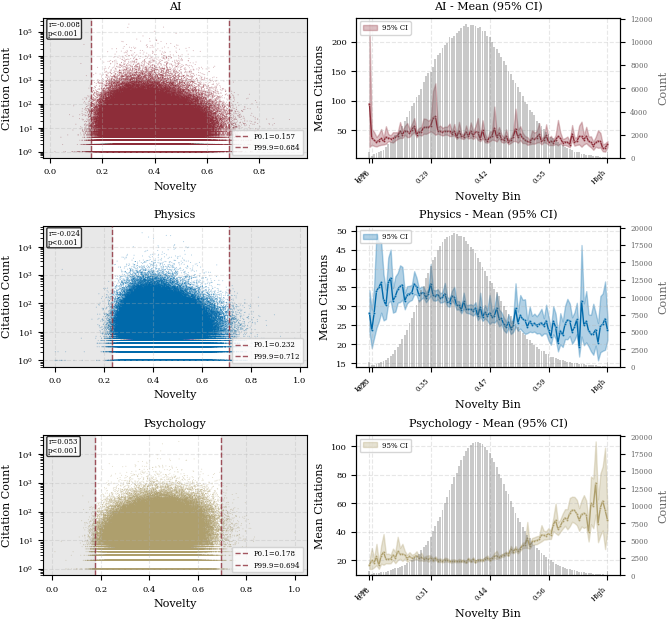

In [52]:
# Fixed-width binning analysis with flexible error visualization and edge bin options
def bootstrap_ci(data, n_bootstrap=1000, ci=95, statistic=np.mean):
    """Calculate bootstrapped confidence interval."""
    data = np.array(data)
    data = data[~np.isnan(data)]
    
    if len(data) == 0:
        return np.nan, np.nan, np.nan
    
    if len(data) == 1:
        return data[0], data[0], data[0]
    
    boot_stats = []
    for _ in range(n_bootstrap):
        sample = np.random.choice(data, size=len(data), replace=True)
        boot_stats.append(statistic(sample))
    
    boot_stats = np.array(boot_stats)
    alpha = (100 - ci) / 2
    lower = np.percentile(boot_stats, alpha)
    upper = np.percentile(boot_stats, 100 - alpha)
    point_est = statistic(data)
    
    return lower, upper, point_est


def compute_fixed_width_bins_flexible(df, n_bins=100, low_percentile=1, high_percentile=99, 
                                       collect_edge_bins=True, n_bootstrap=1000, ci=95):
    """Compute citation statistics using fixed-width novelty bins PER FIELD."""
    fields = ['AI', 'Physics', 'Psychology']
    df_clean = df[[NOVELTY_COL, CITATION_COL, 'field']].dropna().copy()
    
    all_stats = []
    field_cutoffs = {}  # Store cutoffs per field
    field_bin_edges = {}  # Store bin edges per field
    
    for field in fields:
        field_data = df_clean[df_clean['field'] == field].copy()
        if len(field_data) == 0:
            continue
        
        # Calculate cutoffs PER FIELD
        low_cutoff = field_data[NOVELTY_COL].quantile(low_percentile / 100)
        high_cutoff = field_data[NOVELTY_COL].quantile(high_percentile / 100)
        
        field_cutoffs[field] = (low_cutoff, high_cutoff)
        
        print(f"\n{field} - Cutoffs based on {low_percentile}th and {high_percentile}th percentiles:")
        print(f"  Low cutoff (P{low_percentile}): {low_cutoff:.6f}")
        print(f"  High cutoff (P{high_percentile}): {high_cutoff:.6f}")
        print(f"  Data range: [{field_data[NOVELTY_COL].min():.6f}, {field_data[NOVELTY_COL].max():.6f}]")
        
        if collect_edge_bins:
            main_bin_edges = np.linspace(low_cutoff, high_cutoff, n_bins + 1)
            bin_width = (high_cutoff - low_cutoff) / n_bins
        else:
            data_min = field_data[NOVELTY_COL].min()
            data_max = field_data[NOVELTY_COL].max()
            main_bin_edges = np.linspace(data_min, data_max, n_bins + 1)
            bin_width = (data_max - data_min) / n_bins
        
        field_bin_edges[field] = main_bin_edges
        print(f"  Bin width: {bin_width:.6f}")
        
        if collect_edge_bins:
            def assign_bin(x):
                if x < low_cutoff:
                    return -1
                elif x > high_cutoff:
                    return n_bins
                else:
                    bin_idx = np.searchsorted(main_bin_edges, x, side='right') - 1
                    return max(0, min(n_bins - 1, bin_idx))
        else:
            def assign_bin(x):
                bin_idx = np.searchsorted(main_bin_edges, x, side='right') - 1
                return max(0, min(n_bins - 1, bin_idx))
        
        field_data['novelty_bin'] = field_data[NOVELTY_COL].apply(assign_bin)
        
        if collect_edge_bins:
            low_edge_data = field_data[field_data['novelty_bin'] == -1]
            if len(low_edge_data) > 0:
                citations = low_edge_data[CITATION_COL]
                novelty_vals = low_edge_data[NOVELTY_COL]
                ci_lower, ci_upper, citation_mean = bootstrap_ci(citations.values, n_bootstrap=n_bootstrap, ci=ci)
                n = len(low_edge_data)
                std = citations.std()
                sem = std / np.sqrt(n) if n > 0 else np.nan
                all_stats.append({
                    'field': field,
                    'bin': -1,
                    'bin_label': f'<{low_cutoff:.3f}',
                    'bin_center': field_data[NOVELTY_COL].min() + (low_cutoff - field_data[NOVELTY_COL].min()) / 2,
                    'novelty_avg': novelty_vals.mean(),
                    'citation_mean': citation_mean,
                    'citation_median': citations.median(),
                    'citation_std': std,
                    'citation_sem': sem,
                    'ci_lower': ci_lower,
                    'ci_upper': ci_upper,
                    'count': n
                })
        
        for bin_num in range(n_bins):
            bin_data = field_data[field_data['novelty_bin'] == bin_num]
            if len(bin_data) > 0:
                citations = bin_data[CITATION_COL]
                novelty_vals = bin_data[NOVELTY_COL]
                bin_center = (main_bin_edges[bin_num] + main_bin_edges[bin_num + 1]) / 2
                ci_lower, ci_upper, citation_mean = bootstrap_ci(citations.values, n_bootstrap=n_bootstrap, ci=ci)
                n = len(bin_data)
                std = citations.std()
                sem = std / np.sqrt(n) if n > 0 else np.nan
                
                all_stats.append({
                    'field': field,
                    'bin': bin_num,
                    'bin_label': f'{main_bin_edges[bin_num]:.4f}',
                    'bin_center': bin_center,
                    'novelty_avg': novelty_vals.mean(),
                    'citation_mean': citation_mean,
                    'citation_median': citations.median(),
                    'citation_std': std,
                    'citation_sem': sem,
                    'ci_lower': ci_lower,
                    'ci_upper': ci_upper,
                    'count': n
                })
        
        if collect_edge_bins:
            high_edge_data = field_data[field_data['novelty_bin'] == n_bins]
            if len(high_edge_data) > 0:
                citations = high_edge_data[CITATION_COL]
                novelty_vals = high_edge_data[NOVELTY_COL]
                ci_lower, ci_upper, citation_mean = bootstrap_ci(citations.values, n_bootstrap=n_bootstrap, ci=ci)
                n = len(high_edge_data)
                std = citations.std()
                sem = std / np.sqrt(n) if n > 0 else np.nan
                all_stats.append({
                    'field': field,
                    'bin': n_bins,
                    'bin_label': f'>{high_cutoff:.3f}',
                    'bin_center': high_cutoff + (field_data[NOVELTY_COL].max() - high_cutoff) / 2,
                    'novelty_avg': novelty_vals.mean(),
                    'citation_mean': citation_mean,
                    'citation_median': citations.median(),
                    'citation_std': std,
                    'citation_sem': sem,
                    'ci_lower': ci_lower,
                    'ci_upper': ci_upper,
                    'count': n
                })
    
    return pd.DataFrame(all_stats), field_bin_edges, field_cutoffs


def plot_fixed_width_bins_flexible(df, n_bins=100, low_percentile=1, high_percentile=99, 
                                    collect_edge_bins=True, error_type='ci', use_fill=True,
                                    title_suffix='', n_bootstrap=1000, ci=95):
    """Plot mean citations vs novelty with flexible error visualization using tueplots."""
    from scipy import stats as scipy_stats
    from tueplots import bundles
    from tueplots.constants.color import rgb
    
    fields = ['AI', 'Physics', 'Psychology']
    
    # Convert rgb tuples to proper color format
    color_red = tuple(rgb.tue_red)
    color_blue = tuple(rgb.tue_blue)
    color_gold = tuple(rgb.tue_gold)
    color_gray = (0.4, 0.4, 0.4)  # Darker gray for paper count bars
    
    colors = {
        'AI': color_red,
        'Physics': color_blue,
        'Psychology': color_gold
    }
    
    # Compute fixed-width bin statistics (now per field)
    stats_df, field_bin_edges, field_cutoffs = compute_fixed_width_bins_flexible(
        df, n_bins=n_bins, low_percentile=low_percentile, high_percentile=high_percentile,
        collect_edge_bins=collect_edge_bins, n_bootstrap=n_bootstrap, ci=ci
    )
    
    # Apply tueplots ICML 2024 style
    plt.rcParams.update(bundles.icml2024(column="full", nrows=3, ncols=2))
    plt.rcParams['text.usetex'] = False
    fig, axes = plt.subplots(3, 2, layout='constrained')
    
    # Prepare scatter data
    df_clean = df[[NOVELTY_COL, CITATION_COL, 'field']].dropna().copy()
    
    for idx, field in enumerate(fields):
        field_stats = stats_df[stats_df['field'] == field].sort_values('bin')
        field_scatter = df_clean[df_clean['field'] == field].copy()
        
        if len(field_stats) == 0 or len(field_scatter) == 0:
            continue
        
        # Get field-specific cutoffs and bin edges
        low_cutoff, high_cutoff = field_cutoffs[field]
        main_bin_edges = field_bin_edges[field]
        
        # Assign bins to scatter data using field-specific cutoffs
        if collect_edge_bins:
            def assign_bin(x):
                if x < low_cutoff:
                    return -1
                elif x > high_cutoff:
                    return n_bins
                else:
                    bin_idx = np.searchsorted(main_bin_edges, x, side='right') - 1
                    return max(0, min(n_bins - 1, bin_idx))
            norm = plt.Normalize(-1, n_bins)
        else:
            def assign_bin(x):
                bin_idx = np.searchsorted(main_bin_edges, x, side='right') - 1
                return max(0, min(n_bins - 1, bin_idx))
            norm = plt.Normalize(0, n_bins - 1)
        
        field_scatter['novelty_bin'] = field_scatter[NOVELTY_COL].apply(assign_bin)
        
        # LEFT: Scatter plot - use field color
        ax_left = axes[idx, 0]
        
        scatter = ax_left.scatter(
            field_scatter[NOVELTY_COL], 
            field_scatter[CITATION_COL],
            c=[colors[field]],
            alpha=0.4,
            s=0.5,
            edgecolors='none',
            rasterized=True
        )
        
        if collect_edge_bins:
            ax_left.axvline(x=low_cutoff, color=color_red, alpha=0.8, linewidth=1.0, linestyle='--', zorder=5, 
                           label=f'P{low_percentile}={low_cutoff:.3f}')
            ax_left.axvline(x=high_cutoff, color=color_red, alpha=0.8, linewidth=1.0, linestyle='--', zorder=5,
                           label=f'P{high_percentile}={high_cutoff:.3f}')
            
            xlim = ax_left.get_xlim()
            ax_left.axvspan(xlim[0], low_cutoff, alpha=0.15, color=color_gray)
            ax_left.axvspan(high_cutoff, xlim[1], alpha=0.15, color=color_gray)
            ax_left.set_xlim(xlim)
        
        ax_left.set_xlabel('Novelty')
        ax_left.set_ylabel('Citation Count')
        ax_left.set_title(f'{field}')
        ax_left.set_yscale('log')
        ax_left.grid(True, alpha=0.3, linestyle='--')
        if collect_edge_bins:
            ax_left.legend(loc='lower right', fontsize=5)
        
        # Correlation with p-value
        corr, p_value = scipy_stats.pearsonr(field_scatter[NOVELTY_COL], field_scatter[CITATION_COL])
        p_str = 'p<0.001' if p_value < 0.001 else f'p={p_value:.3f}'
        ax_left.text(0.02, 0.98, f'r={corr:.3f}\n{p_str}', transform=ax_left.transAxes, 
                    fontsize=5, va='top', ha='left', 
                    bbox=dict(boxstyle='round', facecolor='white', alpha=0.8, pad=0.2))
        
        # RIGHT: Mean citations with error visualization
        ax_right = axes[idx, 1]
        ax_right_twin = ax_right.twinx()
        
        x_positions = np.arange(len(field_stats))
        mean_vals = field_stats['citation_mean'].values
        bin_nums = field_stats['bin'].values
        count_vals = field_stats['count'].values
        
        # Determine error bounds based on error_type
        if error_type == 'std':
            error_lower = mean_vals - field_stats['citation_std'].values
            error_upper = mean_vals + field_stats['citation_std'].values
            error_vals = field_stats['citation_std'].values
            error_label = '±1 STD'
        elif error_type == 'sem':
            error_lower = mean_vals - field_stats['citation_sem'].values
            error_upper = mean_vals + field_stats['citation_sem'].values
            error_vals = field_stats['citation_sem'].values
            error_label = '±1 SEM'
        else:  # 'ci'
            error_lower = field_stats['ci_lower'].values
            error_upper = field_stats['ci_upper'].values
            error_vals = None
            error_label = f'{ci}% CI'
        
        # Draw line with field color
        ax_right.plot(x_positions, mean_vals, color=colors[field], linewidth=1.0)
        
        # Scatter points with field color - smaller markers
        ax_right.scatter(x_positions, mean_vals, 
                        c=[colors[field]], 
                        s=3, zorder=5, edgecolors='white', linewidth=0.2)
        
        # Error visualization
        if use_fill:
            ax_right.fill_between(x_positions, error_lower, error_upper, 
                                  alpha=0.3, color=colors[field], label=error_label)
        else:
            if error_type == 'ci':
                yerr_lower = mean_vals - error_lower
                yerr_upper = error_upper - mean_vals
                ax_right.errorbar(x_positions, mean_vals, 
                                 yerr=[yerr_lower, yerr_upper],
                                 fmt='none', color=colors[field], alpha=0.6, 
                                 capsize=1, capthick=0.5, label=error_label)
            else:
                ax_right.errorbar(x_positions, mean_vals, 
                                 yerr=error_vals,
                                 fmt='none', color=colors[field], alpha=0.6, 
                                 capsize=1, capthick=0.5, label=error_label)
        
        # Paper count bars - darker gray
        bar_width = 0.8
        ax_right_twin.bar(x_positions, count_vals, alpha=0.35, color=color_gray, width=bar_width)
        
        # Set x-tick labels
        tick_positions = []
        tick_labels = []
        
        if collect_edge_bins:
            low_edge_pos = np.where(bin_nums == -1)[0]
            high_edge_pos = np.where(bin_nums == n_bins)[0]
            
            if len(low_edge_pos) > 0:
                tick_positions.append(low_edge_pos[0])
                tick_labels.append(f'Low')
            
            main_bin_positions = np.where((bin_nums >= 0) & (bin_nums < n_bins))[0]
            if len(main_bin_positions) > 0:
                for i, pos in enumerate(main_bin_positions):
                    if bin_nums[pos] % 25 == 0:
                        tick_positions.append(pos)
                        tick_labels.append(f'{main_bin_edges[bin_nums[pos]]:.2f}')
            
            if len(high_edge_pos) > 0:
                tick_positions.append(high_edge_pos[0])
                tick_labels.append(f'High')
        else:
            interval = max(1, len(x_positions) // 10)
            for i in range(0, len(x_positions), interval):
                tick_positions.append(i)
                tick_labels.append(f'{main_bin_edges[bin_nums[i]]:.2f}')
        
        ax_right.set_xticks(tick_positions)
        ax_right.set_xticklabels(tick_labels, rotation=45, ha='right', fontsize=5)
        
        ax_right.set_xlabel('Novelty Bin')
        ax_right.set_ylabel('Mean Citations')
        ax_right_twin.set_ylabel('Count', color=color_gray)
        ax_right_twin.tick_params(axis='y', labelcolor=color_gray, labelsize=5)
        
        ax_right.set_title(f'{field} - Mean ({error_label})')
        ax_right.grid(True, alpha=0.3, linestyle='--')
        ax_right.legend(loc='upper left', fontsize=5)
        
        # Print summary stats
        if collect_edge_bins:
            low_count = field_stats[field_stats['bin'] == -1]['count'].sum() if -1 in bin_nums else 0
            high_count = field_stats[field_stats['bin'] == n_bins]['count'].sum() if n_bins in bin_nums else 0
            main_count = field_stats[(field_stats['bin'] >= 0) & (field_stats['bin'] < n_bins)]['count'].sum()
            print(f"\n{field}: Papers in Low (P{low_percentile}): {low_count:,}, "
                  f"in [P{low_percentile}-P{high_percentile}]: {main_count:,}, "
                  f"in High (P{high_percentile}): {high_count:,}")
        else:
            total_count = field_stats['count'].sum()
            print(f"\n{field}: Total papers in {n_bins} bins: {total_count:,}")
    
    #plt.show()
    plt.savefig("fixed_width_bins_icml_fixed.pdf")
    return fig, stats_df


# Run with CI, fill_between, and edge bins
print("=== Citation vs Novelty: Flexible Fixed-Width Bins (Per-Field Cutoffs) ===")
fig_fixed, stats_fixed = plot_fixed_width_bins_flexible(
    merged_df, 
    n_bins=100, 
    low_percentile=0.1,
    high_percentile=99.9,
    collect_edge_bins=True,
    error_type='ci',
    use_fill=True,
    n_bootstrap=1000,
    ci=95
)

=== Citation vs Novelty: Flexible Fixed-Width Bins (Per-Field Cutoffs) ===

AI - Cutoffs based on P0.1 and P99.9:
  Low cutoff (P0.1): 0.156730
  High cutoff (P99.9): 0.683789
  Data range: [0.018360, 0.936322]
  Bin width: 0.005271

Physics - Cutoffs based on P0.1 and P99.9:
  Low cutoff (P0.1): 0.231695
  High cutoff (P99.9): 0.711838
  Data range: [0.000000, 0.979595]
  Bin width: 0.004801

Psychology - Cutoffs based on P0.1 and P99.9:
  Low cutoff (P0.1): 0.177501
  High cutoff (P99.9): 0.693996
  Data range: [0.011628, 1.000000]
  Bin width: 0.005165

AI: Papers in Low (<P0.1): 506, in [P0.1-P99.9]: 504,057, in High (>P99.9): 506

Physics: Papers in Low (<P0.1): 718, in [P0.1-P99.9]: 716,055, in High (>P99.9): 718

Psychology: Papers in Low (<P0.1): 649, in [P0.1-P99.9]: 647,238, in High (>P99.9): 649


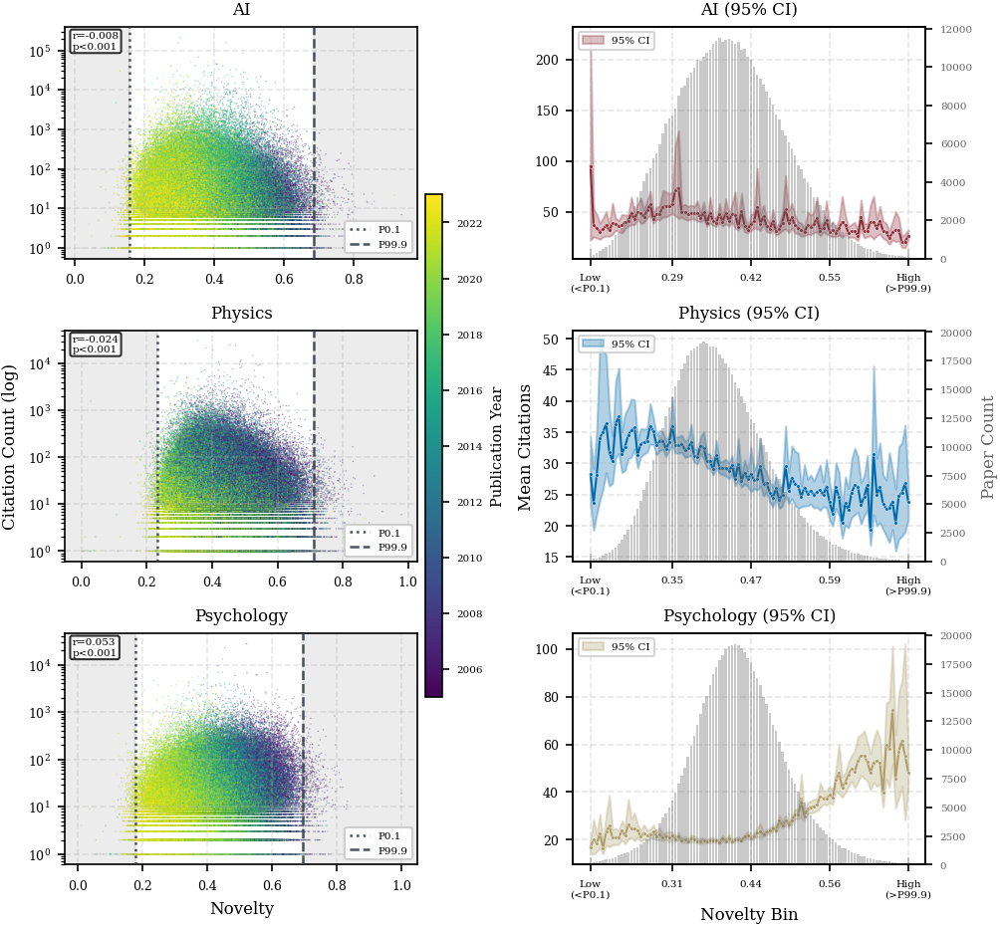

In [127]:
# Fixed-width binning analysis with flexible error visualization and edge bin options
def bootstrap_ci(data, n_bootstrap=1000, ci=95, statistic=np.mean):
    """Calculate bootstrapped confidence interval."""
    data = np.array(data)
    data = data[~np.isnan(data)]
    
    if len(data) == 0:
        return np.nan, np.nan, np.nan
    
    if len(data) == 1:
        return data[0], data[0], data[0]
    
    boot_stats = []
    for _ in range(n_bootstrap):
        sample = np.random.choice(data, size=len(data), replace=True)
        boot_stats.append(statistic(sample))
    
    boot_stats = np.array(boot_stats)
    alpha = (100 - ci) / 2
    lower = np.percentile(boot_stats, alpha)
    upper = np.percentile(boot_stats, 100 - alpha)
    point_est = statistic(data)
    
    return lower, upper, point_est


def compute_fixed_width_bins_flexible(df, n_bins=100, low_percentile=1, high_percentile=99, 
                                       collect_edge_bins=True, n_bootstrap=1000, ci=95):
    """Compute citation statistics using fixed-width novelty bins PER FIELD."""
    fields = ['AI', 'Physics', 'Psychology']
    df_clean = df[[NOVELTY_COL, CITATION_COL, 'field', 'publication_year']].dropna().copy()
    
    all_stats = []
    field_cutoffs = {}  # Store cutoffs per field
    field_bin_edges = {}  # Store bin edges per field
    
    for field in fields:
        field_data = df_clean[df_clean['field'] == field].copy()
        if len(field_data) == 0:
            continue
        
        # Calculate cutoffs PER FIELD
        low_cutoff = field_data[NOVELTY_COL].quantile(low_percentile / 100)
        high_cutoff = field_data[NOVELTY_COL].quantile(high_percentile / 100)
        
        field_cutoffs[field] = (low_cutoff, high_cutoff)
        
        print(f"\n{field} - Cutoffs based on P{low_percentile} and P{high_percentile}:")
        print(f"  Low cutoff (P{low_percentile}): {low_cutoff:.6f}")
        print(f"  High cutoff (P{high_percentile}): {high_cutoff:.6f}")
        print(f"  Data range: [{field_data[NOVELTY_COL].min():.6f}, {field_data[NOVELTY_COL].max():.6f}]")
        
        if collect_edge_bins:
            main_bin_edges = np.linspace(low_cutoff, high_cutoff, n_bins + 1)
            bin_width = (high_cutoff - low_cutoff) / n_bins
        else:
            data_min = field_data[NOVELTY_COL].min()
            data_max = field_data[NOVELTY_COL].max()
            main_bin_edges = np.linspace(data_min, data_max, n_bins + 1)
            bin_width = (data_max - data_min) / n_bins
        
        field_bin_edges[field] = main_bin_edges
        print(f"  Bin width: {bin_width:.6f}")
        
        if collect_edge_bins:
            def assign_bin(x):
                if x < low_cutoff:
                    return -1
                elif x > high_cutoff:
                    return n_bins
                else:
                    bin_idx = np.searchsorted(main_bin_edges, x, side='right') - 1
                    return max(0, min(n_bins - 1, bin_idx))
        else:
            def assign_bin(x):
                bin_idx = np.searchsorted(main_bin_edges, x, side='right') - 1
                return max(0, min(n_bins - 1, bin_idx))
        
        field_data['novelty_bin'] = field_data[NOVELTY_COL].apply(assign_bin)
        
        if collect_edge_bins:
            low_edge_data = field_data[field_data['novelty_bin'] == -1]
            if len(low_edge_data) > 0:
                citations = low_edge_data[CITATION_COL]
                novelty_vals = low_edge_data[NOVELTY_COL]
                ci_lower, ci_upper, citation_mean = bootstrap_ci(citations.values, n_bootstrap=n_bootstrap, ci=ci)
                n = len(low_edge_data)
                std = citations.std()
                sem = std / np.sqrt(n) if n > 0 else np.nan
                all_stats.append({
                    'field': field,
                    'bin': -1,
                    'bin_label': f'<{low_cutoff:.3f}',
                    'bin_center': field_data[NOVELTY_COL].min() + (low_cutoff - field_data[NOVELTY_COL].min()) / 2,
                    'novelty_avg': novelty_vals.mean(),
                    'citation_mean': citation_mean,
                    'citation_median': citations.median(),
                    'citation_std': std,
                    'citation_sem': sem,
                    'ci_lower': ci_lower,
                    'ci_upper': ci_upper,
                    'count': n
                })
        
        for bin_num in range(n_bins):
            bin_data = field_data[field_data['novelty_bin'] == bin_num]
            if len(bin_data) > 0:
                citations = bin_data[CITATION_COL]
                novelty_vals = bin_data[NOVELTY_COL]
                bin_center = (main_bin_edges[bin_num] + main_bin_edges[bin_num + 1]) / 2
                ci_lower, ci_upper, citation_mean = bootstrap_ci(citations.values, n_bootstrap=n_bootstrap, ci=ci)
                n = len(bin_data)
                std = citations.std()
                sem = std / np.sqrt(n) if n > 0 else np.nan
                
                all_stats.append({
                    'field': field,
                    'bin': bin_num,
                    'bin_label': f'{main_bin_edges[bin_num]:.4f}',
                    'bin_center': bin_center,
                    'novelty_avg': novelty_vals.mean(),
                    'citation_mean': citation_mean,
                    'citation_median': citations.median(),
                    'citation_std': std,
                    'citation_sem': sem,
                    'ci_lower': ci_lower,
                    'ci_upper': ci_upper,
                    'count': n
                })
        
        if collect_edge_bins:
            high_edge_data = field_data[field_data['novelty_bin'] == n_bins]
            if len(high_edge_data) > 0:
                citations = high_edge_data[CITATION_COL]
                novelty_vals = high_edge_data[NOVELTY_COL]
                ci_lower, ci_upper, citation_mean = bootstrap_ci(citations.values, n_bootstrap=n_bootstrap, ci=ci)
                n = len(high_edge_data)
                std = citations.std()
                sem = std / np.sqrt(n) if n > 0 else np.nan
                all_stats.append({
                    'field': field,
                    'bin': n_bins,
                    'bin_label': f'>{high_cutoff:.3f}',
                    'bin_center': high_cutoff + (field_data[NOVELTY_COL].max() - high_cutoff) / 2,
                    'novelty_avg': novelty_vals.mean(),
                    'citation_mean': citation_mean,
                    'citation_median': citations.median(),
                    'citation_std': std,
                    'citation_sem': sem,
                    'ci_lower': ci_lower,
                    'ci_upper': ci_upper,
                    'count': n
                })
    
    return pd.DataFrame(all_stats), field_bin_edges, field_cutoffs


def plot_fixed_width_bins_flexible(df, n_bins=100, low_percentile=1, high_percentile=99, 
                                    collect_edge_bins=True, error_type='ci', use_fill=True,
                                    title_suffix='', n_bootstrap=1000, ci=95):
    """Plot mean citations vs novelty with flexible error visualization using tueplots."""
    from scipy import stats as scipy_stats
    from tueplots import bundles
    from tueplots.constants.color import rgb
    
    fields = ['AI', 'Physics', 'Psychology']
    
    # Convert rgb tuples to proper color format
    color_red = tuple(rgb.tue_red)
    color_blue = tuple(rgb.tue_blue)
    color_gold = tuple(rgb.tue_gold)
    color_gray = (0.4, 0.4, 0.4)  # Darker gray for paper count bars
    color_dark = tuple(rgb.tue_dark) if hasattr(rgb, 'tue_dark') else (0.2, 0.2, 0.2)
    
    colors = {
        'AI': color_red,
        'Physics': color_blue,
        'Psychology': color_gold
    }
    
    # Compute fixed-width bin statistics (now per field)
    stats_df, field_bin_edges, field_cutoffs = compute_fixed_width_bins_flexible(
        df, n_bins=n_bins, low_percentile=low_percentile, high_percentile=high_percentile,
        collect_edge_bins=collect_edge_bins, n_bootstrap=n_bootstrap, ci=ci
    )
    
    # Apply tueplots ICML 2024 style
    plt.rcParams.update(bundles.icml2024(column="full", nrows=3, ncols=2))
    plt.rcParams['text.usetex'] = False
    fig, axes = plt.subplots(3, 2, layout='constrained')
    
    # Prepare scatter data - include publication_year
    df_clean = df[[NOVELTY_COL, CITATION_COL, 'field', 'publication_year']].dropna().copy()
    
    # Get year range for colormap
    year_min = df_clean['publication_year'].min()
    year_max = df_clean['publication_year'].max()
    year_norm = plt.Normalize(year_min, year_max)
    year_cmap = plt.cm.viridis
    
    # Create a shared ScalarMappable for the colorbar
    sm = plt.cm.ScalarMappable(cmap='viridis', norm=year_norm)
    sm.set_array([])
    
    for idx, field in enumerate(fields):
        field_stats = stats_df[stats_df['field'] == field].sort_values('bin')
        field_scatter = df_clean[df_clean['field'] == field].copy()
        
        if len(field_stats) == 0 or len(field_scatter) == 0:
            continue
        
        # Get field-specific cutoffs and bin edges
        low_cutoff, high_cutoff = field_cutoffs[field]
        main_bin_edges = field_bin_edges[field]
        
        # Assign bins to scatter data using field-specific cutoffs
        if collect_edge_bins:
            def assign_bin(x):
                if x < low_cutoff:
                    return -1
                elif x > high_cutoff:
                    return n_bins
                else:
                    bin_idx = np.searchsorted(main_bin_edges, x, side='right') - 1
                    return max(0, min(n_bins - 1, bin_idx))
            norm = plt.Normalize(-1, n_bins)
        else:
            def assign_bin(x):
                bin_idx = np.searchsorted(main_bin_edges, x, side='right') - 1
                return max(0, min(n_bins - 1, bin_idx))
            norm = plt.Normalize(0, n_bins - 1)
        
        field_scatter['novelty_bin'] = field_scatter[NOVELTY_COL].apply(assign_bin)
        
        # LEFT: Scatter plot - color by publication year
        ax_left = axes[idx, 0]
        
        scatter = ax_left.scatter(
            field_scatter[NOVELTY_COL], 
            field_scatter[CITATION_COL],
            c=field_scatter['publication_year'],
            cmap='viridis',
            norm=year_norm,
            alpha=0.4,
            s=0.5,
            edgecolors='none',
            rasterized=True
        )
        
        if collect_edge_bins:
            # Different line styles for low and high percentile
            ax_left.axvline(x=low_cutoff, color=color_dark, alpha=0.9, linewidth=1.2, linestyle=':', zorder=5, 
                           label=f'P{low_percentile}')
            ax_left.axvline(x=high_cutoff, color=color_dark, alpha=0.9, linewidth=1.2, linestyle='--', zorder=5,
                           label=f'P{high_percentile}')
            
            xlim = ax_left.get_xlim()
            ax_left.axvspan(xlim[0], low_cutoff, alpha=0.12, color=color_gray)
            ax_left.axvspan(high_cutoff, xlim[1], alpha=0.12, color=color_gray)
            ax_left.set_xlim(xlim)
        
        # Only set ylabel for leftmost column
        if idx == 1:  # Middle row
            ax_left.set_ylabel('Citation Count (log)')
        
        ax_left.set_title(f'{field}')
        ax_left.set_yscale('log')
        ax_left.grid(True, alpha=0.3, linestyle='--')
        if collect_edge_bins:
            ax_left.legend(loc='lower right', fontsize=5, framealpha=0.9)
        
        # Correlation with p-value
        corr, p_value = scipy_stats.pearsonr(field_scatter[NOVELTY_COL], field_scatter[CITATION_COL])
        p_str = 'p<0.001' if p_value < 0.001 else f'p={p_value:.3f}'
        ax_left.text(0.02, 0.98, f'r={corr:.3f}\n{p_str}', transform=ax_left.transAxes, 
                    fontsize=5, va='top', ha='left', 
                    bbox=dict(boxstyle='round', facecolor='white', alpha=0.8, pad=0.2))
        
        # RIGHT: Mean citations with error visualization
        ax_right = axes[idx, 1]
        ax_right_twin = ax_right.twinx()
        
        x_positions = np.arange(len(field_stats))
        mean_vals = field_stats['citation_mean'].values
        bin_nums = field_stats['bin'].values
        count_vals = field_stats['count'].values
        
        # Determine error bounds based on error_type
        if error_type == 'std':
            error_lower = mean_vals - field_stats['citation_std'].values
            error_upper = mean_vals + field_stats['citation_std'].values
            error_vals = field_stats['citation_std'].values
            error_label = '±1 STD'
        elif error_type == 'sem':
            error_lower = mean_vals - field_stats['citation_sem'].values
            error_upper = mean_vals + field_stats['citation_sem'].values
            error_vals = field_stats['citation_sem'].values
            error_label = '±1 SEM'
        else:  # 'ci'
            error_lower = field_stats['ci_lower'].values
            error_upper = field_stats['ci_upper'].values
            error_vals = None
            error_label = f'{ci}% CI'
        
        # Draw line with field color
        ax_right.plot(x_positions, mean_vals, color=colors[field], linewidth=1.0)
        
        # Scatter points with field color - smaller markers
        ax_right.scatter(x_positions, mean_vals, 
                        c=[colors[field]], 
                        s=3, zorder=5, edgecolors='white', linewidth=0.2)
        
        # Error visualization
        if use_fill:
            ax_right.fill_between(x_positions, error_lower, error_upper, 
                                  alpha=0.3, color=colors[field], label=error_label)
        else:
            if error_type == 'ci':
                yerr_lower = mean_vals - error_lower
                yerr_upper = error_upper - mean_vals
                ax_right.errorbar(x_positions, mean_vals, 
                                 yerr=[yerr_lower, yerr_upper],
                                 fmt='none', color=colors[field], alpha=0.6, 
                                 capsize=1, capthick=0.5, label=error_label)
            else:
                ax_right.errorbar(x_positions, mean_vals, 
                                 yerr=error_vals,
                                 fmt='none', color=colors[field], alpha=0.6, 
                                 capsize=1, capthick=0.5, label=error_label)
        
        # Paper count bars - darker gray
        bar_width = 0.8
        ax_right_twin.bar(x_positions, count_vals, alpha=0.35, color=color_gray, width=bar_width)
        
        # Set x-tick labels with Low/High labels
        tick_positions = []
        tick_labels = []
        
        if collect_edge_bins:
            low_edge_pos = np.where(bin_nums == -1)[0]
            high_edge_pos = np.where(bin_nums == n_bins)[0]
            
            # Add Low label with percentile info
            if len(low_edge_pos) > 0:
                tick_positions.append(low_edge_pos[0])
                tick_labels.append(f'Low\n(<P{low_percentile})')
            
            main_bin_positions = np.where((bin_nums >= 0) & (bin_nums < n_bins))[0]
            if len(main_bin_positions) > 0:
                for i, pos in enumerate(main_bin_positions[1:]): #skip first bin for better readability
                    if bin_nums[pos] == 0 or bin_nums[pos] % 25 == 0:
                        tick_positions.append(pos)
                        tick_labels.append(f'{main_bin_edges[bin_nums[pos]]:.2f}')
            
            # Add High label with percentile info
            if len(high_edge_pos) > 0:
                tick_positions.append(high_edge_pos[0])
                tick_labels.append(f'High\n(>P{high_percentile})')
        else:
            interval = max(1, len(x_positions) // 10)
            for i in range(0, len(x_positions), interval):
                tick_positions.append(i)
                tick_labels.append(f'{main_bin_edges[bin_nums[i]]:.2f}')
        
        ax_right.set_xticks(tick_positions)
        ax_right.set_xticklabels(tick_labels, rotation=0, ha='center', fontsize=5)
        
        # Only set ylabel for middle row
        if idx == 1:
            ax_right.set_ylabel('Mean Citations')
            ax_right_twin.set_ylabel('Paper Count', color=color_gray)
        ax_right_twin.tick_params(axis='y', labelcolor=color_gray, labelsize=5)
        
        ax_right.set_title(f'{field} ({error_label})')
        

        ax_right.grid(True, alpha=0.3, linestyle='--')
        ax_right.legend(loc='upper left', fontsize=5)
        
        
        
        # Print summary stats
        if collect_edge_bins:
            low_count = field_stats[field_stats['bin'] == -1]['count'].sum() if -1 in bin_nums else 0
            high_count = field_stats[field_stats['bin'] == n_bins]['count'].sum() if n_bins in bin_nums else 0
            main_count = field_stats[(field_stats['bin'] >= 0) & (field_stats['bin'] < n_bins)]['count'].sum()
            print(f"\n{field}: Papers in Low (<P{low_percentile}): {low_count:,}, "
                  f"in [P{low_percentile}-P{high_percentile}]: {main_count:,}, "
                  f"in High (>P{high_percentile}): {high_count:,}")
        else:
            total_count = field_stats['count'].sum()
            print(f"\n{field}: Total papers in {n_bins} bins: {total_count:,}")
    
    # Add common x-axis labels only for bottom row
    axes[2, 0].set_xlabel('Novelty')
    axes[2, 1].set_xlabel('Novelty Bin')
    
    # Add a single colorbar for publication year spanning all left plots
    cbar = fig.colorbar(sm, ax=axes[:, 0], shrink=0.6, pad=0.02, aspect=30, location='right')
    cbar.set_label('Publication Year', fontsize=7)
    cbar.ax.tick_params(labelsize=5)
    
    #plt.show()
    plt.savefig("fixed_width_bins_icml_fixed_year.pdf")
    return fig, stats_df


# Run with CI, fill_between, and edge bins
print("=== Citation vs Novelty: Flexible Fixed-Width Bins (Per-Field Cutoffs) ===")
fig_fixed, stats_fixed = plot_fixed_width_bins_flexible(
    merged_df, 
    n_bins=100, 
    low_percentile=0.1,
    high_percentile=99.9,
    collect_edge_bins=True,
    error_type='ci',
    use_fill=True,
    n_bootstrap=1000,
    ci=95
)

=== Citation vs Novelty: By Year Analysis ===

AI - Cutoffs based on P0.1 and P99.9:
  Low cutoff (P0.1): 0.156730
  High cutoff (P99.9): 0.683789

Physics - Cutoffs based on P0.1 and P99.9:
  Low cutoff (P0.1): 0.231695
  High cutoff (P99.9): 0.711838

Psychology - Cutoffs based on P0.1 and P99.9:
  Low cutoff (P0.1): 0.177501
  High cutoff (P99.9): 0.693996


/var/folders/qn/xqf2q5g92lgd4j6z0bq50vyh0000gp/T/ipykernel_95372/1496216921.py:230: UserWarning:

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.

/var/folders/qn/xqf2q5g92lgd4j6z0bq50vyh0000gp/T/ipykernel_95372/1496216921.py:230: UserWarning:

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.

/var/folders/qn/xqf2q5g92lgd4j6z0bq50vyh0000gp/T/ipykernel_95372/1496216921.py:230: UserWarning:

*c* argument looks like a single numeric RGB or RGBA sequence, which s

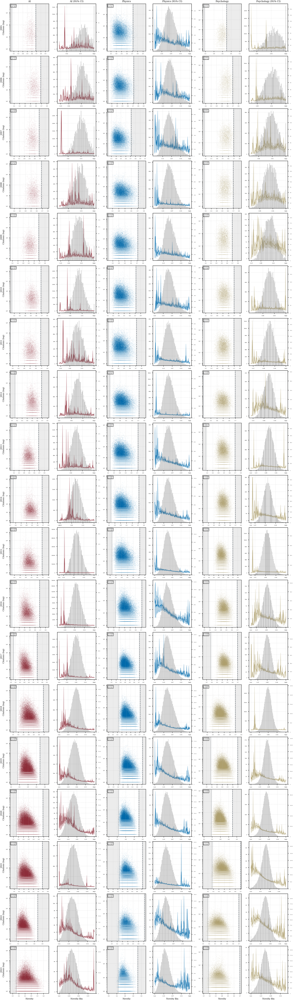

In [128]:
# Fixed-width binning analysis broken down BY YEAR
def compute_fixed_width_bins_by_year(df, n_bins=100, low_percentile=1, high_percentile=99, 
                                      collect_edge_bins=True, n_bootstrap=1000, ci=95):
    """Compute citation statistics using fixed-width novelty bins PER FIELD PER YEAR."""
    fields = ['AI', 'Physics', 'Psychology']
    df_clean = df[[NOVELTY_COL, CITATION_COL, 'field', 'publication_year']].dropna().copy()
    
    all_stats = []
    field_cutoffs = {}
    field_bin_edges = {}
    
    # Get unique years
    years = sorted(df_clean['publication_year'].unique())
    
    for field in fields:
        field_data = df_clean[df_clean['field'] == field].copy()
        if len(field_data) == 0:
            continue
        
        # Calculate cutoffs PER FIELD (across all years for consistency)
        low_cutoff = field_data[NOVELTY_COL].quantile(low_percentile / 100)
        high_cutoff = field_data[NOVELTY_COL].quantile(high_percentile / 100)
        
        field_cutoffs[field] = (low_cutoff, high_cutoff)
        
        print(f"\n{field} - Cutoffs based on P{low_percentile} and P{high_percentile}:")
        print(f"  Low cutoff (P{low_percentile}): {low_cutoff:.6f}")
        print(f"  High cutoff (P{high_percentile}): {high_cutoff:.6f}")
        
        if collect_edge_bins:
            main_bin_edges = np.linspace(low_cutoff, high_cutoff, n_bins + 1)
        else:
            data_min = field_data[NOVELTY_COL].min()
            data_max = field_data[NOVELTY_COL].max()
            main_bin_edges = np.linspace(data_min, data_max, n_bins + 1)
        
        field_bin_edges[field] = main_bin_edges
        
        # Process each year
        for year in years:
            year_data = field_data[field_data['publication_year'] == year].copy()
            if len(year_data) == 0:
                continue
            
            if collect_edge_bins:
                def assign_bin(x):
                    if x < low_cutoff:
                        return -1
                    elif x > high_cutoff:
                        return n_bins
                    else:
                        bin_idx = np.searchsorted(main_bin_edges, x, side='right') - 1
                        return max(0, min(n_bins - 1, bin_idx))
            else:
                def assign_bin(x):
                    bin_idx = np.searchsorted(main_bin_edges, x, side='right') - 1
                    return max(0, min(n_bins - 1, bin_idx))
            
            year_data['novelty_bin'] = year_data[NOVELTY_COL].apply(assign_bin)
            
            if collect_edge_bins:
                low_edge_data = year_data[year_data['novelty_bin'] == -1]
                if len(low_edge_data) > 0:
                    citations = low_edge_data[CITATION_COL]
                    novelty_vals = low_edge_data[NOVELTY_COL]
                    ci_lower, ci_upper, citation_mean = bootstrap_ci(citations.values, n_bootstrap=n_bootstrap, ci=ci)
                    n = len(low_edge_data)
                    std = citations.std()
                    sem = std / np.sqrt(n) if n > 0 else np.nan
                    all_stats.append({
                        'field': field,
                        'year': year,
                        'bin': -1,
                        'bin_label': f'<{low_cutoff:.3f}',
                        'bin_center': field_data[NOVELTY_COL].min() + (low_cutoff - field_data[NOVELTY_COL].min()) / 2,
                        'novelty_avg': novelty_vals.mean(),
                        'citation_mean': citation_mean,
                        'citation_median': citations.median(),
                        'citation_std': std,
                        'citation_sem': sem,
                        'ci_lower': ci_lower,
                        'ci_upper': ci_upper,
                        'count': n
                    })
            
            for bin_num in range(n_bins):
                bin_data = year_data[year_data['novelty_bin'] == bin_num]
                if len(bin_data) > 0:
                    citations = bin_data[CITATION_COL]
                    novelty_vals = bin_data[NOVELTY_COL]
                    bin_center = (main_bin_edges[bin_num] + main_bin_edges[bin_num + 1]) / 2
                    ci_lower, ci_upper, citation_mean = bootstrap_ci(citations.values, n_bootstrap=n_bootstrap, ci=ci)
                    n = len(bin_data)
                    std = citations.std()
                    sem = std / np.sqrt(n) if n > 0 else np.nan
                    
                    all_stats.append({
                        'field': field,
                        'year': year,
                        'bin': bin_num,
                        'bin_label': f'{main_bin_edges[bin_num]:.4f}',
                        'bin_center': bin_center,
                        'novelty_avg': novelty_vals.mean(),
                        'citation_mean': citation_mean,
                        'citation_median': citations.median(),
                        'citation_std': std,
                        'citation_sem': sem,
                        'ci_lower': ci_lower,
                        'ci_upper': ci_upper,
                        'count': n
                    })
            
            if collect_edge_bins:
                high_edge_data = year_data[year_data['novelty_bin'] == n_bins]
                if len(high_edge_data) > 0:
                    citations = high_edge_data[CITATION_COL]
                    novelty_vals = high_edge_data[NOVELTY_COL]
                    ci_lower, ci_upper, citation_mean = bootstrap_ci(citations.values, n_bootstrap=n_bootstrap, ci=ci)
                    n = len(high_edge_data)
                    std = citations.std()
                    sem = std / np.sqrt(n) if n > 0 else np.nan
                    all_stats.append({
                        'field': field,
                        'year': year,
                        'bin': n_bins,
                        'bin_label': f'>{high_cutoff:.3f}',
                        'bin_center': high_cutoff + (field_data[NOVELTY_COL].max() - high_cutoff) / 2,
                        'novelty_avg': novelty_vals.mean(),
                        'citation_mean': citation_mean,
                        'citation_median': citations.median(),
                        'citation_std': std,
                        'citation_sem': sem,
                        'ci_lower': ci_lower,
                        'ci_upper': ci_upper,
                        'count': n
                    })
    
    return pd.DataFrame(all_stats), field_bin_edges, field_cutoffs, years


def plot_fixed_width_bins_by_year(df, n_bins=100, low_percentile=1, high_percentile=99, 
                                   collect_edge_bins=True, error_type='ci', use_fill=True,
                                   title_suffix='', n_bootstrap=1000, ci=95):
    """Plot mean citations vs novelty with flexible error visualization BY YEAR using tueplots."""
    from scipy import stats as scipy_stats
    from tueplots import bundles
    from tueplots.constants.color import rgb
    
    fields = ['AI', 'Physics', 'Psychology']
    
    # Convert rgb tuples to proper color format
    color_red = tuple(rgb.tue_red)
    color_blue = tuple(rgb.tue_blue)
    color_gold = tuple(rgb.tue_gold)
    color_gray = (0.4, 0.4, 0.4)
    color_dark = tuple(rgb.tue_dark) if hasattr(rgb, 'tue_dark') else (0.2, 0.2, 0.2)
    
    colors = {
        'AI': color_red,
        'Physics': color_blue,
        'Psychology': color_gold
    }
    
    # Compute fixed-width bin statistics (now per field per year)
    stats_df, field_bin_edges, field_cutoffs, years = compute_fixed_width_bins_by_year(
        df, n_bins=n_bins, low_percentile=low_percentile, high_percentile=high_percentile,
        collect_edge_bins=collect_edge_bins, n_bootstrap=n_bootstrap, ci=ci
    )
    
    years = sorted([int(y) for y in years])
    n_years = len(years)
    
    # Prepare scatter data
    df_clean = df[[NOVELTY_COL, CITATION_COL, 'field', 'publication_year']].dropna().copy()
    
    # Calculate grid dimensions: n_years rows x 2 columns (scatter, mean plot) for each field
    # Or: 3 fields x n_years subplots
    # Let's do: rows = n_years, cols = 6 (2 per field: scatter + mean)
    # Better: rows = n_years, cols = 6 where cols 0,1 = AI; cols 2,3 = Physics; cols 4,5 = Psychology
    
    # Apply tueplots ICML 2024 style
    plt.rcParams.update(bundles.icml2024(column="full", nrows=n_years, ncols=6))
    plt.rcParams['text.usetex'] = False
    fig, axes = plt.subplots(n_years, 6, figsize=(14, 2.5*n_years), layout='constrained')
    
    # If only 1 year, axes won't be 2D
    if n_years == 1:
        axes = axes.reshape(1, -1)
    
    for year_idx, year in enumerate(years):
        year_scatter_data = df_clean[df_clean['publication_year'] == year]
        
        for field_idx, field in enumerate(fields):
            field_stats = stats_df[(stats_df['field'] == field) & (stats_df['year'] == year)].sort_values('bin')
            field_scatter = year_scatter_data[year_scatter_data['field'] == field].copy()
            
            col_scatter = field_idx * 2
            col_mean = field_idx * 2 + 1
            
            ax_left = axes[year_idx, col_scatter]
            ax_right = axes[year_idx, col_mean]
            
            if len(field_stats) == 0 or len(field_scatter) == 0:
                ax_left.text(0.5, 0.5, 'No data', ha='center', va='center', transform=ax_left.transAxes)
                ax_right.text(0.5, 0.5, 'No data', ha='center', va='center', transform=ax_right.transAxes)
                continue
            
            # Get field-specific cutoffs and bin edges
            low_cutoff, high_cutoff = field_cutoffs[field]
            main_bin_edges = field_bin_edges[field]
            
            # Assign bins to scatter data
            if collect_edge_bins:
                def assign_bin(x):
                    if x < low_cutoff:
                        return -1
                    elif x > high_cutoff:
                        return n_bins
                    else:
                        bin_idx = np.searchsorted(main_bin_edges, x, side='right') - 1
                        return max(0, min(n_bins - 1, bin_idx))
            else:
                def assign_bin(x):
                    bin_idx = np.searchsorted(main_bin_edges, x, side='right') - 1
                    return max(0, min(n_bins - 1, bin_idx))
            
            field_scatter['novelty_bin'] = field_scatter[NOVELTY_COL].apply(assign_bin)
            
            # LEFT: Scatter plot
            scatter = ax_left.scatter(
                field_scatter[NOVELTY_COL], 
                field_scatter[CITATION_COL],
                c=colors[field],
                alpha=0.4,
                s=0.5,
                edgecolors='none',
                rasterized=True
            )
            
            if collect_edge_bins:
                ax_left.axvline(x=low_cutoff, color=color_dark, alpha=0.9, linewidth=1.2, linestyle=':', zorder=5)
                ax_left.axvline(x=high_cutoff, color=color_dark, alpha=0.9, linewidth=1.2, linestyle='--', zorder=5)
                xlim = ax_left.get_xlim()
                ax_left.axvspan(xlim[0], low_cutoff, alpha=0.12, color=color_gray)
                ax_left.axvspan(high_cutoff, xlim[1], alpha=0.12, color=color_gray)
                ax_left.set_xlim(xlim)
            
            # Title: Field name only on first row
            if year_idx == 0:
                ax_left.set_title(f'{field}', fontsize=8)
            
            # Year label on left side (only for first column)
            if field_idx == 0:
                ax_left.set_ylabel(f'{int(year)}\nCitations (log)', fontsize=7)
            
            ax_left.set_yscale('log')
            ax_left.grid(True, alpha=0.3, linestyle='--')
            
            # Correlation
            if len(field_scatter) > 2:
                corr, p_value = scipy_stats.pearsonr(field_scatter[NOVELTY_COL], field_scatter[CITATION_COL])
                p_str = 'p<0.001' if p_value < 0.001 else f'p={p_value:.3f}'
                ax_left.text(0.02, 0.98, f'r={corr:.3f}\n{p_str}', transform=ax_left.transAxes, 
                            fontsize=4, va='top', ha='left', 
                            bbox=dict(boxstyle='round', facecolor='white', alpha=0.8, pad=0.2))
            
            # RIGHT: Mean citations with error visualization
            ax_right_twin = ax_right.twinx()
            
            x_positions = np.arange(len(field_stats))
            mean_vals = field_stats['citation_mean'].values
            bin_nums = field_stats['bin'].values
            count_vals = field_stats['count'].values
            
            # Determine error bounds
            if error_type == 'std':
                error_lower = mean_vals - field_stats['citation_std'].values
                error_upper = mean_vals + field_stats['citation_std'].values
                error_label = '±1 STD'
            elif error_type == 'sem':
                error_lower = mean_vals - field_stats['citation_sem'].values
                error_upper = mean_vals + field_stats['citation_sem'].values
                error_label = '±1 SEM'
            else:  # 'ci'
                error_lower = field_stats['ci_lower'].values
                error_upper = field_stats['ci_upper'].values
                error_label = f'{ci}% CI'
            
            # Draw line with field color
            ax_right.plot(x_positions, mean_vals, color=colors[field], linewidth=1.0)
            ax_right.scatter(x_positions, mean_vals, c=[colors[field]], s=3, zorder=5, 
                            edgecolors='white', linewidth=0.2)
            
            # Error visualization
            if use_fill:
                ax_right.fill_between(x_positions, error_lower, error_upper, 
                                      alpha=0.3, color=colors[field], label=error_label)
            else:
                if error_type == 'ci':
                    yerr_lower = mean_vals - error_lower
                    yerr_upper = error_upper - mean_vals
                    ax_right.errorbar(x_positions, mean_vals, yerr=[yerr_lower, yerr_upper],
                                     fmt='none', color=colors[field], alpha=0.6, 
                                     capsize=1, capthick=0.5, label=error_label)
                else:
                    ax_right.errorbar(x_positions, mean_vals, yerr=error_vals,
                                     fmt='none', color=colors[field], alpha=0.6, 
                                     capsize=1, capthick=0.5, label=error_label)
            
            # Paper count bars
            bar_width = 0.8
            ax_right_twin.bar(x_positions, count_vals, alpha=0.35, color=color_gray, width=bar_width)
            
            # X-tick labels
            tick_positions = []
            tick_labels = []
            
            if collect_edge_bins:
                low_edge_pos = np.where(bin_nums == -1)[0]
                high_edge_pos = np.where(bin_nums == n_bins)[0]
                
                if len(low_edge_pos) > 0:
                    tick_positions.append(low_edge_pos[0])
                    tick_labels.append('Low')
                
                main_bin_positions = np.where((bin_nums >= 0) & (bin_nums < n_bins))[0]
                if len(main_bin_positions) > 0:
                    for i, pos in enumerate(main_bin_positions[1:]):
                        if bin_nums[pos] == 0 or bin_nums[pos] % 25 == 0:
                            tick_positions.append(pos)
                            tick_labels.append(f'{main_bin_edges[bin_nums[pos]]:.2f}')
                
                if len(high_edge_pos) > 0:
                    tick_positions.append(high_edge_pos[0])
                    tick_labels.append('High')
            else:
                interval = max(1, len(x_positions) // 5)
                for i in range(0, len(x_positions), interval):
                    tick_positions.append(i)
                    tick_labels.append(f'{main_bin_edges[bin_nums[i]]:.2f}')
            
            ax_right.set_xticks(tick_positions)
            ax_right.set_xticklabels(tick_labels, rotation=0, ha='center', fontsize=4)
            
            if year_idx == 0:
                ax_right.set_title(f'{field} ({error_label})', fontsize=8)
            
            ax_right_twin.tick_params(axis='y', labelcolor=color_gray, labelsize=4)
            ax_right.tick_params(axis='y', labelsize=4)
            ax_left.tick_params(axis='both', labelsize=4)
            ax_right.grid(True, alpha=0.3, linestyle='--')
    
    # Add common x-axis labels only for bottom row
    for col in range(0, 6, 2):
        axes[-1, col].set_xlabel('Novelty', fontsize=7)
        axes[-1, col+1].set_xlabel('Novelty Bin', fontsize=7)
    
    plt.savefig("fixed_width_bins_by_year.pdf", dpi=150, bbox_inches='tight')
    return fig, stats_df


# Run the by-year plot
print("=== Citation vs Novelty: By Year Analysis ===")
fig_by_year, stats_by_year = plot_fixed_width_bins_by_year(
    merged_df, 
    n_bins=100, 
    low_percentile=0.1,
    high_percentile=99.9,
    collect_edge_bins=True,
    error_type='ci',
    use_fill=True,
    n_bootstrap=1000,
    ci=95
)

=== Citation vs Novelty: CUMULATIVE Up To Each Year ===

AI - Cutoffs based on P0.1 and P99.9:
  Low cutoff (P0.1): 0.156730
  High cutoff (P99.9): 0.683789

Physics - Cutoffs based on P0.1 and P99.9:
  Low cutoff (P0.1): 0.231695
  High cutoff (P99.9): 0.711838

Psychology - Cutoffs based on P0.1 and P99.9:
  Low cutoff (P0.1): 0.177501
  High cutoff (P99.9): 0.693996


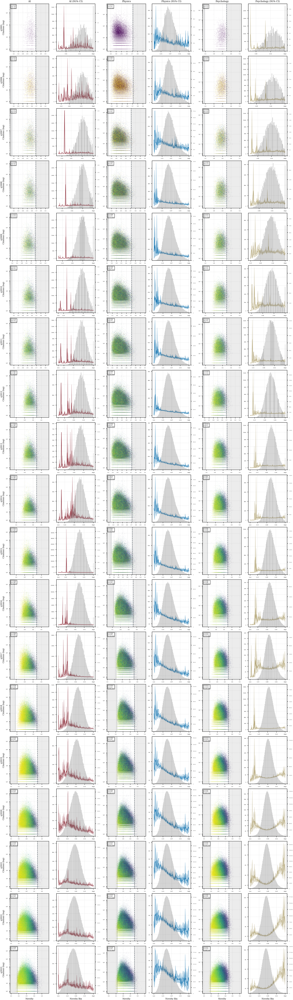

In [129]:
# Fixed-width binning analysis - CUMULATIVE UP TO EACH YEAR
def compute_fixed_width_bins_cumulative(df, n_bins=100, low_percentile=1, high_percentile=99, 
                                         collect_edge_bins=True, n_bootstrap=1000, ci=95):
    """Compute citation statistics using fixed-width novelty bins PER FIELD, CUMULATIVE UP TO EACH YEAR."""
    fields = ['AI', 'Physics', 'Psychology']
    df_clean = df[[NOVELTY_COL, CITATION_COL, 'field', 'publication_year']].dropna().copy()
    
    all_stats = []
    field_cutoffs = {}
    field_bin_edges = {}
    
    # Get unique years
    years = sorted(df_clean['publication_year'].unique())
    
    for field in fields:
        field_data = df_clean[df_clean['field'] == field].copy()
        if len(field_data) == 0:
            continue
        
        # Calculate cutoffs PER FIELD (across all years for consistency)
        low_cutoff = field_data[NOVELTY_COL].quantile(low_percentile / 100)
        high_cutoff = field_data[NOVELTY_COL].quantile(high_percentile / 100)
        
        field_cutoffs[field] = (low_cutoff, high_cutoff)
        
        print(f"\n{field} - Cutoffs based on P{low_percentile} and P{high_percentile}:")
        print(f"  Low cutoff (P{low_percentile}): {low_cutoff:.6f}")
        print(f"  High cutoff (P{high_percentile}): {high_cutoff:.6f}")
        
        if collect_edge_bins:
            main_bin_edges = np.linspace(low_cutoff, high_cutoff, n_bins + 1)
        else:
            data_min = field_data[NOVELTY_COL].min()
            data_max = field_data[NOVELTY_COL].max()
            main_bin_edges = np.linspace(data_min, data_max, n_bins + 1)
        
        field_bin_edges[field] = main_bin_edges
        
        # Process CUMULATIVE data up to each year
        for year in years:
            # CUMULATIVE: include all data up to and including this year
            cumulative_data = field_data[field_data['publication_year'] <= year].copy()
            if len(cumulative_data) == 0:
                continue
            
            if collect_edge_bins:
                def assign_bin(x):
                    if x < low_cutoff:
                        return -1
                    elif x > high_cutoff:
                        return n_bins
                    else:
                        bin_idx = np.searchsorted(main_bin_edges, x, side='right') - 1
                        return max(0, min(n_bins - 1, bin_idx))
            else:
                def assign_bin(x):
                    bin_idx = np.searchsorted(main_bin_edges, x, side='right') - 1
                    return max(0, min(n_bins - 1, bin_idx))
            
            cumulative_data['novelty_bin'] = cumulative_data[NOVELTY_COL].apply(assign_bin)
            
            if collect_edge_bins:
                low_edge_data = cumulative_data[cumulative_data['novelty_bin'] == -1]
                if len(low_edge_data) > 0:
                    citations = low_edge_data[CITATION_COL]
                    novelty_vals = low_edge_data[NOVELTY_COL]
                    ci_lower, ci_upper, citation_mean = bootstrap_ci(citations.values, n_bootstrap=n_bootstrap, ci=ci)
                    n = len(low_edge_data)
                    std = citations.std()
                    sem = std / np.sqrt(n) if n > 0 else np.nan
                    all_stats.append({
                        'field': field,
                        'year': year,
                        'bin': -1,
                        'bin_label': f'<{low_cutoff:.3f}',
                        'bin_center': field_data[NOVELTY_COL].min() + (low_cutoff - field_data[NOVELTY_COL].min()) / 2,
                        'novelty_avg': novelty_vals.mean(),
                        'citation_mean': citation_mean,
                        'citation_median': citations.median(),
                        'citation_std': std,
                        'citation_sem': sem,
                        'ci_lower': ci_lower,
                        'ci_upper': ci_upper,
                        'count': n
                    })
            
            for bin_num in range(n_bins):
                bin_data = cumulative_data[cumulative_data['novelty_bin'] == bin_num]
                if len(bin_data) > 0:
                    citations = bin_data[CITATION_COL]
                    novelty_vals = bin_data[NOVELTY_COL]
                    bin_center = (main_bin_edges[bin_num] + main_bin_edges[bin_num + 1]) / 2
                    ci_lower, ci_upper, citation_mean = bootstrap_ci(citations.values, n_bootstrap=n_bootstrap, ci=ci)
                    n = len(bin_data)
                    std = citations.std()
                    sem = std / np.sqrt(n) if n > 0 else np.nan
                    
                    all_stats.append({
                        'field': field,
                        'year': year,
                        'bin': bin_num,
                        'bin_label': f'{main_bin_edges[bin_num]:.4f}',
                        'bin_center': bin_center,
                        'novelty_avg': novelty_vals.mean(),
                        'citation_mean': citation_mean,
                        'citation_median': citations.median(),
                        'citation_std': std,
                        'citation_sem': sem,
                        'ci_lower': ci_lower,
                        'ci_upper': ci_upper,
                        'count': n
                    })
            
            if collect_edge_bins:
                high_edge_data = cumulative_data[cumulative_data['novelty_bin'] == n_bins]
                if len(high_edge_data) > 0:
                    citations = high_edge_data[CITATION_COL]
                    novelty_vals = high_edge_data[NOVELTY_COL]
                    ci_lower, ci_upper, citation_mean = bootstrap_ci(citations.values, n_bootstrap=n_bootstrap, ci=ci)
                    n = len(high_edge_data)
                    std = citations.std()
                    sem = std / np.sqrt(n) if n > 0 else np.nan
                    all_stats.append({
                        'field': field,
                        'year': year,
                        'bin': n_bins,
                        'bin_label': f'>{high_cutoff:.3f}',
                        'bin_center': high_cutoff + (field_data[NOVELTY_COL].max() - high_cutoff) / 2,
                        'novelty_avg': novelty_vals.mean(),
                        'citation_mean': citation_mean,
                        'citation_median': citations.median(),
                        'citation_std': std,
                        'citation_sem': sem,
                        'ci_lower': ci_lower,
                        'ci_upper': ci_upper,
                        'count': n
                    })
    
    return pd.DataFrame(all_stats), field_bin_edges, field_cutoffs, years


def plot_fixed_width_bins_cumulative(df, n_bins=100, low_percentile=1, high_percentile=99, 
                                      collect_edge_bins=True, error_type='ci', use_fill=True,
                                      title_suffix='', n_bootstrap=1000, ci=95):
    """Plot mean citations vs novelty - CUMULATIVE UP TO EACH YEAR using tueplots."""
    from scipy import stats as scipy_stats
    from tueplots import bundles
    from tueplots.constants.color import rgb
    
    fields = ['AI', 'Physics', 'Psychology']
    
    # Convert rgb tuples to proper color format
    color_red = tuple(rgb.tue_red)
    color_blue = tuple(rgb.tue_blue)
    color_gold = tuple(rgb.tue_gold)
    color_gray = (0.4, 0.4, 0.4)
    color_dark = tuple(rgb.tue_dark) if hasattr(rgb, 'tue_dark') else (0.2, 0.2, 0.2)
    
    colors = {
        'AI': color_red,
        'Physics': color_blue,
        'Psychology': color_gold
    }
    
    # Compute fixed-width bin statistics (cumulative up to each year)
    stats_df, field_bin_edges, field_cutoffs, years = compute_fixed_width_bins_cumulative(
        df, n_bins=n_bins, low_percentile=low_percentile, high_percentile=high_percentile,
        collect_edge_bins=collect_edge_bins, n_bootstrap=n_bootstrap, ci=ci
    )
    
    years = sorted([int(y) for y in years])
    n_years = len(years)
    
    # Prepare scatter data
    df_clean = df[[NOVELTY_COL, CITATION_COL, 'field', 'publication_year']].dropna().copy()
    
    # Apply tueplots ICML 2024 style
    plt.rcParams.update(bundles.icml2024(column="full", nrows=n_years, ncols=6))
    plt.rcParams['text.usetex'] = False
    fig, axes = plt.subplots(n_years, 6, figsize=(14, 2.5*n_years), layout='constrained')
    
    # If only 1 year, axes won't be 2D
    if n_years == 1:
        axes = axes.reshape(1, -1)
    
    for year_idx, year in enumerate(years):
        # CUMULATIVE: include all data up to and including this year
        cumulative_scatter_data = df_clean[df_clean['publication_year'] <= year]
        
        for field_idx, field in enumerate(fields):
            field_stats = stats_df[(stats_df['field'] == field) & (stats_df['year'] == year)].sort_values('bin')
            field_scatter = cumulative_scatter_data[cumulative_scatter_data['field'] == field].copy()
            
            col_scatter = field_idx * 2
            col_mean = field_idx * 2 + 1
            
            ax_left = axes[year_idx, col_scatter]
            ax_right = axes[year_idx, col_mean]
            
            if len(field_stats) == 0 or len(field_scatter) == 0:
                ax_left.text(0.5, 0.5, 'No data', ha='center', va='center', transform=ax_left.transAxes)
                ax_right.text(0.5, 0.5, 'No data', ha='center', va='center', transform=ax_right.transAxes)
                continue
            
            # Get field-specific cutoffs and bin edges
            low_cutoff, high_cutoff = field_cutoffs[field]
            main_bin_edges = field_bin_edges[field]
            
            # Assign bins to scatter data
            if collect_edge_bins:
                def assign_bin(x):
                    if x < low_cutoff:
                        return -1
                    elif x > high_cutoff:
                        return n_bins
                    else:
                        bin_idx = np.searchsorted(main_bin_edges, x, side='right') - 1
                        return max(0, min(n_bins - 1, bin_idx))
            else:
                def assign_bin(x):
                    bin_idx = np.searchsorted(main_bin_edges, x, side='right') - 1
                    return max(0, min(n_bins - 1, bin_idx))
            
            field_scatter['novelty_bin'] = field_scatter[NOVELTY_COL].apply(assign_bin)
            
            # LEFT: Scatter plot - color by publication year within cumulative data
            year_min = df_clean['publication_year'].min()
            year_norm = plt.Normalize(year_min, year)
            
            scatter = ax_left.scatter(
                field_scatter[NOVELTY_COL], 
                field_scatter[CITATION_COL],
                c=field_scatter['publication_year'],
                cmap='viridis',
                norm=year_norm,
                alpha=0.4,
                s=0.5,
                edgecolors='none',
                rasterized=True
            )
            
            if collect_edge_bins:
                ax_left.axvline(x=low_cutoff, color=color_dark, alpha=0.9, linewidth=1.2, linestyle=':', zorder=5)
                ax_left.axvline(x=high_cutoff, color=color_dark, alpha=0.9, linewidth=1.2, linestyle='--', zorder=5)
                xlim = ax_left.get_xlim()
                ax_left.axvspan(xlim[0], low_cutoff, alpha=0.12, color=color_gray)
                ax_left.axvspan(high_cutoff, xlim[1], alpha=0.12, color=color_gray)
                ax_left.set_xlim(xlim)
            
            # Title: Field name only on first row
            if year_idx == 0:
                ax_left.set_title(f'{field}', fontsize=8)
            
            # Year label on left side (only for first column) - show cumulative range
            if field_idx == 0:
                ax_left.set_ylabel(f'≤{int(year)}\nCitations (log)', fontsize=7)
            
            ax_left.set_yscale('log')
            ax_left.grid(True, alpha=0.3, linestyle='--')
            
            # Correlation
            if len(field_scatter) > 2:
                corr, p_value = scipy_stats.pearsonr(field_scatter[NOVELTY_COL], field_scatter[CITATION_COL])
                p_str = 'p<0.001' if p_value < 0.001 else f'p={p_value:.3f}'
                ax_left.text(0.02, 0.98, f'r={corr:.3f}\n{p_str}\nn={len(field_scatter):,}', 
                            transform=ax_left.transAxes, 
                            fontsize=4, va='top', ha='left', 
                            bbox=dict(boxstyle='round', facecolor='white', alpha=0.8, pad=0.2))
            
            # RIGHT: Mean citations with error visualization
            ax_right_twin = ax_right.twinx()
            
            x_positions = np.arange(len(field_stats))
            mean_vals = field_stats['citation_mean'].values
            bin_nums = field_stats['bin'].values
            count_vals = field_stats['count'].values
            
            # Determine error bounds
            if error_type == 'std':
                error_lower = mean_vals - field_stats['citation_std'].values
                error_upper = mean_vals + field_stats['citation_std'].values
                error_label = '±1 STD'
            elif error_type == 'sem':
                error_lower = mean_vals - field_stats['citation_sem'].values
                error_upper = mean_vals + field_stats['citation_sem'].values
                error_label = '±1 SEM'
            else:  # 'ci'
                error_lower = field_stats['ci_lower'].values
                error_upper = field_stats['ci_upper'].values
                error_label = f'{ci}% CI'
            
            # Draw line with field color
            ax_right.plot(x_positions, mean_vals, color=colors[field], linewidth=1.0)
            ax_right.scatter(x_positions, mean_vals, c=[colors[field]], s=3, zorder=5, 
                            edgecolors='white', linewidth=0.2)
            
            # Error visualization
            if use_fill:
                ax_right.fill_between(x_positions, error_lower, error_upper, 
                                      alpha=0.3, color=colors[field], label=error_label)
            else:
                if error_type == 'ci':
                    yerr_lower = mean_vals - error_lower
                    yerr_upper = error_upper - mean_vals
                    ax_right.errorbar(x_positions, mean_vals, yerr=[yerr_lower, yerr_upper],
                                     fmt='none', color=colors[field], alpha=0.6, 
                                     capsize=1, capthick=0.5, label=error_label)
                else:
                    ax_right.errorbar(x_positions, mean_vals, yerr=error_vals,
                                     fmt='none', color=colors[field], alpha=0.6, 
                                     capsize=1, capthick=0.5, label=error_label)
            
            # Paper count bars
            bar_width = 0.8
            ax_right_twin.bar(x_positions, count_vals, alpha=0.35, color=color_gray, width=bar_width)
            
            # X-tick labels
            tick_positions = []
            tick_labels = []
            
            if collect_edge_bins:
                low_edge_pos = np.where(bin_nums == -1)[0]
                high_edge_pos = np.where(bin_nums == n_bins)[0]
                
                if len(low_edge_pos) > 0:
                    tick_positions.append(low_edge_pos[0])
                    tick_labels.append('Low')
                
                main_bin_positions = np.where((bin_nums >= 0) & (bin_nums < n_bins))[0]
                if len(main_bin_positions) > 0:
                    for i, pos in enumerate(main_bin_positions[1:]):
                        if bin_nums[pos] == 0 or bin_nums[pos] % 25 == 0:
                            tick_positions.append(pos)
                            tick_labels.append(f'{main_bin_edges[bin_nums[pos]]:.2f}')
                
                if len(high_edge_pos) > 0:
                    tick_positions.append(high_edge_pos[0])
                    tick_labels.append('High')
            else:
                interval = max(1, len(x_positions) // 5)
                for i in range(0, len(x_positions), interval):
                    tick_positions.append(i)
                    tick_labels.append(f'{main_bin_edges[bin_nums[i]]:.2f}')
            
            ax_right.set_xticks(tick_positions)
            ax_right.set_xticklabels(tick_labels, rotation=0, ha='center', fontsize=4)
            
            if year_idx == 0:
                ax_right.set_title(f'{field} ({error_label})', fontsize=8)
            
            ax_right_twin.tick_params(axis='y', labelcolor=color_gray, labelsize=4)
            ax_right.tick_params(axis='y', labelsize=4)
            ax_left.tick_params(axis='both', labelsize=4)
            ax_right.grid(True, alpha=0.3, linestyle='--')
    
    # Add common x-axis labels only for bottom row
    for col in range(0, 6, 2):
        axes[-1, col].set_xlabel('Novelty', fontsize=7)
        axes[-1, col+1].set_xlabel('Novelty Bin', fontsize=7)
    
    plt.savefig("fixed_width_bins_cumulative.pdf", dpi=150, bbox_inches='tight')
    return fig, stats_df


# Run the cumulative plot
print("=== Citation vs Novelty: CUMULATIVE Up To Each Year ===")
fig_cumulative, stats_cumulative = plot_fixed_width_bins_cumulative(
    merged_df, 
    n_bins=100, 
    low_percentile=0.1,
    high_percentile=99.9,
    collect_edge_bins=True,
    error_type='ci',
    use_fill=True,
    n_bootstrap=1000,
    ci=95
)

In [113]:
def quantify_polynomial_fit(stats_df, field, degree=2):
    """Fit polynomial and extract key metrics."""
    from sklearn.metrics import r2_score
    from scipy.optimize import minimize_scalar
    
    field_data = stats_df[stats_df['field'] == field].copy()
    # Exclude edge bins for cleaner fit
    field_data = field_data[(field_data['bin'] >= 0) & (field_data['bin'] < 100)]
    
    x = field_data['bin_center'].values
    y = field_data['citation_mean'].values
    weights = np.sqrt(field_data['count'].values)  # Weight by sample size
    
    # Fit weighted polynomial
    coeffs = np.polyfit(x, y, degree, w=weights)
    poly_fn = np.poly1d(coeffs)
    
    # Calculate R²
    y_pred = poly_fn(x)
    r2 = r2_score(y, y_pred)
    
    # Find optimal novelty (peak for inverted-U)
    if degree == 2 and coeffs[0] < 0:  # Inverted-U
        optimal_novelty = -coeffs[1] / (2 * coeffs[0])
        peak_citations = poly_fn(optimal_novelty)
    else:
        optimal_novelty = None
        peak_citations = None
    
    return {
        'field': field,
        'coefficients': coeffs,
        'r_squared': r2,
        'optimal_novelty': optimal_novelty,
        'peak_citations': peak_citations,
        'shape': 'inverted_U' if (degree == 2 and coeffs[0] < 0) else 'other'
    }

# Usage:
for field in ['AI', 'Physics', 'Psychology']:
    fit = quantify_polynomial_fit(stats_fixed, field)
    print(f"\n{field}:")
    print(f"  R² = {fit['r_squared']:.3f}")
    if fit['optimal_novelty']:
        print(f"  Peak at novelty = {fit['optimal_novelty']:.4f}")
        print(f"  Peak citations = {fit['peak_citations']:.1f}")


AI:
  R² = 0.149
  Peak at novelty = 0.0968
  Peak citations = 52.8

Physics:
  R² = 0.559

Psychology:
  R² = 0.880


In [114]:
def characterize_peak(stats_df, field):
    """Find and characterize the citation peak."""
    field_data = stats_df[stats_df['field'] == field].copy()
    field_data = field_data[(field_data['bin'] >= 0) & (field_data['bin'] < 100)]
    
    # Find peak
    peak_idx = field_data['citation_mean'].idxmax()
    peak_row = field_data.loc[peak_idx]
    
    # Baseline (first 10 bins average)
    baseline = field_data.head(10)['citation_mean'].mean()
    
    # Peak characteristics
    peak_lift = peak_row['citation_mean'] / baseline
    peak_novelty = peak_row['novelty_avg']
    
    # Peak width (FWHM - Full Width at Half Maximum)
    half_max = baseline + (peak_row['citation_mean'] - baseline) / 2
    above_half = field_data[field_data['citation_mean'] >= half_max]
    if len(above_half) > 1:
        width = above_half['novelty_avg'].max() - above_half['novelty_avg'].min()
    else:
        width = None
    
    return {
        'field': field,
        'peak_novelty': peak_novelty,
        'peak_citations': peak_row['citation_mean'],
        'baseline_citations': baseline,
        'peak_lift': peak_lift,
        'peak_width': width,
        'peak_ci_lower': peak_row['ci_lower'],
        'peak_ci_upper': peak_row['ci_upper']
    }

# Usage:
peak_metrics = []
for field in ['AI', 'Physics', 'Psychology']:
    metrics = characterize_peak(stats_fixed, field)
    peak_metrics.append(metrics)
    print(f"\n{field} Peak:")
    print(f"  Location: {metrics['peak_novelty']:.4f}")
    print(f"  Citations: {metrics['peak_citations']:.1f} "
          f"[{metrics['peak_ci_lower']:.1f}, {metrics['peak_ci_upper']:.1f}]")
    print(f"  Lift over baseline: {metrics['peak_lift']:.2f}x")
    if metrics['peak_width']:
        print(f"  Width (FWHM): {metrics['peak_width']:.4f}")

peak_df = pd.DataFrame(peak_metrics)


AI Peak:
  Location: 0.3017
  Citations: 73.7 [42.9, 128.2]
  Lift over baseline: 2.09x
  Width (FWHM): 0.0474

Physics Peak:
  Location: 0.2726
  Citations: 37.5 [31.8, 45.4]
  Lift over baseline: 1.15x
  Width (FWHM): 0.1055

Psychology Peak:
  Location: 0.6708
  Citations: 74.2 [51.6, 101.9]
  Lift over baseline: 3.48x
  Width (FWHM): 0.1085


In [117]:
def analyze_tail_behavior(stats_df, field, threshold_novelty=0.08):
    """Analyze behavior in high-novelty region."""
    from scipy.stats import linregress
    
    field_data = stats_df[stats_df['field'] == field].copy()
    
    # Split at threshold
    before = field_data[field_data['novelty_avg'] < threshold_novelty]
    after = field_data[field_data['novelty_avg'] >= threshold_novelty]
    
    # Fit linear regression to each segment
    if len(before) > 2:
        slope_before, intercept_before, r_before, p_before, _ = \
            linregress(before['novelty_avg'], before['citation_mean'])
    else:
        slope_before, r_before = None, None
    
    if len(after) > 2:
        slope_after, intercept_after, r_after, p_after, _ = \
            linregress(after['novelty_avg'], after['citation_mean'])
    else:
        slope_after, r_after = None, None
    
    return {
        'field': field,
        'threshold': threshold_novelty,
        'slope_before': slope_before,
        'r2_before': r_before**2 if r_before else None,
        'slope_after': slope_after,
        'r2_after': r_after**2 if r_after else None,
        'slope_ratio': slope_after / slope_before if (slope_before and slope_after) else None
    }

# For Psychology specifically:
psych_tail = analyze_tail_behavior(stats_fixed, 'Psychology', threshold_novelty=0.08)
print(f"\nPsychology Threshold Analysis:")
# print(f"  Below {psych_tail['threshold']}: slope = {psych_tail['slope_before']:.1f} cites/novelty")
print(f"  Above {psych_tail['threshold']}: slope = {psych_tail['slope_after']:.1f} cites/novelty")
# print(f"  Acceleration ratio: {psych_tail['slope_ratio']:.1f}x")


Psychology Threshold Analysis:
  Above 0.08: slope = 72.5 cites/novelty


In [118]:
import scipy.stats
def compute_bin_correlations(stats_df):
    """Compute multiple correlation metrics on binned data."""
    from scipy.stats import spearmanr, kendalltau
    
    results = []
    for field in ['AI', 'Physics', 'Psychology']:
        field_data = stats_df[stats_df['field'] == field].copy()
        field_data = field_data[(field_data['bin'] >= 0) & (field_data['bin'] < 100)]
        
        x = field_data['novelty_avg'].values
        y = field_data['citation_mean'].values
        
        # Spearman (monotonic)
        rho, p_spearman = spearmanr(x, y)
        
        # Kendall's tau (robust to outliers)
        tau, p_kendall = kendalltau(x, y)
        
        # Pearson on bins (linear on binned data)
        r_bins, p_pearson = scipy.stats.pearsonr(x, y)
        
        results.append({
            'field': field,
            'spearman_rho': rho,
            'spearman_p': p_spearman,
            'kendall_tau': tau,
            'kendall_p': p_kendall,
            'pearson_r_bins': r_bins,
            'pearson_p': p_pearson
        })
    
    return pd.DataFrame(results)

corr_df = compute_bin_correlations(stats_fixed)
print("\n=== Bin-Level Correlations ===")
print(corr_df.to_string(index=False))


=== Bin-Level Correlations ===
     field  spearman_rho   spearman_p  kendall_tau    kendall_p  pearson_r_bins    pearson_p
        AI     -0.524296 2.161383e-08    -0.372525 3.982019e-08       -0.510386 5.806419e-08
   Physics     -0.826727 3.204256e-26    -0.668687 6.357138e-23       -0.828485 2.033549e-26
Psychology      0.770249 7.429399e-21     0.593131 2.254963e-18        0.831521 9.161984e-27


In [119]:
def create_summary_table(stats_df):
    """Create comprehensive comparison across fields."""
    summary = []
    
    for field in ['AI', 'Physics', 'Psychology']:
        field_data = stats_df[stats_df['field'] == field]
        main_data = field_data[(field_data['bin'] >= 0) & (field_data['bin'] < 100)]
        
        # Basic stats
        total_papers = field_data['count'].sum()
        mean_novelty = (main_data['novelty_avg'] * main_data['count']).sum() / main_data['count'].sum()
        
        # Peak info
        peak = characterize_peak(stats_df, field)
        
        # Polynomial fit
        poly = quantify_polynomial_fit(stats_df, field)
        
        # Tail behavior (last 20 bins)
        tail_data = main_data.tail(20)
        tail_slope = (tail_data['citation_mean'].iloc[-1] - tail_data['citation_mean'].iloc[0]) / \
                     (tail_data['novelty_avg'].iloc[-1] - tail_data['novelty_avg'].iloc[0])
        
        summary.append({
            'Field': field,
            'N_papers': f"{total_papers:,}",
            'Mean_novelty': f"{mean_novelty:.4f}",
            'Shape': poly['shape'],
            'R²': f"{poly['r_squared']:.3f}",
            'Peak_novelty': f"{peak['peak_novelty']:.4f}",
            'Peak_citations': f"{peak['peak_citations']:.1f}",
            'Peak_lift': f"{peak['peak_lift']:.2f}x",
            'Tail_slope': f"{tail_slope:.0f}"
        })
    
    return pd.DataFrame(summary)

summary_table = create_summary_table(stats_fixed)
print("\n=== Field Comparison Summary ===")
display(summary_table)


=== Field Comparison Summary ===


,Field,N_papers,Mean_novelty,Shape,R²,Peak_novelty,Peak_citations,Peak_lift,Tail_slope
0,AI,"505,069",0.3846,inverted_U,0.149,0.3017,73.7,2.09x,-161
1,Physics,"717,491",0.4230,other,0.559,0.2726,37.5,1.15x,35
2,Psychology,"648,536",0.4169,other,0.880,0.6708,74.2,3.48x,114


In [66]:
def piecewise_analysis(stats_df, field, peak_novelty):
    """Analyze rise and fall separately."""
    from scipy.stats import linregress
    
    field_data = stats_df[stats_df['field'] == field].copy()
    main_data = field_data[(field_data['bin'] >= 0) & (field_data['bin'] < 100)]
    
    # Split at peak
    rising = main_data[main_data['novelty_avg'] <= peak_novelty]
    falling = main_data[main_data['novelty_avg'] > peak_novelty]
    
    # Fit each segment
    if len(rising) > 2:
        slope_rise, _, r_rise, p_rise, _ = linregress(
            rising['novelty_avg'], rising['citation_mean']
        )
    else:
        slope_rise, r_rise = None, None
    
    if len(falling) > 2:
        slope_fall, _, r_fall, p_fall, _ = linregress(
            falling['novelty_avg'], falling['citation_mean']
        )
    else:
        slope_fall, r_fall = None, None
    
    return {
        'field': field,
        'n_rising': len(rising),
        'n_falling': len(falling),
        'slope_rise': slope_rise,
        'r2_rise': r_rise**2 if r_rise else None,
        'slope_fall': slope_fall,
        'r2_fall': r_fall**2 if r_fall else None,
        'asymmetry': abs(slope_fall / slope_rise) if (slope_rise and slope_fall) else None
    }

# Apply to AI & Physics
for field, peak_nov in [('AI', 0.2958), ('Physics', 0.2722)]:
    pw = piecewise_analysis(stats_fixed, field, peak_nov)
    print(f"\n{field} Piecewise:")
    print(f"  Rising phase ({pw['n_rising']} bins): slope = {pw['slope_rise']:.1f}, R² = {pw['r2_rise']:.3f}")
    print(f"  Falling phase ({pw['n_falling']} bins): slope = {pw['slope_fall']:.1f}, R² = {pw['r2_fall']:.3f}")
    print(f"  Asymmetry: fall is {pw['asymmetry']:.1f}× steeper than rise")


AI Piecewise:
  Rising phase (19 bins): slope = 271.3, R² = 0.444
  Falling phase (81 bins): slope = -61.2, R² = 0.364
  Asymmetry: fall is 0.2× steeper than rise

Physics Piecewise:
  Rising phase (12 bins): slope = 261.9, R² = 0.552
  Falling phase (88 bins): slope = -35.2, R² = 0.838
  Asymmetry: fall is 0.1× steeper than rise


In [67]:
def fit_exponential(stats_df, field):
    """Fit exponential model: y = a * exp(b*x) + c"""
    from scipy.optimize import curve_fit
    
    field_data = stats_df[stats_df['field'] == field].copy()
    main_data = field_data[(field_data['bin'] >= 0) & (field_data['bin'] < 100)]
    
    x = main_data['novelty_avg'].values
    y = main_data['citation_mean'].values
    
    def exp_model(x, a, b, c):
        return a * np.exp(b * x) + c
    
    try:
        params, _ = curve_fit(exp_model, x, y, p0=[1, 1, 20], maxfev=10000)
        y_pred = exp_model(x, *params)
        r2 = 1 - np.sum((y - y_pred)**2) / np.sum((y - y.mean())**2)
        
        return {
            'field': field,
            'model': 'exponential',
            'a': params[0],
            'b': params[1],
            'c': params[2],
            'r2': r2
        }
    except:
        return {'field': field, 'model': 'exponential', 'r2': None}

psych_exp = fit_exponential(stats_fixed, 'Psychology')
print(f"\nPsychology Exponential Fit:")
print(f"  y = {psych_exp['a']:.2f} * exp({psych_exp['b']:.2f}*x) + {psych_exp['c']:.2f}")
print(f"  R² = {psych_exp['r2']:.3f}")


Psychology Exponential Fit:
  y = 0.01 * exp(13.76*x) + 20.30
  R² = 0.941


In [68]:
def analyze_concentration(stats_df):
    """Where are papers concentrated relative to peaks?"""
    results = []
    
    for field, peak_nov in [('AI', 0.2958), ('Physics', 0.2722), ('Psychology', 0.6151)]:
        field_data = stats_df[stats_df['field'] == field].copy()
        main_data = field_data[(field_data['bin'] >= 0) & (field_data['bin'] < 100)]
        
        total_papers = main_data['count'].sum()
        
        # Papers below/above peak
        below_peak = main_data[main_data['novelty_avg'] < peak_nov]['count'].sum()
        at_peak = main_data[
            (main_data['novelty_avg'] >= peak_nov - 0.02) & 
            (main_data['novelty_avg'] <= peak_nov + 0.02)
        ]['count'].sum()
        above_peak = main_data[main_data['novelty_avg'] > peak_nov]['count'].sum()
        
        # Median novelty
        cumsum = main_data['count'].cumsum()
        median_idx = (cumsum >= total_papers / 2).idxmax()
        median_novelty = main_data.loc[median_idx, 'novelty_avg']
        
        results.append({
            'field': field,
            'peak_novelty': peak_nov,
            'median_novelty': median_novelty,
            'pct_below_peak': 100 * below_peak / total_papers,
            'pct_at_peak': 100 * at_peak / total_papers,
            'pct_above_peak': 100 * above_peak / total_papers
        })
    
    return pd.DataFrame(results)

conc_df = analyze_concentration(stats_fixed)
print("\n=== Paper Concentration ===")
print(conc_df.to_string(index=False))


=== Paper Concentration ===
     field  peak_novelty  median_novelty  pct_below_peak  pct_at_peak  pct_above_peak
        AI        0.2958        0.382527       15.298679    13.438292       84.701321
   Physics        0.2722        0.414085        0.764241     2.174364       99.235759
Psychology        0.6151        0.414078       99.892930     0.770807        0.107070


In [72]:
def analyze_bulk_papers(stats_df, percentile_range=(10, 90)):
    """Analyze the middle bulk of papers by novelty."""
    results = []
    
    for field in ['AI', 'Physics', 'Psychology']:
        field_data = stats_df[stats_df['field'] == field].copy()
        main_data = field_data[(field_data['bin'] >= 0) & (field_data['bin'] < 100)]
        
        # Find novelty range containing middle X% of papers
        total_papers = main_data['count'].sum()
        cumsum = main_data['count'].cumsum()
        
        low_idx = (cumsum >= total_papers * percentile_range[0]/100).idxmax()
        high_idx = (cumsum >= total_papers * percentile_range[1]/100).idxmax()
        
        bulk_data = main_data.loc[low_idx:high_idx]
        
        # Fit linear trend to bulk
        from scipy.stats import linregress
        x = bulk_data['novelty_avg'].values
        y = bulk_data['citation_mean'].values
        slope, intercept, r, p, se = linregress(x, y)
        
        results.append({
            'field': field,
            'percentile_range': f"{percentile_range[0]}-{percentile_range[1]}%",
            'novelty_range': f"{bulk_data['novelty_avg'].min():.3f}-{bulk_data['novelty_avg'].max():.3f}",
            'n_papers': bulk_data['count'].sum(),
            'slope': slope,
            'r_squared': r**2,
            'p_value': p,
            'interpretation': 'negative' if slope < 0 else 'positive'
        })
    
    return pd.DataFrame(results)

bulk_df = analyze_bulk_papers(stats_fixed, percentile_range=(10, 90))
print("\n=== Analysis of Bulk Papers (10th-90th percentile) ===")
display(bulk_df)


=== Analysis of Bulk Papers (10th-90th percentile) ===


,field,percentile_range,novelty_range,n_papers,slope,r_squared,p_value,interpretation
0,AI,10-90%,0.280-0.501,394024,-93.496150,0.325182,3.645336e-06,negative
1,Physics,10-90%,0.331-0.517,576023,-48.040081,0.847641,2.034525e-20,negative
2,Psychology,10-90%,0.327-0.509,513745,45.989859,0.736134,1.310185e-14,positive


In [71]:
def compare_median_to_peak(stats_df):
    """Compare median paper to peak paper in each field."""
    results = []
    
    for field, peak_nov in [('AI', 0.2958), ('Physics', 0.2722), ('Psychology', 0.6151)]:
        field_data = stats_df[stats_df['field'] == field].copy()
        main_data = field_data[(field_data['bin'] >= 0) & (field_data['bin'] < 100)]
        
        # Find median paper's novelty
        total = main_data['count'].sum()
        cumsum = main_data['count'].cumsum()
        median_idx = (cumsum >= total/2).idxmax()
        median_row = main_data.loc[median_idx]
        
        # Find peak citations
        peak_idx = main_data['citation_mean'].idxmax()
        peak_row = main_data.loc[peak_idx]
        
        # Calculate citation difference
        citation_gap = peak_row['citation_mean'] - median_row['citation_mean']
        
        results.append({
            'field': field,
            'median_novelty': median_row['novelty_avg'],
            'median_citations': median_row['citation_mean'],
            'peak_novelty': peak_row['novelty_avg'],
            'peak_citations': peak_row['citation_mean'],
            'citation_gap': citation_gap,
            'pct_gap': 100 * citation_gap / median_row['citation_mean']
        })
    
    return pd.DataFrame(results)

median_df = compare_median_to_peak(stats_fixed)
print("\n=== Median vs Peak Paper ===")
display(median_df)


=== Median vs Peak Paper ===


,field,median_novelty,median_citations,peak_novelty,peak_citations,citation_gap,pct_gap
0,AI,0.382527,47.140493,0.295787,81.412734,34.272241,72.702339
1,Physics,0.414085,29.690384,0.272207,37.711903,8.021518,27.017227
2,Psychology,0.414078,19.978591,0.615141,56.516837,36.538246,182.886998


Dynamic cutoffs based on 1th and 99th percentiles:
  Low cutoff: 0.222846
  High cutoff: 0.617120
  Data range: [0.000000, 1.000000]
  Collect edge bins separately: True
  Bin width: 0.003943

AI: Papers in <P1: 13,710, in [P1-P99]: 487,748, in >P99: 3,611

Physics: Papers in <P1: 425, in [P1-P99]: 708,023, in >P99: 9,043

Psychology: Papers in <P1: 4,576, in [P1-P99]: 637,903, in >P99: 6,057


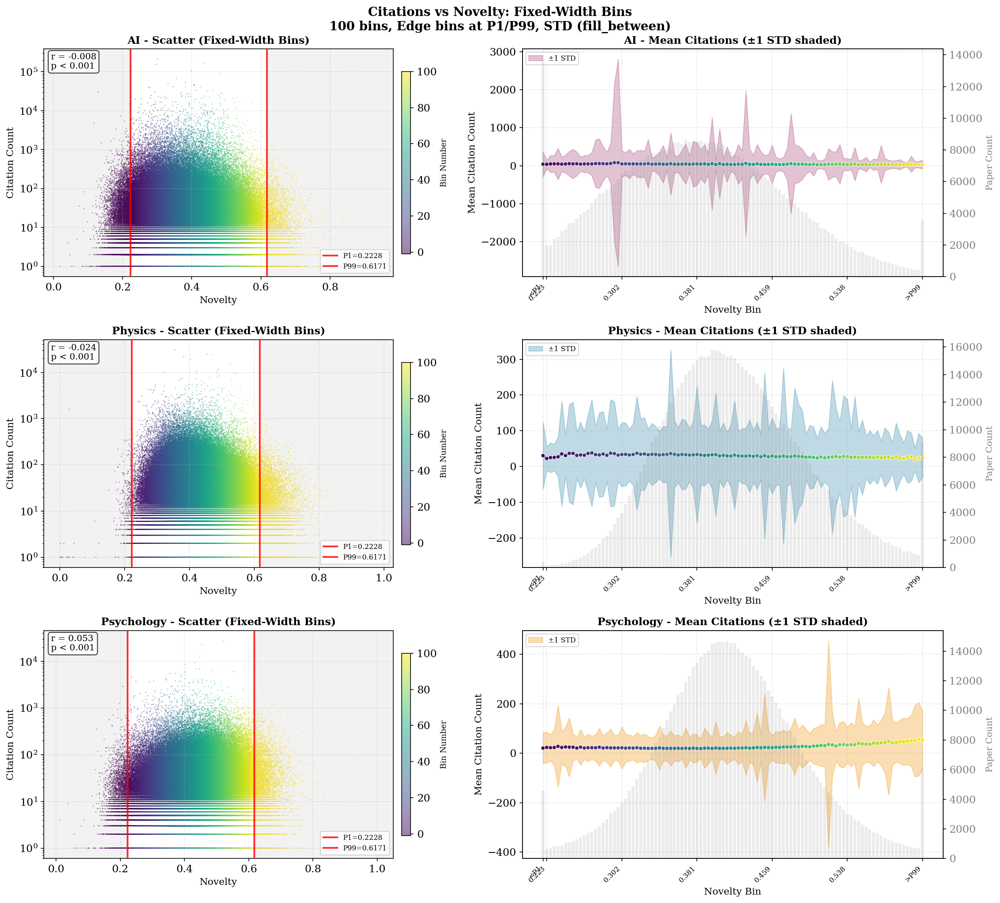

In [51]:
fig_fixed, stats_fixed = plot_fixed_width_bins_flexible(
    merged_df, 
    n_bins=100, 
    low_percentile=1,
    high_percentile=99,
    collect_edge_bins=True,   # Set to False to NOT collect p1/p99 separately
    error_type='std',          # Options: 'std', 'sem', 'ci'
    use_fill=True,            # Set to False to use error bars instead
    n_bootstrap=1000,
    ci=95
)
plt.show()

## 6c. Novelty vs Citation Binned: Comparing Fields at Same Citation Levels

**Key Question**: At the same citation level, which field produces more novel work?

With global citation binning, we can directly compare:
- At low citations: Are papers from AI/Physics/Psychology similar in novelty?
- At high citations: Do highly-cited papers converge to similar novelty levels across fields?

*This analysis controls for citation count to isolate field-specific novelty patterns.*

In [40]:
def create_citation_bins_global(df, n_bins=100):
    """Bin by citation count globally and calculate novelty statistics per field.
    
    Args:
        df: DataFrame with data
        n_bins: Number of bins to create
    
    Returns:
        DataFrame with binned statistics per field
    """
    df_clean = df[[NOVELTY_COL, CITATION_COL, 'field']].dropna().copy()
    
    # Create global bins based on all data
    ranks = df_clean[CITATION_COL].rank(method='first')
    df_clean['citation_bin'] = pd.qcut(ranks, q=n_bins, labels=False)
    
    # Calculate stats per field within global bins
    fields = df_clean['field'].unique()
    field_stats = []
    
    for field in fields:
        field_data = df_clean[df_clean['field'] == field]
        field_bins = field_data.groupby('citation_bin').agg({
            NOVELTY_COL: ['mean', 'median', 'count', 'sem'],
            CITATION_COL: 'mean'
        }).reset_index()
        field_bins.columns = ['bin', 'novelty_mean', 'novelty_median', 'count', 'novelty_sem', 'citation_avg']
        field_bins['field'] = field
        field_stats.append(field_bins)
    
    return pd.concat(field_stats, ignore_index=True)


def plot_novelty_vs_citation_bins_global(field_stats):
    """Plot novelty vs citation bins (global binning) with paper count on secondary y-axis.
    
    Args:
        field_stats: DataFrame with binned statistics
    
    Returns:
        matplotlib Figure
    """
    fields = ['AI', 'Physics', 'Psychology']
    colors = {'AI': '#A23B72', 'Physics': '#2E86AB', 'Psychology': '#F18F01', 'Other': '#666666'}
    
    fig, axes = plt.subplots(3, 2, figsize=(14, 12))
    
    # Calculate bar width based on citation range
    all_citations = field_stats['citation_avg'].values
    bar_width = (all_citations.max() - all_citations.min()) / 200 if len(all_citations) > 0 else 1
    
    for idx, field in enumerate(fields):
        field_data = field_stats[field_stats['field'] == field].sort_values('citation_avg')
        if len(field_data) == 0:
            continue
        color = colors.get(field, '#333333')
        
        # Mean novelty (left column)
        ax_left = axes[idx, 0]
        ax_left_twin = ax_left.twinx()
        ax_left.fill_between(field_data['citation_avg'], 
                            field_data['novelty_mean'] - field_data['novelty_sem'],
                            field_data['novelty_mean'] + field_data['novelty_sem'],
                            alpha=0.3, color=color)
        ax_left.plot(field_data['citation_avg'], field_data['novelty_mean'], 
                    linewidth=2, color=color)
        ax_left_twin.bar(field_data['citation_avg'], field_data['count'], 
                        alpha=0.15, color='gray', width=bar_width)
        
        ax_left.set_xlabel('Citation Count (Global Binning)', fontsize=11)
        ax_left.set_ylabel('Mean Novelty', fontsize=11, color=color)
        ax_left_twin.set_ylabel('Paper Count', fontsize=10, color='gray')
        ax_left_twin.tick_params(axis='y', labelcolor='gray')
        ax_left.set_title(f'{field} - Mean Novelty vs Citations', fontsize=12, fontweight='bold')
        ax_left.grid(True, alpha=0.3, linestyle='--')
        
        # Median novelty (right column)
        ax_right = axes[idx, 1]
        ax_right_twin = ax_right.twinx()
        ax_right.plot(field_data['citation_avg'], field_data['novelty_median'], 
                     linewidth=2, color=color)
        ax_right_twin.bar(field_data['citation_avg'], field_data['count'], 
                         alpha=0.15, color='gray', width=bar_width)
        
        ax_right.set_xlabel('Citation Count (Global Binning)', fontsize=11)
        ax_right.set_ylabel('Median Novelty', fontsize=11, color=color)
        ax_right_twin.set_ylabel('Paper Count', fontsize=10, color='gray')
        ax_right_twin.tick_params(axis='y', labelcolor='gray')
        ax_right.set_title(f'{field} - Median Novelty vs Citations', fontsize=12, fontweight='bold')
        ax_right.grid(True, alpha=0.3, linestyle='--')
    
    plt.tight_layout()
    fig.suptitle('Novelty vs Citations (Global Binning)', fontsize=14, fontweight='bold', y=1.01)
    return fig

In [42]:
def create_citation_bins_per_field(df, n_bins=100):
    """Bin by citation count per field and calculate novelty statistics.
    
    Args:
        df: DataFrame with data
        n_bins: Number of bins to create
    
    Returns:
        DataFrame with binned statistics per field
    """
    df_clean = df[[NOVELTY_COL, CITATION_COL, 'field']].dropna().copy()
    fields = df_clean['field'].unique()
    field_stats = []
    
    for field in fields:
        field_data = df_clean[df_clean['field'] == field].copy()
        
        # Create bins per field
        ranks = field_data[CITATION_COL].rank(method='first')
        field_data['citation_bin'] = pd.qcut(ranks, q=n_bins, labels=False)
        
        field_bins = field_data.groupby('citation_bin').agg({
            NOVELTY_COL: ['mean', 'median', 'count', 'sem'],
            CITATION_COL: 'mean'
        }).reset_index()
        field_bins.columns = ['bin', 'novelty_mean', 'novelty_median', 'count', 'novelty_sem', 'citation_avg']
        field_bins['field'] = field
        field_stats.append(field_bins)
    
    return pd.concat(field_stats, ignore_index=True)


def plot_novelty_vs_citation_bins_per_field(field_stats):
    """Plot novelty vs citation bins (per-field binning) with paper count on secondary y-axis.
    
    Args:
        field_stats: DataFrame with binned statistics
    
    Returns:
        matplotlib Figure
    """
    fields = ['AI', 'Physics', 'Psychology']
    colors = {'AI': '#A23B72', 'Physics': '#2E86AB', 'Psychology': '#F18F01', 'Other': '#666666'}
    
    fig, axes = plt.subplots(3, 2, figsize=(14, 12))
    
    for idx, field in enumerate(fields):
        field_data = field_stats[field_stats['field'] == field].sort_values('citation_avg')
        if len(field_data) == 0:
            continue
        color = colors.get(field, '#333333')
        
        # Calculate bar width based on this field's citation range
        bar_width = (field_data['citation_avg'].max() - field_data['citation_avg'].min()) / 200 if len(field_data) > 0 else 1
        
        # Mean novelty (left column)
        ax_left = axes[idx, 0]
        ax_left_twin = ax_left.twinx()
        ax_left.fill_between(field_data['citation_avg'], 
                            field_data['novelty_mean'] - field_data['novelty_sem'],
                            field_data['novelty_mean'] + field_data['novelty_sem'],
                            alpha=0.3, color=color)
        ax_left.plot(field_data['citation_avg'], field_data['novelty_mean'], 
                    linewidth=2, color=color)
        ax_left_twin.bar(field_data['citation_avg'], field_data['count'], 
                        alpha=0.15, color='gray', width=bar_width)
        
        ax_left.set_xlabel('Citation Count (Per-Field Binning)', fontsize=11)
        ax_left.set_ylabel('Mean Novelty', fontsize=11, color=color)
        ax_left_twin.set_ylabel('Paper Count', fontsize=10, color='gray')
        ax_left_twin.tick_params(axis='y', labelcolor='gray')
        ax_left.set_title(f'{field} - Mean Novelty vs Citations', fontsize=12, fontweight='bold')
        ax_left.grid(True, alpha=0.3, linestyle='--')
        
        # Median novelty (right column)
        ax_right = axes[idx, 1]
        ax_right_twin = ax_right.twinx()
        ax_right.plot(field_data['citation_avg'], field_data['novelty_median'], 
                     linewidth=2, color=color)
        ax_right_twin.bar(field_data['citation_avg'], field_data['count'], 
                         alpha=0.15, color='gray', width=bar_width)
        
        ax_right.set_xlabel('Citation Count (Per-Field Binning)', fontsize=11)
        ax_right.set_ylabel('Median Novelty', fontsize=11, color=color)
        ax_right_twin.set_ylabel('Paper Count', fontsize=10, color='gray')
        ax_right_twin.tick_params(axis='y', labelcolor='gray')
        ax_right.set_title(f'{field} - Median Novelty vs Citations', fontsize=12, fontweight='bold')
        ax_right.grid(True, alpha=0.3, linestyle='--')
    
    plt.tight_layout()
    fig.suptitle('Novelty vs Citations (Per-Field Binning)', fontsize=14, fontweight='bold', y=1.01)
    return fig

## 7. Summary Statistics & Key Findings

Let's examine specific examples and quantify the overall relationship.

### Top Papers Inspection
We look at the most extreme papers on both dimensions:
- **Most Cited**: What novelty scores do groundbreaking papers have?
- **Most Novel**: Do highly unique papers gain traction?

### Correlation Summary
Pearson correlations by field provide a single-number summary of the novelty-impact relationship.

In [44]:
# Top papers by citations
print("=== Top 10 Most Cited Papers ===")
top_cited_overall = merged_df.nlargest(10, CITATION_COL)[[
    'corpusid', 'title', CITATION_COL, NOVELTY_COL, 'field', 'publication_year'
]]
display(top_cited_overall)

# Top papers by novelty
print("\n=== Top 10 Most Novel Papers ===")
top_novel_overall = merged_df.nlargest(10, NOVELTY_COL)[[
    'corpusid', 'title', NOVELTY_COL, CITATION_COL, 'field', 'publication_year'
]]
display(top_novel_overall)

=== Top 10 Most Cited Papers ===


,corpusid,title,citation_count,novelty_mean,field,publication_year
80788,206594692,Deep Residual Learning for Image Recognition,212958,0.301274,AI,2015
2454431,6628106,Adam: A Method for Stochastic Optimization,159525,0.433947,AI,2014
2352672,13756489,Attention is All you Need,155623,0.297354,AI,2017
1793265,14124313,Very Deep Convolutional Networks for Large-Sca...,107085,0.398547,AI,2014
2355012,3719281,U-Net: Convolutional Networks for Biomedical I...,86900,0.481810,AI,2015
2304301,10328909,Faster R-CNN: Towards Real-Time Object Detecti...,68158,0.355245,AI,2015
1723134,225039882,An Image is Worth 16x16 Words: Transformers fo...,52559,0.380382,AI,2020
2498520,218971783,Language Models are Few-Shot Learners,50503,0.331484,AI,2020
1622546,206592484,Going deeper with convolutions,45792,0.405213,AI,2014
1666344,4650265,XGBoost: A Scalable Tree Boosting System,45470,0.407797,AI,2016



=== Top 10 Most Novel Papers ===


,corpusid,title,novelty_mean,citation_count,field,publication_year
1012787,36632416,The Effects of Duct Shape on the Nusselt Number,1.000000,19,Psychology,2005
1946294,6006608,Measurement of neutron induced fission of 235U...,0.979595,6,Physics,2007
980830,16262271,A design of high speed double precision floati...,0.936322,7,AI,2005
276088,41595454,"The 2 Tbps ""data to surface"" system of the CMS...",0.920971,7,Physics,2005
2463616,248377127,LOv-Calculus: A Graphical Language for Linear ...,0.915462,22,AI,2022
1775784,131512361,On Some Comet Observations in Ancient India,0.908794,2,Physics,2006
2178099,168953877,Comparison of Various Security Features of Gen...,0.907544,4,AI,2017
166763,124550809,A new pulse neutron detector used in the mixtu...,0.901868,2,Physics,2005
286289,55128360,Spatial variation of dose rate from beta sourc...,0.895984,40,Physics,2006
1180649,123153549,Deployment and use of the ATLAS DAQ in the com...,0.880966,4,Physics,2005


In [45]:
# Correlation analysis by field
print("=== Correlation: Novelty vs Citations by Field ===")
for field in ['Physics', 'AI', 'Psychology']:
    field_data = merged_df[merged_df['field'] == field]
    corr_citation = field_data[NOVELTY_COL].corr(field_data[CITATION_COL])
    corr_influential = field_data[NOVELTY_COL].corr(field_data[INFLUENTIAL_COL])
    corr_percentile = field_data[NOVELTY_COL].corr(field_data[PERCENTILE_CITATION_COL])
    print(f"{field}:")
    print(f"  Novelty vs Citation Count: {corr_citation:.4f}")
    print(f"  Novelty vs Influential Citations: {corr_influential:.4f}")
    print(f"  Novelty vs Citation Percentile: {corr_percentile:.4f}")

=== Correlation: Novelty vs Citations by Field ===
Physics:
  Novelty vs Citation Count: -0.0241
  Novelty vs Influential Citations: -0.0429
  Novelty vs Citation Percentile: -0.1064
AI:
  Novelty vs Citation Count: -0.0083
  Novelty vs Influential Citations: -0.0103
  Novelty vs Citation Percentile: -0.0817
Psychology:
  Novelty vs Citation Count: 0.0526
  Novelty vs Influential Citations: 0.0339
  Novelty vs Citation Percentile: -0.0522


## 8. Deep Dive: AI Paper Neighborhood Analysis

For a more granular view, we examine **individual AI papers** and their semantic neighborhoods. Using pre-computed t-SNE embeddings, we visualize:

- **Query Paper** (red star): The paper of interest
- **Neighbors**: Papers closest in 768-dimensional embedding space
- **Color**: Citation count (Viridis scale)
- **Line Opacity**: Proximity to query paper (closer = more opaque)

This reveals the local structure around influential papers:
- Are highly-cited papers surrounded by other highly-cited papers?
- Do novel papers cluster together or are they isolated outliers?

In [12]:
ai_top_papers = pd.read_csv('ai_top_papers_tsne_per_query.csv')
ai_top_papers.query_id = ai_top_papers.query_id.astype(str)
ai_top_papers_merged = ai_top_papers.merge(
    merged_df,
    left_on='title',
    right_on='title',
    how='left'
)
ai_top_papers_merged

,x,y,type,query_id,title,cosine_distance,color,corpusid,citation_count,influential_citation_count,...,novelty_weighted_citation5,novelty_max,novelty_min,novelty_median,novelty_harmonic,is_physics,is_ai,is_psych,primary_topic,field
0,-1.349863,-1.654713,query,1023605,"Inception-v4, Inception-ResNet and the Impact ...",0.000000,#1f77b4,1023605.0,14899.0,1242.0,...,0.072158,0.035078,0.081381,0.074948,0.071640,False,True,False,Domain Adaptation and Few-Shot Learning,AI
1,-0.895953,-2.121089,neighbor,1023605,Deep Residual Learning for Image Recognition,0.035079,#1f77b4,206594692.0,212958.0,31078.0,...,0.056441,0.034739,0.064598,0.058645,0.055979,False,True,False,Advanced Neural Network Applications,AI
2,-0.615728,-0.698985,neighbor,1023605,Resnet in Resnet: Generalizing Residual Archit...,0.053926,#1f77b4,12585246.0,958.0,70.0,...,0.074598,0.043622,0.085204,0.077095,0.073967,<NA>,True,<NA>,Advanced Neural Network Applications,AI
3,-1.993905,1.048468,neighbor,1023605,Delving Deep into Rectifiers: Surpassing Human...,0.054637,#1f77b4,13740328.0,19669.0,1355.0,...,0.075633,0.055835,0.086503,0.077046,0.075016,False,True,False,Advanced Neural Network Applications,AI
4,-1.847369,2.563065,neighbor,1023605,Fast and Accurate Deep Network Learning by Exp...,0.055968,#1f77b4,5273326.0,5843.0,560.0,...,0.067069,0.042219,0.075759,0.068834,0.066452,<NA>,True,<NA>,Domain Adaptation and Few-Shot Learning,AI
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11780,1.994541,-6.411585,neighbor,6447277,Understanding Deep Architectures using a Recur...,0.078342,#17becf,18166574.0,147.0,6.0,...,0.092253,0.061997,0.104755,0.096299,0.091943,<NA>,True,<NA>,Domain Adaptation and Few-Shot Learning,AI
11781,1.820635,0.968764,neighbor,6447277,Relay Backpropagation for Effective Learning o...,0.078456,#17becf,264649570.0,315.0,11.0,...,0.078616,0.058201,0.086401,0.080717,0.078181,<NA>,True,<NA>,Domain Adaptation and Few-Shot Learning,AI
11782,3.180607,-1.237798,neighbor,6447277,Do Deep Nets Really Need to be Deep?,0.078486,#17becf,11536917.0,2189.0,125.0,...,0.086664,0.061519,0.098971,0.091172,0.086561,<NA>,True,<NA>,Generative Adversarial Networks and Image Synt...,AI
11783,4.190481,10.455592,neighbor,6447277,Understanding learned CNN features through Fil...,0.078525,#17becf,16598672.0,2.0,0.0,...,0.080617,0.057430,0.089552,0.082095,0.080649,<NA>,True,<NA>,Advanced Neural Network Applications,AI


In [13]:
# Interactive visualization: Explore specific paper neighborhoods with enhanced features
# Select a specific query to analyze in detail
sample_query = '13756489'
query_data = ai_top_papers_merged[ai_top_papers_merged['query_id'] == str(sample_query)].copy()

# Use the actual 768-dimensional distance from the distance column
neighbors_data = query_data.iloc[1:].copy()
neighbors_data = neighbors_data.sort_values('cosine_distance')

# Get citation counts for color mapping
citation_counts = neighbors_data['citation_count'].fillna(0)
min_cit = citation_counts.min()
max_cit = citation_counts.max()

fig = go.Figure()

# Prepare neighbor hover text with paper info
neighbor_hovers = []
for idx, row in neighbors_data.iterrows():
    hover_text = f"<b>Neighbor Paper</b><br>"
    if 'title' in row and pd.notna(row['title']):
        hover_text += f"Title: {row['title']}<br>"
    if 'corpus_id' in row:
        hover_text += f"Corpus ID: {row['corpus_id']}<br>"
    if 'publication_year' in row:
        hover_text += f"Year: {row['publication_year']}<br>"
    if 'citation_count' in row and pd.notna(row['citation_count']):
        hover_text += f"Citations: {int(row['citation_count'])}<br>"
    if 'novelty_mean' in row:
        hover_text += f"Novelty: {row['novelty_mean']:.4f}<br>"
    if 'cosine_distance' in row:
        hover_text += f"Cosine Distance: {row['cosine_distance']:.4f}"
    neighbor_hovers.append(hover_text)

# Add neighbors with color-coded citations (heatmap style)
fig.add_trace(go.Scatter(
    x=neighbors_data['x'],
    y=neighbors_data['y'],
    mode='markers',
    name='Neighbors',
    marker=dict(
        size=12, 
        color=neighbors_data['citation_count'].fillna(0),
        colorscale='Viridis',
        showscale=True,
        colorbar=dict(
            title="Citations",
            thickness=15,
            len=0.7,
            x=1.15
        ),
        line=dict(width=1, color='white'),
        cmin=min_cit,
        cmax=max_cit
    ),
    hovertemplate='%{text}<extra></extra>',
    text=neighbor_hovers
))

# Prepare query paper hover text
query_row = query_data.iloc[0]
query_hover = f"<b>Query Paper</b><br>"
if 'title' in query_row and pd.notna(query_row['title']):
    query_hover += f"Title: {query_row['title']}<br>"
if 'corpus_id' in query_row:
    query_hover += f"Corpus ID: {query_row['corpus_id']}<br>"
if 'publication_year' in query_row:
    query_hover += f"Year: {query_row['publication_year']}<br>"
if 'citation_count' in query_row and pd.notna(query_row['citation_count']):
    query_hover += f"Citations: {int(query_row['citation_count'])}<br>"
if 'novelty_mean' in query_row:
    query_hover += f"Novelty: {query_row['novelty_mean']:.4f}"

# Add query paper
fig.add_trace(go.Scatter(
    x=[query_data['x'].iloc[0]],
    y=[query_data['y'].iloc[0]],
    mode='markers',
    name='Query Paper',
    marker=dict(size=25, color='red', symbol='star', 
                line=dict(width=2, color='darkred')),
    hovertemplate='%{text}<extra></extra>',
    text=[query_hover]
))

# Add connecting lines with transparency based on distance
max_dist = neighbors_data['cosine_distance'].max()
for _, neighbor in neighbors_data.iterrows():
    opacity = 1 - (neighbor['cosine_distance'] / max_dist) * 0.7  # Closer = more opaque
    fig.add_trace(go.Scatter(
        x=[query_data['x'].iloc[0], neighbor['x']],
        y=[query_data['y'].iloc[0], neighbor['y']],
        mode='lines',
        line=dict(color='gray', width=0.5),
        opacity=opacity,
        showlegend=False,
        hoverinfo='skip'
    ))

# Create persistent info panel annotations for key papers
annotations = []

# Query paper info (top-left)
query_info = f"<b>QUERY PAPER</b><br>"
if pd.notna(query_row.get('title')):
    query_info += f"{query_row['title']}<br>"
query_info += f"Citations: {int(query_row.get('citation_count', 0))}<br>"
query_info += f"Novelty: {query_row.get('novelty_mean', 0):.4f}<br>"
query_info += f"Year: {int(query_row.get('publication_year', 0))}"

annotations.append(dict(
    x=0.02, y=0.98,
    xref='paper', yref='paper',
    text=query_info,
    showarrow=False,
    align='left',
    bgcolor='rgba(255, 200, 200, 0.9)',
    bordercolor='darkred',
    borderwidth=2,
    borderpad=8,
    font=dict(size=10, family='monospace')
))

# Closest neighbor info (top-right)
closest = neighbors_data.iloc[0]
closest_info = f"<b>CLOSEST NEIGHBOR</b><br>"
if pd.notna(closest.get('title')):
    closest_info += f"{closest['title']}<br>"
if pd.notna(closest.get('citation_count')):
    closest_info += f"Citations: {int(closest.get('citation_count', 0))}<br>" 
closest_info += f"Novelty: {closest.get('novelty_mean', 0):.4f}<br>"
closest_info += f"Cosine Distance: {closest['cosine_distance']:.4f}<br>"
if pd.notna(closest.get('publication_year')):
    closest_info += f"Year: {int(closest.get('publication_year', 0))}"

annotations.append(dict(
    x=0.98, y=0.98,
    xref='paper', yref='paper',
    text=closest_info,
    showarrow=False,
    align='left',
    bgcolor='rgba(200, 255, 200, 0.9)',
    bordercolor='darkgreen',
    borderwidth=2,
    borderpad=8,
    font=dict(size=10, family='monospace')
))

# Most cited neighbor info (bottom-left)
most_cited = neighbors_data.nlargest(1, 'citation_count').iloc[0]
cited_info = f"<b>MOST CITED NEIGHBOR</b><br>"
if pd.notna(most_cited.get('title')):
    cited_info += f"{most_cited['title']}.<br>" 
if pd.notna(most_cited.get('citation_count')):
    cited_info += f"Citations: {int(most_cited.get('citation_count', 0))}<br>"
cited_info += f"Novelty: {most_cited.get('novelty_mean', 0):.4f}<br>"
cited_info += f"Cosine Distance: {most_cited['cosine_distance']:.4f}<br>"
if pd.notna(most_cited.get('publication_year')):
    cited_info += f"Year: {int(most_cited.get('publication_year', 0))}"

annotations.append(dict(
    x=0.02, y=0.02,
    xref='paper', yref='paper',
    text=cited_info,
    showarrow=False,
    align='left',
    bgcolor='rgba(200, 200, 255, 0.9)',
    bordercolor='darkblue',
    borderwidth=2,
    borderpad=8,
    font=dict(size=10, family='monospace')
))

# Statistics box (bottom-right)
stats_info = f"<b>NEIGHBORHOOD STATS</b><br>"
stats_info += f"Total neighbors: {len(neighbors_data)}<br>"
stats_info += f"Avg cosine distance: {neighbors_data['cosine_distance'].mean():.4f}<br>"
stats_info += f"Avg citations: {neighbors_data['citation_count'].mean():.0f}<br>"
stats_info += f"Avg novelty: {neighbors_data['novelty_mean'].mean():.4f}"

annotations.append(dict(
    x=0.98, y=0.02,
    xref='paper', yref='paper',
    text=stats_info,
    showarrow=False,
    align='left',
    bgcolor='rgba(255, 255, 200, 0.9)',
    bordercolor='orange',
    borderwidth=2,
    borderpad=8,
    font=dict(size=10, family='monospace')
))

fig.update_layout(
    title=dict(
        text=f'Paper Neighborhood Analysis - Query {sample_query}<br><sub>Color intensity indicates citation count | Line opacity shows proximity (768-dim distance)</sub>',
        x=0.5,
        xanchor='center'
    ),
    xaxis_title='Dimension 1',
    yaxis_title='Dimension 2',
    height=800,
    hovermode='closest',
    annotations=annotations,
    showlegend=True,
    legend=dict(
        x=0.5, y=-0.1,
        xanchor='center',
        orientation='h'
    ),
    margin=dict(l=50, r=150, t=100, b=50)
)

fig.show()

In [14]:
# Enhanced visualization: Why "Attention is All You Need" has low novelty
# This plot shows the prior art that makes the paper appear "not novel" by embedding metrics

import plotly.graph_objects as go
from plotly.subplots import make_subplots
import pandas as pd
import numpy as np
import re

# Find the Attention paper - use corpus ID 13756489
sample_query = '13756489'  # "Attention is All You Need" corpus ID
query_data = ai_top_papers_merged[ai_top_papers_merged['query_id'] == str(sample_query)].copy()

# Get neighbors sorted by cosine distance (closest first)
neighbors_data = query_data.iloc[1:].copy()
neighbors_data = neighbors_data.sort_values('cosine_distance').reset_index(drop=True)

# Define keywords to categorize prior work themes
keyword_patterns = {
    'Attention Mechanisms': r'attention|self.attention|attend',
    'Neural Machine Translation': r'neural.*(machine\s+)?translat|sequence.to.sequence|seq2seq|encoder.decoder',
    'Recurrent Networks': r'recurrent|lstm|gru|rnn',
    'Language Models': r'language\s+model|word\s+embed|word2vec|nlp|natural\s+language',
    'Deep Learning': r'deep\s+learn|neural\s+network|convolutional'
}

def categorize_paper(title):
    """Categorize paper based on title keywords"""
    if pd.isna(title):
        return 'Other'
    title_lower = title.lower()
    for category, pattern in keyword_patterns.items():
        if re.search(pattern, title_lower):
            return category
    return 'Other'

# Categorize each neighbor
neighbors_data['category'] = neighbors_data['title'].apply(categorize_paper)

# Color mapping for categories
category_colors = {
    'Attention Mechanisms': '#e41a1c',      # Red - most relevant prior work
    'Neural Machine Translation': '#377eb8', # Blue
    'Recurrent Networks': '#4daf4a',         # Green
    'Language Models': '#984ea3',            # Purple
    'Deep Learning': '#ff7f00',              # Orange
    'Other': '#999999'                        # Gray
}

fig = go.Figure()

# Add neighbors grouped by category
for category in category_colors.keys():
    cat_data = neighbors_data[neighbors_data['category'] == category]
    if len(cat_data) == 0:
        continue
    
    # Prepare hover text
    hover_texts = []
    for _, row in cat_data.iterrows():
        hover_text = f"<b>{category}</b><br>"
        if pd.notna(row.get('title')):
            # Truncate long titles
            title = row['title'][:80] + '...' if len(str(row['title'])) > 80 else row['title']
            hover_text += f"Title: {title}<br>"
        if pd.notna(row.get('publication_year')):
            hover_text += f"Year: {int(row['publication_year'])}<br>"
        if pd.notna(row.get('citation_count')):
            hover_text += f"Citations: {int(row['citation_count'])}<br>"
        hover_text += f"Cosine Distance: {row['cosine_distance']:.4f}<br>"
        hover_text += f"Similarity: {1 - row['cosine_distance']:.4f}"
        hover_texts.append(hover_text)
    
    fig.add_trace(go.Scatter(
        x=cat_data['x'],
        y=cat_data['y'],
        mode='markers',
        name=f"{category} ({len(cat_data)})",
        marker=dict(
            size=10 + (1 - cat_data['cosine_distance']) * 15,  # Closer = larger
            color=category_colors[category],
            opacity=0.7,
            line=dict(width=1, color='white')
        ),
        hovertemplate='%{text}<extra></extra>',
        text=hover_texts
    ))

# Add query paper (Attention is All You Need)
query_row = query_data.iloc[0]
query_hover = f"<b>QUERY: Attention is All You Need (2017)</b><br>"
query_hover += f"Novelty Score: {query_row.get('novelty_mean', 0):.4f}<br>"
query_hover += f"Citations: {int(query_row.get('citation_count', 0))}<br>"
query_hover += f"<br><i>Low novelty because many similar<br>papers on attention & NMT existed</i>"

fig.add_trace(go.Scatter(
    x=[query_data['x'].iloc[0]],
    y=[query_data['y'].iloc[0]],
    mode='markers',
    name='Attention is All You Need',
    marker=dict(size=30, color='gold', symbol='star', 
                line=dict(width=3, color='black')),
    hovertemplate='%{text}<extra></extra>',
    text=[query_hover]
))

# Add connecting lines to closest neighbors with varying opacity
top_n = 20  # Show connections to top 20 closest
top_neighbors = neighbors_data.head(top_n)
max_dist = top_neighbors['cosine_distance'].max()

for _, neighbor in top_neighbors.iterrows():
    opacity = 0.8 - (neighbor['cosine_distance'] / max_dist) * 0.6
    fig.add_trace(go.Scatter(
        x=[query_data['x'].iloc[0], neighbor['x']],
        y=[query_data['y'].iloc[0], neighbor['y']],
        mode='lines',
        line=dict(color=category_colors.get(neighbor['category'], '#999'), width=1.5),
        opacity=opacity,
        showlegend=False,
        hoverinfo='skip'
    ))

# Calculate category statistics for annotation
category_counts = neighbors_data['category'].value_counts()
category_avg_dist = neighbors_data.groupby('category')['cosine_distance'].mean()

# Create statistics text
stats_text = "<b>WHY LOW NOVELTY?</b><br><br>"
stats_text += f"Novelty = 1 - avg(similarity)<br>"
stats_text += f"= 1 - {1 - query_row.get('novelty_mean', 0):.4f}<br>"
stats_text += f"= <b>{query_row.get('novelty_mean', 0):.4f}</b><br><br>"
stats_text += "<b>Prior Work Categories:</b><br>"

for cat in ['Attention Mechanisms', 'Neural Machine Translation', 'Recurrent Networks', 'Language Models']:
    if cat in category_counts.index:
        count = category_counts[cat]
        avg_dist = category_avg_dist[cat]
        stats_text += f"• {cat}: {count}<br>"

# Create list of key prior papers
prior_papers_text = "<b>KEY PRIOR PAPERS</b><br>(by embedding similarity)<br><br>"
for i, (_, row) in enumerate(neighbors_data.head(8).iterrows()):
    if pd.notna(row['title']):
        title_short = row['title'][:40] + '...' if len(str(row['title'])) > 40 else row['title']
        year = int(row['publication_year']) if pd.notna(row['publication_year']) else '?'
        prior_papers_text += f"{i+1}. {title_short}<br>   ({year}, sim: {1-row['cosine_distance']:.3f})<br>"

# Add annotations
annotations = [
    # Stats box - top left
    dict(
        x=0.02, y=0.98,
        xref='paper', yref='paper',
        text=stats_text,
        showarrow=False,
        align='left',
        bgcolor='rgba(255, 255, 220, 0.95)',
        bordercolor='orange',
        borderwidth=2,
        borderpad=10,
        font=dict(size=10, family='Arial')
    ),
    # Prior papers box - bottom left
    dict(
        x=0.02, y=0.45,
        xref='paper', yref='paper',
        text=prior_papers_text,
        showarrow=False,
        align='left',
        bgcolor='rgba(240, 240, 255, 0.95)',
        bordercolor='#377eb8',
        borderwidth=2,
        borderpad=10,
        font=dict(size=9, family='Arial')
    )
]

fig.update_layout(
    title=dict(
        text='<b>Why "Attention is All You Need" Shows Low Novelty</b><br>' +
             '<sub>Colors show thematic categories of 100 nearest neighbors in embedding space | ' +
             'Prior work on attention & NMT makes the paper appear semantically "familiar"</sub>',
        x=0.5,
        xanchor='center',
        font=dict(size=16)
    ),
    xaxis_title='t-SNE Dimension 1',
    yaxis_title='t-SNE Dimension 2',
    height=900,
    width=1200,
    hovermode='closest',
    annotations=annotations,
    showlegend=True,
    legend=dict(
        x=1.02, y=0.98,
        xanchor='left',
        yanchor='top',
        bgcolor='rgba(255,255,255,0.9)',
        bordercolor='gray',
        borderwidth=1
    ),
    margin=dict(l=50, r=250, t=100, b=50)
)

fig.show()

/var/folders/qn/xqf2q5g92lgd4j6z0bq50vyh0000gp/T/ipykernel_6799/2430419115.py:124: UserWarning:

The figure layout has changed to tight



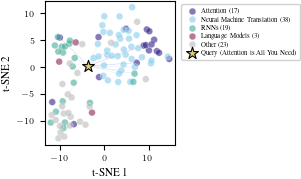

In [24]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import re
from tueplots import bundles

# Use ICML 2024 bundle for half-column width
plt.rcParams.update(bundles.icml2024(column="half", nrows=1, ncols=1))

# Find the Attention paper - use corpus ID 13756489
sample_query = '13756489'  # "Attention is All You Need" corpus ID
query_data = ai_top_papers_merged[ai_top_papers_merged['query_id'] == str(sample_query)].copy()

# Get neighbors sorted by cosine distance (closest first)
neighbors_data = query_data.iloc[1:].copy()
neighbors_data = neighbors_data.sort_values('cosine_distance').reset_index(drop=True)

# Define keywords to categorize prior work themes
keyword_patterns = {
    'Attention': r'attention|self.attention|attend',
    'Neural Machine Translation': r'neural.*(machine\s+)?translat|sequence.to.sequence|seq2seq|encoder.decoder',
    'RNNs': r'recurrent|lstm|gru|rnn',
    'Language Models': r'language\s+model|word\s+embed|word2vec|nlp|natural\s+language',
}

def categorize_paper(title):
    """Categorize paper based on title keywords"""
    if pd.isna(title):
        return 'Other'
    title_lower = title.lower()
    for category, pattern in keyword_patterns.items():
        if re.search(pattern, title_lower):
            return category
    return 'Other'

# Categorize each neighbor
neighbors_data['category'] = neighbors_data['title'].apply(categorize_paper)

# Colorblind-friendly palette (Paul Tol's muted)
category_colors = {
    'Attention': '#332288',      # Indigo
    'Neural Machine Translation': '#88CCEE',            # Cyan
    'RNNs': '#44AA99',           # Teal
    'Language Models': '#882255', # Wine
    'Deep Learning': '#999933',   # Olive
    'Other': '#BBBBBB'            # Grey
}

fig, ax = plt.subplots(1,1)

# Query paper coordinates
query_x = query_data['x'].iloc[0]
query_y = query_data['y'].iloc[0]

# Plot neighbors grouped by category
for category in category_colors.keys():
    cat_data = neighbors_data[neighbors_data['category'] == category]
    if len(cat_data) == 0:
        continue
    
    # Size based on similarity (closer = larger)
    sizes = 5 + (1 - cat_data['cosine_distance']) * 20
    
    ax.scatter(
        cat_data['x'], 
        cat_data['y'],
        s=sizes,
        c=category_colors[category],
        alpha=0.6,
        label=f"{category} ({len(cat_data)})",
        edgecolors='white',
        linewidths=0.3,
        zorder=2
    )

# Draw connecting lines to top-k closest neighbors
top_n = 15
top_neighbors = neighbors_data.head(top_n)
max_dist = top_neighbors['cosine_distance'].max()

for _, neighbor in top_neighbors.iterrows():
    alpha = 0.6 - (neighbor['cosine_distance'] / max_dist) * 0.4
    ax.plot(
        [query_x, neighbor['x']],
        [query_y, neighbor['y']],
        color=category_colors.get(neighbor['category'], '#BBBBBB'),
        linewidth=0.4,
        alpha=alpha,
        zorder=1
    )

# Plot query paper (Attention is All You Need) as a star
ax.scatter(
    [query_x], [query_y],
    s=80,
    c='#DDCC77',  # Sand/gold color from Paul Tol
    marker='*',
    edgecolors='black',
    linewidths=0.8,
    label='Query (Attention is All You Need)',
    zorder=3
)

# Labels
ax.set_xlabel('t-SNE 1')
ax.set_ylabel('t-SNE 2')

# Legend - outside plot
ax.legend(
    loc='upper left',
    bbox_to_anchor=(1.02, 1),
    fontsize=5,
    frameon=True,
    framealpha=0.9,
    borderpad=0.5,
    handletextpad=0.3,
    labelspacing=0.3
)

# Remove top and right spines
# ax.spines['top'].set_visible(False)
# ax.spines['right'].set_visible(False)

plt.tight_layout()

# Save as PDF and PNG
fig.savefig('attention_novelty_icml.pdf', bbox_inches='tight', dpi=300)
fig.savefig('attention_novelty_icml.png', bbox_inches='tight', dpi=300)

plt.show()

/var/folders/qn/xqf2q5g92lgd4j6z0bq50vyh0000gp/T/ipykernel_6799/2721759645.py:168: UserWarning:

The figure layout has changed to tight



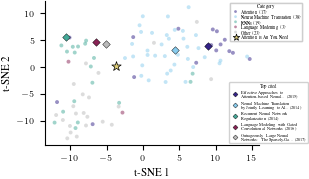

In [42]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import re
from tueplots import bundles
import textwrap

# Use ICML 2024 bundle for half-column width
plt.rcParams.update(bundles.icml2024(column="half", nrows=1, ncols=1))

# Find the Attention paper - use corpus ID 13756489
sample_query = '13756489'
query_data = ai_top_papers_merged[ai_top_papers_merged['query_id'] == str(sample_query)].copy()

# Get neighbors sorted by cosine distance (closest first)
neighbors_data = query_data.iloc[1:].copy()
neighbors_data = neighbors_data.sort_values('cosine_distance').reset_index(drop=True)

# Define keywords to categorize prior work themes
keyword_patterns = {
    'Attention': r'attention|self.attention|attend',
    'Neural Machine Translation': r'neural.*(machine\s+)?translat|sequence.to.sequence|seq2seq|encoder.decoder',
    'RNNs': r'recurrent|lstm|gru|rnn',
    'Language Modelling': r'language\s+model|word\s+embed|word2vec|nlp|natural\s+language',
}

def categorize_paper(title):
    if pd.isna(title):
        return 'Other'
    title_lower = title.lower()
    for category, pattern in keyword_patterns.items():
        if re.search(pattern, title_lower):
            return category
    return 'Other'

def wrap_title(title, width=28, max_lines=2):
    """Wrap title at word boundaries, max 2 lines with ellipsis if needed."""
    wrapped = textwrap.wrap(title, width=width)
    if len(wrapped) <= max_lines:
        return '\n'.join(wrapped)
    else:
        # Take first max_lines, add ellipsis to last line
        result = wrapped[:max_lines]
        if not result[-1].endswith('...'):
            result[-1] = result[-1][:width-3] + '...'
        return '\n'.join(result)

neighbors_data['category'] = neighbors_data['title'].apply(categorize_paper)

# Colorblind-friendly palette
category_colors = {
    'Attention': '#332288',
    'Neural Machine Translation': '#88CCEE',
    'RNNs': '#44AA99',
    'Language Modelling': '#882255',
    'Other': '#BBBBBB'
}

fig, ax = plt.subplots()

query_x = query_data['x'].iloc[0]
query_y = query_data['y'].iloc[0]

# Find top cited paper from each category (excluding Other)
top_cited_papers = []
for category in ['Attention', 'Neural Machine Translation', 'RNNs', 'Language Modelling', 'Other']:
    cat_data = neighbors_data[neighbors_data['category'] == category]
    if len(cat_data) > 0 and 'citation_count' in cat_data.columns:
        top_paper = cat_data.loc[cat_data['citation_count'].idxmax()]
        top_cited_papers.append(top_paper)

# Plot neighbors grouped by category
for category in category_colors.keys():
    cat_data = neighbors_data[neighbors_data['category'] == category]
    if len(cat_data) == 0:
        continue
    
    ax.scatter(
        cat_data['x'], 
        cat_data['y'],
        s=8,
        c=category_colors[category],
        alpha=0.5,
        label=f"{category} ({len(cat_data)})",
        edgecolors='none',
        zorder=2
    )

# Highlight top cited papers with small diamond markers
from matplotlib.lines import Line2D
top_handles, top_labels = [], []

for paper in top_cited_papers:
    category = paper['category']
    year = int(paper['publication_year']) if pd.notna(paper.get('publication_year')) else '?'

    citations = int(paper['citation_count']) if pd.notna(paper['citation_count']) else 0
    title = str(paper['title'])
    title_wrapped = wrap_title(title, width=28, max_lines=2)
    
    ax.scatter(
        [paper['x']], [paper['y']],
        s=15,
        c=category_colors[category],
        marker='D',
        edgecolors='black',
        linewidths=0.3,
        zorder=4
    )
    
    handle = Line2D([0], [0], marker='D', color='w', 
                    markerfacecolor=category_colors[category],
                    markeredgecolor='black', markeredgewidth=0.3,
                    markersize=2.5, linestyle='None')
    top_handles.append(handle)
    top_labels.append(f"{title_wrapped} ({year})")

# Plot query paper as a star
ax.scatter(
    [query_x], [query_y],
    s=50,
    c='#DDCC77',
    marker='*',
    edgecolors='black',
    linewidths=0.5,
    label='Attention is All You Need',
    zorder=5
)

ax.set_xlabel('t-SNE 1')
ax.set_ylabel('t-SNE 2')

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Category legend (top right)
legend1 = ax.legend(
    loc='upper left',
    bbox_to_anchor=(0.85, 1),
    fontsize=3.3,
    frameon=True,
    framealpha=0.9,
    handletextpad=0.2,
    labelspacing=0.2,
    borderpad=0.3,
    markerscale=0.7,
    title = 'Category',
    title_fontsize=3.5
)
ax.add_artist(legend1)

# Top cited legend with paper names (bottom right)
legend2 = ax.legend(
    top_handles, top_labels,
    loc='upper left',
    bbox_to_anchor=(0.85, 0.45),
    fontsize=3.2,
    frameon=True,
    framealpha=0.9,
    handletextpad=0.2,
    labelspacing=0.5,
    borderpad=0.3,
    title='Top cited',
    title_fontsize=3.5
)
ax.add_artist(legend1)

plt.tight_layout()
fig.savefig('attention_novelty_icml.pdf', bbox_inches='tight', dpi=300)
plt.show()

Top 5 most cited papers per category:
  [Attention] Effective Approaches to Attention-based Neural Machine Trans... (2015, 8227 citations)
  [Attention] Language to Logical Form with Neural Attention... (2016, 756 citations)
  [Attention] Multi-Way, Multilingual Neural Machine Translation with a Sh... (2016, 632 citations)
  [Neural Translation] Neural Machine Translation by Jointly Learning to Align and ... (2014, 28425 citations)
  [Neural Translation] On the Properties of Neural Machine Translation: Encoder–Dec... (2014, 7172 citations)
  [Neural Translation] Google's Neural Machine Translation System: Bridging the Gap... (2016, 7041 citations)
  [Recurrent/LSTM] Recurrent Neural Network Regularization... (2014, 2920 citations)
  [Recurrent/LSTM] Recurrent Continuous Translation Models... (2013, 1456 citations)
  [Recurrent/LSTM] Gated Feedback Recurrent Neural Networks... (2015, 867 citations)


/var/folders/qn/xqf2q5g92lgd4j6z0bq50vyh0000gp/T/ipykernel_95372/2247600768.py:281: UserWarning:

The figure layout has changed to tight



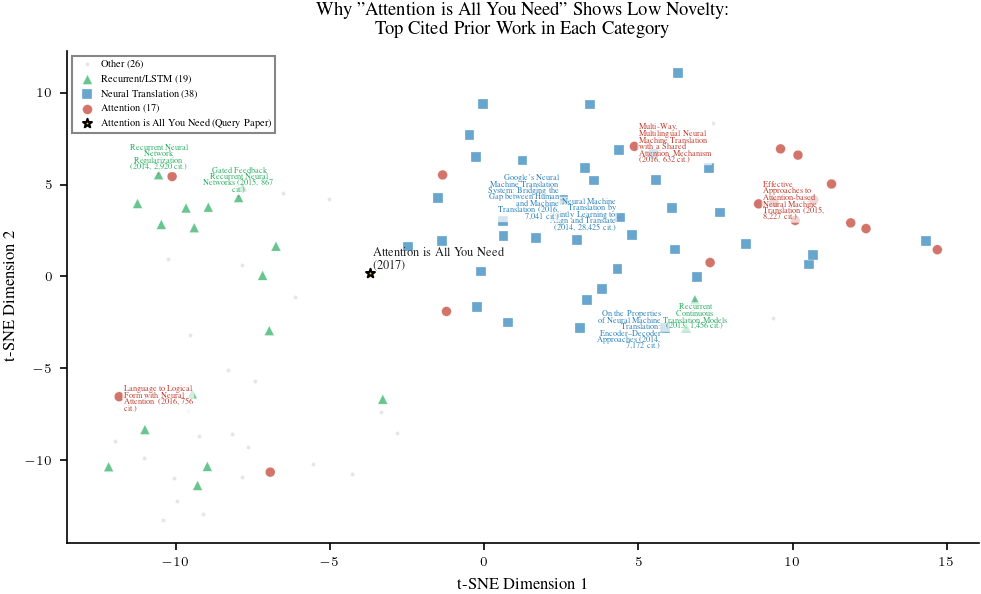


Category breakdown:
category
Neural Translation    38
Other                 26
Recurrent/LSTM        19
Attention             17
Name: count, dtype: int64


In [104]:
# Clean tueplots-style visualization: Why "Attention is All You Need" has low novelty
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import re
from tueplots import bundles

# Apply tueplots ICML style
plt.rcParams.update(bundles.icml2024(column="full", nrows=1, ncols=1))
# plt.rcParams.update({'figure.dpi': 150})

# Get the Attention paper neighborhood
sample_query = '13756489'  # "Attention is All You Need" corpus ID
query_data = ai_top_papers_merged[ai_top_papers_merged['query_id'] == str(sample_query)].copy()

# Get neighbors sorted by cosine distance
neighbors_data = query_data.iloc[1:].copy()
neighbors_data = neighbors_data.sort_values('cosine_distance').reset_index(drop=True)

# Define keywords to categorize prior work (excluding Language Models)
keyword_patterns = {
    'Attention': r'attention|self.attention|attend',
    'Neural Translation': r'neural.*(machine\s+)?translat|sequence.to.sequence|seq2seq|encoder.decoder',
    'Recurrent/LSTM': r'recurrent|lstm|gru|rnn',
}

def categorize_paper(title):
    if pd.isna(title):
        return 'Other'
    title_lower = title.lower()
    for category, pattern in keyword_patterns.items():
        if re.search(pattern, title_lower):
            return category
    return 'Other'

# def smart_truncate_title(title, max_len=50):
#     """Truncate title intelligently around keywords"""
#     if pd.isna(title):
#         return ''
#     title = str(title)
#     if len(title) <= max_len:
#         return title
    
#     keywords = ['attention', 'neural machine translation', 'sequence to sequence', 
#                 'seq2seq', 'recurrent', 'lstm', 'rnn', 'encoder', 'decoder',
#                 'translation', 'language model', 'transformer']
    
#     title_lower = title.lower()
#     keyword_pos = -1
#     matched_keyword = None
#     for kw in keywords:
#         pos = title_lower.find(kw)
#         if pos != -1:
#             keyword_pos = pos
#             matched_keyword = kw
#             break
    
    # if keyword_pos == -1:
    #     return title[:max_len-3] + '...'
    
    # keyword_end = keyword_pos + len(matched_keyword)
    # half_window = (max_len - 6) // 2
    
    # start = max(0, keyword_pos - half_window)
    # end = min(len(title), keyword_end + half_window)
    
    # if start > 0:
    #     space_pos = title.find(' ', start)
    #     if space_pos != -1 and space_pos < keyword_pos:
    #         start = space_pos + 1
    
    # if end < len(title):
    #     space_pos = title.rfind(' ', keyword_end, end)
    #     if space_pos != -1:
    #         end = space_pos
    
    # result = ''
    # if start > 0:
    #     result += '...'
    # result += title[start:end].strip()
    # if end < len(title):
    #     result += '...'
    
    # return result

def wrap_text(text, max_chars_per_line=25):
    """Wrap text into multiple lines"""
    words = text.split()
    lines = []
    current_line = []
    current_len = 0
    
    for word in words:
        if current_len + len(word) + 1 <= max_chars_per_line:
            current_line.append(word)
            current_len += len(word) + 1
        else:
            if current_line:
                lines.append(' '.join(current_line))
            current_line = [word]
            current_len = len(word)
    
    if current_line:
        lines.append(' '.join(current_line))
    
    return '\n'.join(lines)

neighbors_data['category'] = neighbors_data['title'].apply(categorize_paper)

# Color scheme (no Language Models)
category_colors = {
    'Attention': '#c0392b',
    'Neural Translation': '#2980b9',
    'Recurrent/LSTM': '#27ae60',
    'Other': '#bdc3c7'
}

category_markers = {
    'Attention': 'o',
    'Neural Translation': 's',
    'Recurrent/LSTM': '^',
    'Other': '.'
}

# Create figure
# fig, ax = plt.subplots(figsize=(7, 6))
fig, ax  = plt.subplots(1, 1)
# Query paper position
query_x = query_data['x'].iloc[0]
query_y = query_data['y'].iloc[0]
query_row = query_data.iloc[0]

# Get top 2 most cited papers per category (excluding Other)
papers_to_label = []
for category in ['Attention', 'Neural Translation', 'Recurrent/LSTM']:
    cat_data = neighbors_data[neighbors_data['category'] == category]
    if len(cat_data) > 0:
        top_cited = cat_data.nlargest(3, 'citation_count')
        for _, row in top_cited.iterrows():
            papers_to_label.append(row)

print("Top 5 most cited papers per category:")
for row in papers_to_label:
    cit = int(row['citation_count']) if pd.notna(row['citation_count']) else 0
    year = int(row['publication_year']) if pd.notna(row['publication_year']) else '?'
    print(f"  [{row['category']}] {row['title'][:60]}... ({year}, {cit} citations)")

# Plot neighbors by category - SMALLER MARKERS
for category in ['Other', 'Recurrent/LSTM', 'Neural Translation', 'Attention']:
    cat_data = neighbors_data[neighbors_data['category'] == category]
    if len(cat_data) == 0:
        continue
    
    # Much smaller markers
    if category == 'Other':
        sizes = 15
    else:
        sizes = 8 + (1 - cat_data['cosine_distance']) * 15
    
    ax.scatter(
        cat_data['x'], cat_data['y'],
        c=category_colors[category],
        marker=category_markers[category],
        s=sizes,
        alpha=0.4 if category == 'Other' else 0.7,
        label=f'{category} ({len(cat_data)})',
        edgecolors='white',
        linewidths=0.2,
        zorder=2 if category == 'Other' else 3
    )

# Plot query paper (star) - also smaller
ax.scatter(
    query_x, query_y,
    c='gold',
    marker='*',
    s=20,
    edgecolors='black',
    linewidths=1,
    zorder=10,
    label='Attention is All You Need (Query Paper)'
)

# Label top cited papers per category
offset_angles = {
    'Attention': [45, -45],
    'Neural Translation': [135, -135],
    'Recurrent/LSTM': [90, -90],
}
category_counter = {'Attention': 0, 'Neural Translation': 0, 'Recurrent/LSTM': 0}

for row in papers_to_label:
    if pd.isna(row['title']):
        continue
    
    cat = row['category']
    idx = category_counter[cat]
    category_counter[cat] += 1
    
    truncated_title = row['title'] #smart_truncate_title(row['title'], max_len=40)
    year = int(row['publication_year']) if pd.notna(row['publication_year']) else ''
    cit = int(row['citation_count']) if pd.notna(row['citation_count']) else 0
    
    label_text = f"{truncated_title}\n({year}, {cit:,} cit.)"
    label_text = wrap_text(label_text, max_chars_per_line=20)
    
    angle = offset_angles[cat][idx % 2]
    angle_rad = np.radians(angle)
    offset_dist = 0.2
    x_off = offset_dist * np.cos(angle_rad)
    y_off = offset_dist * np.sin(angle_rad)
    
    if -45 <= angle <= 45:
        ha = 'left'
    elif 135 <= angle or angle <= -135:
        ha = 'right'
    else:
        ha = 'center'
    
    if 45 < angle < 135:
        va = 'bottom'
    elif -135 < angle < -45:
        va = 'top'
    else:
        va = 'center'
    
    ax.annotate(
        label_text,
        xy=(row['x'], row['y']),
        xytext=(row['x'] + x_off, row['y'] + y_off),
        fontsize=4,
        color=category_colors.get(cat, '#333'),
        ha=ha,
        va=va,
        arrowprops=dict(arrowstyle='-', color='gray', alpha=0.5, lw=0.4),
        zorder=5,
        linespacing=0.85,
        bbox=dict(boxstyle='round,pad=0.15', facecolor='white', edgecolor='none', alpha=0.7)
    )

# Query paper label
ax.annotate(
    'Attention is All You Need\n(2017)',
    xy=(query_x, query_y),
    xytext=(query_x + 0.1, query_y + 0.1),
    fontsize=6,
    fontweight='bold',
    color='#222',
    ha='left',
    va='bottom',
    # arrowprops=dict(arrowstyle='->', color='black', lw=0.8),
    zorder=11
)

# Styling
ax.set_xlabel('t-SNE Dimension 1', fontsize=8)
ax.set_ylabel('t-SNE Dimension 2', fontsize=8)
ax.set_title(
    'Why "Attention is All You Need" Shows Low Novelty:\nTop Cited Prior Work in Each Category',
    fontsize=9,
    fontweight='bold',
    pad=8
)

# Legend
ax.legend(
    loc='upper left',
    fontsize=5,
    framealpha=0.95,
    edgecolor='gray',
    fancybox=False,
    ncol=1,
    handletextpad=0.3,
    borderpad=0.4
)

ax.tick_params(axis='both', which='major', labelsize=6)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.tight_layout()
plt.savefig('attention_novelty_analysis.pdf', bbox_inches='tight')
# plt.savefig('attention_novelty_analysis.png', bbox_inches='tight')
plt.show()

print(f"\nCategory breakdown:")
print(neighbors_data['category'].value_counts())

/var/folders/qn/xqf2q5g92lgd4j6z0bq50vyh0000gp/T/ipykernel_95372/2359782051.py:224: UserWarning:

The figure layout has changed to tight



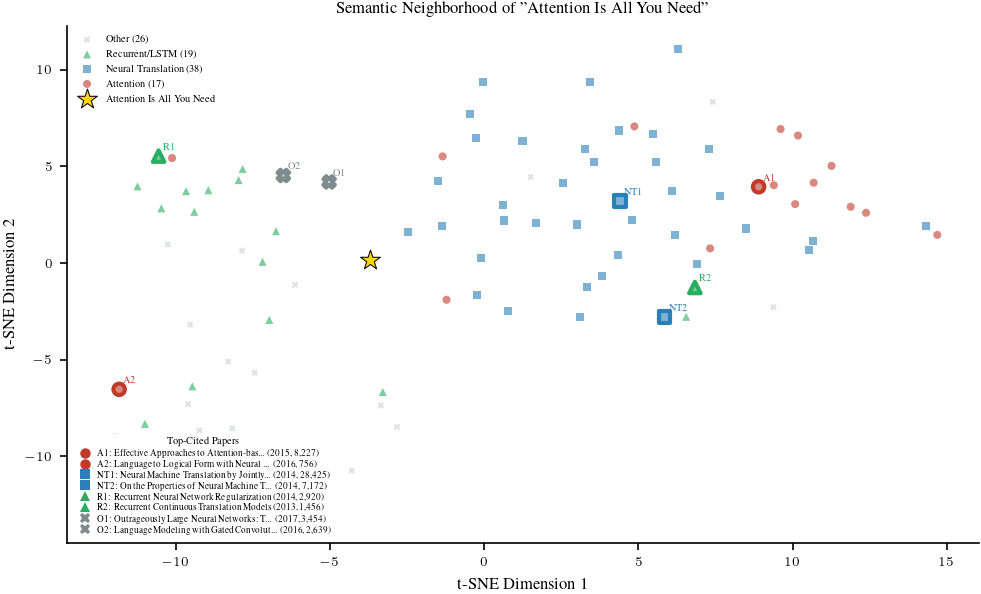

In [112]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import re
from tueplots import bundles
from matplotlib.lines import Line2D

# --------------------------------------------------
# Style
# --------------------------------------------------
plt.rcParams.update(bundles.icml2024(column="full", nrows=1, ncols=1))

# --------------------------------------------------
# Query + neighbors
# --------------------------------------------------
sample_query = '13756489'
query_data = ai_top_papers_merged[
    ai_top_papers_merged['query_id'] == str(sample_query)
].copy()

neighbors_data = (
    query_data.iloc[1:]
    .sort_values('cosine_distance')
    .reset_index(drop=True)
)

# --------------------------------------------------
# Categorization
# --------------------------------------------------
keyword_patterns = {
    'Attention': r'attention|self.attention|attend',
    'Neural Translation': r'neural.*(machine\s+)?translat|sequence.to.sequence|seq2seq|encoder.decoder',
    'Recurrent/LSTM': r'recurrent|lstm|gru|rnn',
}

def categorize_paper(title):
    if pd.isna(title):
        return 'Other'
    title = title.lower()
    for cat, pattern in keyword_patterns.items():
        if re.search(pattern, title):
            return cat
    return 'Other'

neighbors_data['category'] = neighbors_data['title'].apply(categorize_paper)

# --------------------------------------------------
# Visual encodings
# --------------------------------------------------
category_colors = {
    'Attention': '#c0392b',
    'Neural Translation': '#2980b9',
    'Recurrent/LSTM': '#27ae60',
    'Other': '#7f8c8d'
}

category_markers = {
    'Attention': 'o',
    'Neural Translation': 's',
    'Recurrent/LSTM': '^',
    'Other': 'X'
}

category_prefix = {
    'Attention': 'A',
    'Neural Translation': 'NT',
    'Recurrent/LSTM': 'R',
    'Other': 'O'
}

# --------------------------------------------------
# Figure
# --------------------------------------------------
fig, ax = plt.subplots(1, 1)

# --------------------------------------------------
# Plot all neighbors
# --------------------------------------------------
for cat in ['Other', 'Recurrent/LSTM', 'Neural Translation', 'Attention']:
    cat_data = neighbors_data[neighbors_data['category'] == cat]
    if cat_data.empty:
        continue

    if cat == 'Other':
        sizes = 10
        alpha = 0.25
        z = 1
    else:
        sizes = 15
        alpha = 0.6
        z = 2

    ax.scatter(
        cat_data['x'], cat_data['y'],
        s=sizes,
        c=category_colors[cat],
        marker=category_markers[cat],
        alpha=alpha,
        edgecolors='none',
        label=f'{cat} ({len(cat_data)})',
        zorder=z
    )

# --------------------------------------------------
# Query paper
# --------------------------------------------------
query_x = query_data['x'].iloc[0]
query_y = query_data['y'].iloc[0]

ax.scatter(
    query_x, query_y,
    c='gold',
    marker='*',
    s=100,
    edgecolors='black',
    linewidths=0.5,
    zorder=5,
    label='Attention Is All You Need'
)

# --------------------------------------------------
# Identify and label top-2 cited papers per category
# --------------------------------------------------
top_papers = []
for cat in ['Attention', 'Neural Translation', 'Recurrent/LSTM', 'Other']:
    subset = neighbors_data[neighbors_data['category'] == cat]
    if not subset.empty:
        top2 = subset.nlargest(2, 'citation_count')
        top_papers.append(top2)

top_papers = pd.concat(top_papers)

# Build legend entries and add text labels
def short_title(title, max_len=40):
    if len(title) <= max_len:
        return title
    return title[:max_len - 3] + '...'

top_legend_handles = []
top_legend_labels = []
category_counter = {cat: 0 for cat in category_prefix}

for cat in ['Attention', 'Neural Translation', 'Recurrent/LSTM', 'Other']:
    cat_papers = top_papers[top_papers['category'] == cat]
    for _, row in cat_papers.iterrows():
        category_counter[cat] += 1
        short_label = f"{category_prefix[cat]}{category_counter[cat]}"
        
        year = int(row['publication_year']) if pd.notna(row['publication_year']) else '?'
        cit = int(row['citation_count']) if pd.notna(row['citation_count']) else 0
        # Plot highlighted marker
        ax.scatter(
            row['x'], row['y'],
            s=30,
            facecolors='none',
            edgecolors=category_colors[cat],
            marker=category_markers[cat],
            linewidths=2.0,
            zorder=4
        )
        # Add small text label on plot
        ax.annotate(
            short_label,
            (row['x'], row['y']),
            fontsize=5,
            ha='left',
            va='bottom',
            xytext=(2, 2),
            textcoords='offset points',
            color=category_colors[cat]
        )

        # Legend entry with matching marker
        handle = Line2D(
            [0], [0],
            marker=category_markers[cat],
            color='none',
            markerfacecolor=category_colors[cat],
            markeredgecolor='none',
            markersize=5,
            linestyle='None'
        )

        label = f"{short_label}: {short_title(row['title'])} ({year}, {cit:,})"
        top_legend_handles.append(handle)
        top_legend_labels.append(label)

# --------------------------------------------------
# Styling
# --------------------------------------------------
ax.set_xlabel('t-SNE Dimension 1')
ax.set_ylabel('t-SNE Dimension 2')
ax.set_title('Semantic Neighborhood of "Attention Is All You Need"')

# Main legend (categories)
legend1 = ax.legend(
    loc='upper left',
    fontsize=5,
    framealpha=0.9,
    edgecolor='none',
    fancybox=False
)
ax.add_artist(legend1)

# Second legend (top cited)
ax.legend(
    handles=top_legend_handles,
    labels=top_legend_labels,
    loc='lower left',
    fontsize=4.5,
    framealpha=0.9,
    edgecolor='none',
    fancybox=False,
    title='Top-Cited Papers',
    title_fontsize=5,
    handletextpad=0.3,
    labelspacing=0.25
)

ax.tick_params(axis='both', labelsize=6)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.tight_layout()
plt.savefig('attention_novelty_markers_top_cited.pdf', bbox_inches='tight')
plt.show()

In [48]:
# Novelty Calculation Visualization
# Novelty = 1 - (avg cosine similarity of 100 nearest neighbors)
# This plot visually explains how novelty is computed from the neighborhood

sample_query = '13756489'
query_data = ai_top_papers_merged[ai_top_papers_merged['query_id'] == str(sample_query)].copy()

# Get neighbors sorted by cosine distance (closest first)
neighbors_data = query_data.iloc[1:].copy()
neighbors_data = neighbors_data.sort_values('cosine_distance').reset_index(drop=True)

# Calculate cosine similarity from distance: similarity = 1 - distance
neighbors_data['cosine_similarity'] = 1 - neighbors_data['cosine_distance']

# Calculate novelty components
avg_similarity = neighbors_data['cosine_similarity'].mean()
novelty_score = 1 - avg_similarity

fig = go.Figure()

# Color neighbors by their similarity (higher similarity = more similar = lower novelty contribution)
fig.add_trace(go.Scatter(
    x=neighbors_data['x'],
    y=neighbors_data['y'],
    mode='markers',
    name='100 Nearest Neighbors',
    marker=dict(
        size=14,
        color=neighbors_data['cosine_similarity'],
        colorscale='RdYlGn',  # Red=low similarity (novel), Green=high similarity (similar)
        reversescale=True,    # So green = similar, red = dissimilar
        showscale=True,
        colorbar=dict(
            title="Cosine<br>Similarity",
            thickness=15,
            len=0.5,
            x=1.02,
            y=0.75,
            tickformat='.2f'
        ),
        line=dict(width=1, color='white'),
        cmin=neighbors_data['cosine_similarity'].min(),
        cmax=neighbors_data['cosine_similarity'].max()
    ),
    hovertemplate=(
        '<b>Neighbor #%{customdata[0]}</b><br>'
        'Cosine Similarity: %{customdata[1]:.4f}<br>'
        'Cosine Distance: %{customdata[2]:.4f}<br>'
        '<extra></extra>'
    ),
    customdata=np.column_stack([
        np.arange(1, len(neighbors_data) + 1),
        neighbors_data['cosine_similarity'],
        neighbors_data['cosine_distance']
    ])
))

# Add query paper (center)
query_row = query_data.iloc[0]
fig.add_trace(go.Scatter(
    x=[query_data['x'].iloc[0]],
    y=[query_data['y'].iloc[0]],
    mode='markers',
    name='Query Paper',
    marker=dict(size=30, color='blue', symbol='star', 
                line=dict(width=3, color='darkblue')),
    hovertemplate=(
        f'<b>Query Paper</b><br>'
        f'Title: {query_row.get("title", "N/A")}<br>'
        f'Novelty Score: {novelty_score:.4f}<br>'
        '<extra></extra>'
    )
))

# Mark closest neighbor (highest similarity) with a special marker
closest_neighbor = neighbors_data.iloc[0]  # Already sorted by distance, first is closest
fig.add_trace(go.Scatter(
    x=[closest_neighbor['x']],
    y=[closest_neighbor['y']],
    mode='markers+text',
    name=f'Closest Neighbor (sim={closest_neighbor["cosine_similarity"]:.4f})',
    marker=dict(size=22, color='limegreen', symbol='diamond', 
                line=dict(width=3, color='darkgreen')),
    text=['CLOSEST'],
    textposition='top center',
    textfont=dict(size=10, color='darkgreen', family='Arial Black'),
    hovertemplate=(
        f'<b>CLOSEST NEIGHBOR</b><br>'
        f'Cosine Similarity: {closest_neighbor["cosine_similarity"]:.4f}<br>'
        f'Cosine Distance: {closest_neighbor["cosine_distance"]:.4f}<br>'
        '<extra></extra>'
    )
))

# Mark farthest neighbor (lowest similarity) with a special marker
farthest_neighbor = neighbors_data.iloc[-1]  # Last one is farthest
fig.add_trace(go.Scatter(
    x=[farthest_neighbor['x']],
    y=[farthest_neighbor['y']],
    mode='markers+text',
    name=f'Farthest Neighbor (sim={farthest_neighbor["cosine_similarity"]:.4f})',
    marker=dict(size=22, color='crimson', symbol='diamond', 
                line=dict(width=3, color='darkred')),
    text=['FARTHEST'],
    textposition='top center',
    textfont=dict(size=10, color='darkred', family='Arial Black'),
    hovertemplate=(
        f'<b>FARTHEST NEIGHBOR</b><br>'
        f'Cosine Similarity: {farthest_neighbor["cosine_similarity"]:.4f}<br>'
        f'Cosine Distance: {farthest_neighbor["cosine_distance"]:.4f}<br>'
        '<extra></extra>'
    )
))

# Add annotations explaining the novelty calculation
annotations = []

# Formula explanation (top center)
formula_text = (
    '<b>NOVELTY CALCULATION</b><br>'
    '━━━━━━━━━━━━━━━━━━━━━━━━<br>'
    f'<b>Novelty = 1 - Avg(Similarity)</b><br>'
    f'<br>'
    f'Avg Cosine Similarity = {avg_similarity:.4f}<br>'
    f'<b>Novelty Score = 1 - {avg_similarity:.4f}</b><br>'
    f'<b>Novelty Score = {novelty_score:.4f}</b>'
)
annotations.append(dict(
    x=0.5, y=1.15,
    xref='paper', yref='paper',
    text=formula_text,
    showarrow=False,
    align='center',
    bgcolor='rgba(230, 240, 255, 0.95)',
    bordercolor='steelblue',
    borderwidth=3,
    borderpad=12,
    font=dict(size=12, family='monospace')
))

# Neighbor statistics (left panel)
stats_text = (
    '<b>100 NEIGHBORS STATS</b><br>'
    '━━━━━━━━━━━━━━━━━━<br>'
    f'Min Similarity: {neighbors_data["cosine_similarity"].min():.4f}<br>'
    f'Max Similarity: {neighbors_data["cosine_similarity"].max():.4f}<br>'
    f'Avg Similarity: {avg_similarity:.4f}<br>'
    f'Std Similarity: {neighbors_data["cosine_similarity"].std():.4f}'
)
annotations.append(dict(
    x=0.02, y=0.98,
    xref='paper', yref='paper',
    text=stats_text,
    showarrow=False,
    align='left',
    bgcolor='rgba(255, 250, 230, 0.95)',
    bordercolor='goldenrod',
    borderwidth=2,
    borderpad=10,
    font=dict(size=10, family='monospace')
))

# Interpretation (right panel)
interp_high = "High similarity → Paper is SIMILAR to neighbors"
interp_low = "Low similarity → Paper is DIFFERENT from neighbors"
interpretation_text = (
    '<b>INTERPRETATION</b><br>'
    '━━━━━━━━━━━━━━━━━━<br>'
    f'<span style="color:green">■</span> Green = High similarity<br>'
    f'<span style="color:red">■</span> Red = Low similarity<br>'
    '<br>'
    'Higher novelty means the<br>'
    'paper is more DIFFERENT<br>'
    'from its nearest neighbors<br>'
    'in the embedding space.'
)
annotations.append(dict(
    x=0.98, y=0.98,
    xref='paper', yref='paper',
    text=interpretation_text,
    showarrow=False,
    align='left',
    bgcolor='rgba(240, 255, 240, 0.95)',
    bordercolor='forestgreen',
    borderwidth=2,
    borderpad=10,
    font=dict(size=10, family='monospace')
))

# Distribution summary (bottom)
# Create a mini histogram of similarities as text
sim_quartiles = neighbors_data['cosine_similarity'].quantile([0.25, 0.5, 0.75])
dist_text = (
    '<b>SIMILARITY DISTRIBUTION</b><br>'
    f'Q1 (25%): {sim_quartiles[0.25]:.4f}  |  '
    f'Median: {sim_quartiles[0.5]:.4f}  |  '
    f'Q3 (75%): {sim_quartiles[0.75]:.4f}'
)
annotations.append(dict(
    x=0.5, y=-0.08,
    xref='paper', yref='paper',
    text=dist_text,
    showarrow=False,
    align='center',
    bgcolor='rgba(245, 245, 245, 0.95)',
    bordercolor='gray',
    borderwidth=1,
    borderpad=8,
    font=dict(size=10, family='monospace')
))

fig.update_layout(
    title=dict(
        text=(
            f'<b>How Novelty is Calculated from 100 Nearest Neighbors</b><br>'
            f'<sub>Query Paper: {query_row.get("title", sample_query)[:60]}...</sub>'
        ),
        x=0.5,
        xanchor='center',
        y=0.92
    ),
    xaxis_title='t-SNE Dimension 1',
    yaxis_title='t-SNE Dimension 2',
    height=900,
    width=1000,
    hovermode='closest',
    annotations=annotations,
    showlegend=True,
    legend=dict(
        x=0.5, y=-0.15,
        xanchor='center',
        orientation='h',
        bgcolor='rgba(255,255,255,0.8)'
    ),
    margin=dict(l=60, r=80, t=180, b=120),
    plot_bgcolor='rgba(250, 250, 255, 1)'
)

# Add gridlines for better readability
fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='rgba(200,200,200,0.3)')
fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='rgba(200,200,200,0.3)')

fig.show()

print(f"\n{'='*60}")
print(f"NOVELTY CALCULATION SUMMARY")
print(f"{'='*60}")
print(f"Query Paper: {query_row.get('title', 'N/A')[:50]}...")
print(f"Number of neighbors: {len(neighbors_data)}")
print(f"Average Cosine Similarity: {avg_similarity:.4f}")
print(f"Novelty Score (1 - avg_similarity): {novelty_score:.4f}")
print(f"{'='*60}")


NOVELTY CALCULATION SUMMARY
Query Paper: Attention is All you Need...
Number of neighbors: 100
Average Cosine Similarity: 0.9427
Novelty Score (1 - avg_similarity): 0.0573


In [49]:
# Consolidated visualization: Multiple plots of 10 papers each, sorted by citation count
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# Get unique papers and sort by citation count
papers_by_citation = ai_top_papers_merged.groupby('query_id').agg({
    'citation_count': 'first'
}).reset_index()
papers_by_citation = papers_by_citation.sort_values('citation_count', ascending=False)
sorted_queries = papers_by_citation['query_id'].values

# Create multiple plots, 10 papers per plot in 2x5 grid
papers_per_plot = 12
n_cols = 4
n_rows = 3
total_papers = len(sorted_queries)

# Generate plots in batches of 10
for plot_idx in range(0, total_papers, papers_per_plot):
    # Select 10 papers for this plot
    selected_queries = sorted_queries[plot_idx:plot_idx + papers_per_plot]
    n_papers = len(selected_queries)
    
    if n_papers == 0:
        break
    
    # Create subplot titles with paper titles (truncated)
    subplot_titles = []
    for query_id in selected_queries:
        query_paper = ai_top_papers_merged[ai_top_papers_merged['query_id'] == query_id].iloc[0]
        title = query_paper.get('title', f'Q{query_id}')
        if pd.notna(title):
            title = str(title)[:45] + "..." if len(title) > 45 else str(title)
        elif pd.isna(title):
            title = f'Q{query_id}'
        # Add citation count to title
        cite_count = int(query_paper.get('citation_count', 0))
        subplot_titles.append(f"{title}<br><sub>Citations: {cite_count}</sub>")
    
    # Pad with empty titles if fewer than 10 papers
    while len(subplot_titles) < papers_per_plot:
        subplot_titles.append("")
    
    # Create subplots
    fig = make_subplots(
        rows=n_rows, cols=n_cols,
        subplot_titles=subplot_titles,
        horizontal_spacing=0.02,
        vertical_spacing=0.08,
        specs=[[{'type': 'scatter'}] * n_cols for _ in range(n_rows)]
    )
    
    # Color palette for citation heatmap
    cmap = plt.colormaps['viridis']
    
    for idx, query_id in enumerate(selected_queries):
        row = idx // n_cols + 1
        col = idx % n_cols + 1
        
        query_data = ai_top_papers_merged[ai_top_papers_merged['query_id'] == query_id].copy()
        
        if len(query_data) < 2:
            continue
        
        # Get query point and neighbors
        query_point = query_data.iloc[0][['x', 'y']].values
        neighbors_data = query_data.iloc[1:].copy()
        neighbors_data = neighbors_data.sort_values('cosine_distance')
        
        # Get citation counts for color mapping
        citation_counts = neighbors_data['citation_count'].fillna(0)
        
        # Normalize citations to [0, 1] for color mapping
        if citation_counts.max() > 0:
            norm_citations = (citation_counts - citation_counts.min()) / (citation_counts.max() - citation_counts.min() + 1e-10)
        else:
            norm_citations = np.zeros(len(citation_counts))
        
        # Map to viridis colormap
        colors_list = [mcolors.rgb2hex(cmap(val)) for val in norm_citations]
        
        # Prepare hover texts
        neighbor_hovers = []
        for _, neighbor_row in neighbors_data.iterrows():
            hover = f"<b>Neighbor</b><br>"
            if pd.notna(neighbor_row.get('title')):
                hover += f"{neighbor_row['title']}<br>"
            cite_val = neighbor_row.get('citation_count', 0)
            hover += f"Cites: {int(cite_val) if pd.notna(cite_val) else 0}<br>" 
            hover += f"Nov: {neighbor_row.get('novelty_mean', 0):.3f}<br>"
            hover += f"Dist: {neighbor_row['cosine_distance']:.3f}<br>"
            hover += f"Year: {int(neighbor_row.get('publication_year', 0)) if pd.notna(neighbor_row.get('publication_year', 0)) else 'N/A'}"
            neighbor_hovers.append(hover)
        
        # # Add connecting lines (with distance-based opacity)
        # max_dist = neighbors_data['cosine_distance'].max() if len(neighbors_data) > 0 else 1
        # for _, neighbor in neighbors_data.iterrows():
        #     opacity = max(0.1, 1 - (neighbor['cosine_distance'] / max_dist) * 0.8)
        #     fig.add_trace(
        #         go.Scatter(
        #             x=[query_point[0], neighbor['x']],
        #             y=[query_point[1], neighbor['y']],
        #             mode='lines',
        #             line=dict(color='lightgray', width=0.3),
        #             opacity=opacity,
        #             showlegend=False,
        #             hoverinfo='skip'
        #         ),
        #         row=row, col=col
        #     )
        
        # Add neighbor points (color-coded by citations)
        for i, (_, neighbor) in enumerate(neighbors_data.iterrows()):
            fig.add_trace(
                go.Scatter(
                    x=[neighbor['x']],
                    y=[neighbor['y']],
                    mode='markers',
                    marker=dict(
                        size=6,
                        color=colors_list[i],
                        line=dict(width=0.5, color='white')
                    ),
                    showlegend=False,
                    hovertext=neighbor_hovers[i],
                    hoverinfo='text'
                ),
                row=row, col=col
            )
        
        # Add query paper (red star)
        query_row = query_data.iloc[0]
        query_hover = f"<b>Query Paper</b><br>"
        if pd.notna(query_row.get('title')):
            query_hover += f"{query_row['title']}<br>"
        query_hover += f"Cites: {int(query_row.get('citation_count', 0))}<br>"
        query_hover += f"Nov: {query_row.get('novelty_mean', 0):.3f}"
        query_hover += f"<br>Year: {int(query_row.get('publication_year', 0)) if pd.notna(query_row.get('publication_year', 0)) else 'N/A'}"
        
        fig.add_trace(
            go.Scatter(
                x=[query_point[0]],
                y=[query_point[1]],
                mode='markers',
                marker=dict(
                    size=10,
                    color='red',
                    symbol='star',
                    line=dict(width=1, color='darkred')
                ),
                showlegend=False,
                hovertext=query_hover,
                hoverinfo='text'
            ),
            row=row, col=col
        )
        
        # Update axes
        fig.update_xaxes(showticklabels=False, showgrid=False, zeroline=False, row=row, col=col)
        fig.update_yaxes(showticklabels=False, showgrid=False, zeroline=False, row=row, col=col)
    
    # Add a dummy trace with colorbar for legend
    # Get min and max citations across all neighbors in this plot
    all_citations = []
    for query_id in selected_queries:
        query_data = ai_top_papers_merged[ai_top_papers_merged['query_id'] == query_id]
        if len(query_data) > 1:
            neighbor_cites = query_data.iloc[1:]['citation_count'].fillna(0)
            all_citations.extend(neighbor_cites.tolist())
    
    if len(all_citations) > 0:
        min_cite = min(all_citations)
        max_cite = max(all_citations)
        
        # Add invisible scatter trace for colorbar
        fig.add_trace(
            go.Scatter(
                x=[None],
                y=[None],
                mode='markers',
                marker=dict(
                    size=0.1,
                    color=[min_cite, max_cite],
                    colorscale='Viridis',
                    showscale=True,
                    colorbar=dict(
                        title="Neighbor<br>Citations",
                        thickness=15,
                        len=0.5,
                        x=1.02,
                        xanchor='left',
                        y=0.5,
                        yanchor='middle'
                    )
                ),
                showlegend=False,
                hoverinfo='skip'
            )
        )
    
    # Update overall layout
    start_rank = plot_idx + 1
    end_rank = min(plot_idx + papers_per_plot, total_papers)
    fig.update_layout(
        title=dict(
            text=f'Top AI Papers by Citations (Rank {start_rank}-{end_rank})',
            x=0.5,
            xanchor='center',
            font=dict(size=18)
        ),
        height=1000,
        width=1800,
        showlegend=False,
        hovermode='closest',
        plot_bgcolor='white',
        margin=dict(l=20, r=80, t=120, b=20)
    )
    
    fig.show()
    break
    print(f"\nShowing papers ranked {start_rank} to {end_rank} by citation count")